# Face Recognition

## Imports, utils, data loading and splitting

In [ ]:
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.neighbors import KNeighborsClassifier
from sklearn import metrics
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics.pairwise import pairwise_kernels
import random

SEED = 42
random.seed(SEED)
np.random.seed(SEED)

In [ ]:
# mount drive from google drive to colab 
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Generating data matrix and label vector

In [ ]:
IMG_LEN = 10304
dataset_path = "drive/MyDrive/ORL_dataset"
subjects_dir = np.array(os.listdir(dataset_path))
subjects_dir_sort = np.array([int(x[1:]) for x in subjects_dir]).argsort()
subjects_dir = subjects_dir[subjects_dir_sort]
data_matrix = np.empty(shape=[0, IMG_LEN + 1])  # 10304 img pixels + label
for s_dir in subjects_dir:
    subject_path = dataset_path + "/" + s_dir
    subject_photos = np.array(os.listdir(subject_path))
    subject_photos_sort = np.array([int(x[:-4]) for x in subject_photos]).argsort()
    subject_photos = subject_photos[subject_photos_sort]
    for s_photo in subject_photos:
        img = Image.open(f"{subject_path}/{s_photo}").convert(
            "L"
        )  # load image as grayscale
        img_arr = np.asarray(img)
        img_arr = img_arr.ravel()
        img_arr = np.append(img_arr, int(s_dir[1:]))  # add label
        data_matrix = np.vstack([data_matrix, img_arr])
data_matrix = data_matrix[
    data_matrix[:, IMG_LEN].argsort(kind="stable")
]  # sort by label
label_vector = data_matrix[:, IMG_LEN]
data_matrix = np.delete(data_matrix, IMG_LEN, 1)

### Splitting dataset into training and test sets (50:50) and (70:30) for bonus part

In [ ]:
training_data_matrix = data_matrix[::2]  # odd rows
training_label_vector = label_vector[::2]
testing_data_matrix = data_matrix[1::2]  # even rows
testing_label_vector = label_vector[1::2]

# bonus 70:30 split
bonus_training_data_matrix = np.empty(shape=[0, IMG_LEN])
bonus_training_label_vector = []
bonus_testing_data_matrix = np.empty(shape=[0, IMG_LEN])
bonus_testing_label_vector = []
i = 0
for s_dir in subjects_dir:
    bonus_training_data_matrix = np.vstack(
        [bonus_training_data_matrix, data_matrix[i : i + 7, :]]
    )
    bonus_training_label_vector = np.append(
        bonus_training_label_vector, label_vector[i : i + 7]
    )

    bonus_testing_data_matrix = np.vstack(
        [bonus_testing_data_matrix, data_matrix[i + 7 : i + 10, :]]
    )
    bonus_testing_label_vector = np.append(
        bonus_testing_label_vector, label_vector[i + 7 : i + 10]
    )

    i += 10

### KNN function

In [ ]:
def KNN(
    train_data,
    train_labels,
    test_data,
    test_labels,
    log_file=None,
    plot=True,
    confusion_matrix=False,
    test_data_unprojected=None,
    display_examples=0,
):
    fig_dpi = 80
    random.seed(SEED + train_data.shape[0])
    log_text = "===================="
    acc_arr = []
    f1_arr = []  # add a new array to store f1 scores
    nn = [1, 3, 5, 7]
    for k in nn:
        classifier = KNeighborsClassifier(n_neighbors=k)
        classifier.fit(train_data, train_labels)
        prediction = classifier.predict(test_data)
        acc = metrics.accuracy_score(test_labels, prediction)
        acc_arr.append(acc)
        # calculate f1 score for the current value of k
        precision, recall, f1, support = metrics.precision_recall_fscore_support(
            test_labels, prediction, average="weighted", zero_division=1
        )
        f1_arr.append(f1)
        tmp = f"* k: {k}, accuracy: {acc:.3f}, f1 score: {f1:.3f}"
        log_text += tmp + "\n"
        print(tmp)
        if confusion_matrix:
            cm = metrics.confusion_matrix(test_labels, prediction)
            plt.figure(figsize=(4, 2), dpi=fig_dpi)
            sns.set(font_scale=1)
            sns.heatmap(cm, annot=True, cmap="Blues", fmt="d")
            plt.xlabel("Predicted")
            plt.ylabel("Actual")
            plt.show()
            sns.reset_orig()
        success_list = []
        failure_list = []
        for j in range(len(prediction)):
            if (prediction[j]) != (test_labels[j]):
                failure_list.append(j)
                log_text += "- Failure! "
            else:
                success_list.append(j)
                log_text += "+ Success! "
            log_text += (
                "Picture #("
                + str(j + 1)
                + ") labelled ("
                + str(test_labels[j])
                + "), is classified as ("
                + str(prediction[j])
                + ").\n"
            )
        if display_examples:
            examples_counter = 1
            plt.figure(figsize=(5, 5), dpi=fig_dpi)
            while examples_counter <= display_examples:
                if len(success_list):
                    i = random.randrange(len(success_list))
                    success_list[i], success_list[-1] = (
                        success_list[-1],
                        success_list[i],
                    )
                    j = success_list.pop()
                    idx = examples_counter + 1 * (examples_counter - 1)
                    plt.subplot(2, 2, idx)
                    plt.title(
                        f'Success: {"face" if test_labels[j] else "non-face"}',
                        fontsize=8,
                    )
                    plt.imshow(test_data_unprojected[j].reshape(112, 92), cmap="gray")
                if len(failure_list):
                    i = random.randrange(len(failure_list))
                    failure_list[i], failure_list[-1] = (
                        failure_list[-1],
                        failure_list[i],
                    )
                    j = failure_list.pop()
                    idx = examples_counter + 1 * (examples_counter - 1) + 1
                    plt.subplot(2, 2, idx)
                    plt.title(
                        f'Failure: {"face labelled non-face" if test_labels[j] else "non-face labelled face"}',
                        fontsize=8,
                    )
                    plt.imshow(test_data_unprojected[j].reshape(112, 92), cmap="gray")
                examples_counter += 1
            plt.show()
    if log_file != None:
        with open(f"/content/drive/MyDrive/pattern/1/{log_file}", "w") as text_file:
            text_file.write(log_text)
    if plot:
        plt.figure(figsize=(5, 3), dpi=fig_dpi)
        plt.plot(nn, acc_arr)
        plt.plot(nn, f1_arr)  # add a plot for f1 scores
        plt.xticks(nn)
        plt.legend(["Accuracy", "F1 score"])
        plt.show()
    return acc_arr, f1_arr

Used sklearn's KNN classifier, default tie breaking policy depends on the order of the data, if there is more than one such value, only the first is returned.

## PCA classification

computing the training matrix eigenvalues and eigenvectors

In [ ]:
mean_vector = np.mean(training_data_matrix, axis=0)
z = training_data_matrix - mean_vector
COV = np.cov(
    z.transpose(), bias=True
)  # bias=True to normalize using 1/n instead of 1/(n-1)
eigenvalues, eigenvectors = np.linalg.eigh(COV)

computing the centered testing matrix

In [ ]:
test_mean_vector = np.mean(testing_data_matrix, axis=0)
test_z = testing_data_matrix - test_mean_vector

calculating needed eigenvectors for each alpha

In [ ]:
alphas = [0.8, 0.85, 0.9, 0.95]
counts = []
total = sum(eigenvalues)
descending_eigenvalues = np.flip(eigenvalues)
for alpha in alphas:
    count = 0
    current = 0
    for ev in descending_eigenvalues:
        count += 1
        current += ev
        a = current / total
        if a >= alpha:
            counts.append(count)
            break
print(counts)

[36, 51, 76, 115]


Projecting the data and running knn, reporting the accuracy

alpha: 0.800
* k: 1, accuracy: 0.950, f1 score: 0.947
* k: 3, accuracy: 0.895, f1 score: 0.886
* k: 5, accuracy: 0.840, f1 score: 0.822
* k: 7, accuracy: 0.800, f1 score: 0.775


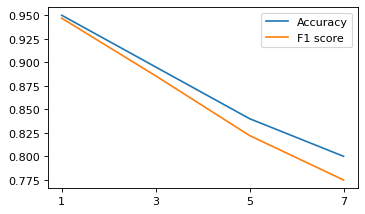

alpha: 0.850
* k: 1, accuracy: 0.950, f1 score: 0.947
* k: 3, accuracy: 0.895, f1 score: 0.885
* k: 5, accuracy: 0.845, f1 score: 0.828
* k: 7, accuracy: 0.780, f1 score: 0.749


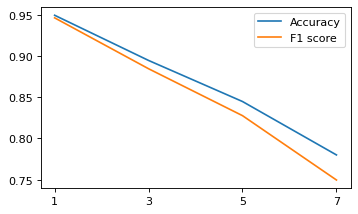

alpha: 0.900
* k: 1, accuracy: 0.935, f1 score: 0.933
* k: 3, accuracy: 0.895, f1 score: 0.886
* k: 5, accuracy: 0.845, f1 score: 0.831
* k: 7, accuracy: 0.755, f1 score: 0.726


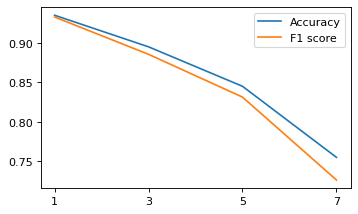

alpha: 0.950
* k: 1, accuracy: 0.940, f1 score: 0.937
* k: 3, accuracy: 0.895, f1 score: 0.885
* k: 5, accuracy: 0.840, f1 score: 0.825
* k: 7, accuracy: 0.740, f1 score: 0.712


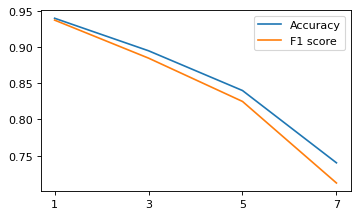

In [ ]:
best_acc = []
best_f1 = []
for i in range(len(alphas)):
    print(f"alpha: {alphas[i]:.3f}")
    projection_eigenvectors = eigenvectors[:, IMG_LEN - counts[i] :]
    projected_training_data_matrix = z.dot(projection_eigenvectors)
    projected_testing_data_matrix = test_z.dot(projection_eigenvectors)
    acc, f1 = KNN(
        projected_training_data_matrix,
        training_label_vector,
        projected_testing_data_matrix,
        testing_label_vector,
    )
    best_idx = np.argmax(acc)
    best_acc.append(acc[best_idx])
    best_f1.append(f1[best_idx])

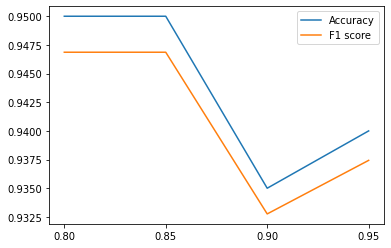

In [ ]:
plt.figure()
plt.plot(alphas, best_acc)
plt.plot(alphas, best_f1)
plt.xticks(alphas)
plt.legend(["Accuracy", "F1 score"])
plt.show()

### Comment

* There appearst to be a slight decrease in classification accuracy as alpha increases, perhaps the added eigenvectors don't add useful information to tell the faces apart, but rather act as noise.

* Accuracy decreases as number of 
neighbors increase, this may be attributed to the limited sample size of each class (5).

## LDA classification

In [ ]:
# calculate mean for all 40 classes
mean_vectors = []
for i in range(40):
    mean_vectors.append(np.mean(training_data_matrix[i * 5 : (i + 1) * 5], axis=0))
# get mean of all classes
overall_mean = np.mean(training_data_matrix, axis=0)

# calculate Sb
Sb = np.zeros((IMG_LEN, IMG_LEN))
for i in range(40):
    Sb += 5 * np.dot(
        (mean_vectors[i] - overall_mean).reshape(IMG_LEN, 1),
        (mean_vectors[i] - overall_mean).reshape(1, IMG_LEN),
    )

In [ ]:
within = np.zeros((IMG_LEN, IMG_LEN))
center = np.zeros((40, 5, IMG_LEN))

# computing centered matrix
for i in range(40):
    center[i] = training_data_matrix[i * 5 : (i + 1) * 5] - mean_vectors[i]
# computing within-class scatter matrix
for i in range(40):
    within += np.dot(center[i].T, center[i])
# S=Winv.B
# calculate the eigen vectors from S to get the weights
within = np.asarray(within)
inverse = np.linalg.inv(within)
s_inv_b = np.dot(inverse, Sb)

In [ ]:
eigenvalues_LDA, eigenvectors_LDA = np.linalg.eigh(s_inv_b)
projection_matrix_LDA = eigenvectors_LDA[:, len(eigenvectors_LDA) - 39 :]
# projecting train and test datasets
U_Train_LDA = np.dot(training_data_matrix, projection_matrix_LDA)
U_Test_LDA = np.dot(testing_data_matrix, projection_matrix_LDA)

* k: 1, accuracy: 0.950, f1 score: 0.945
* k: 3, accuracy: 0.865, f1 score: 0.849
* k: 5, accuracy: 0.810, f1 score: 0.794
* k: 7, accuracy: 0.770, f1 score: 0.741


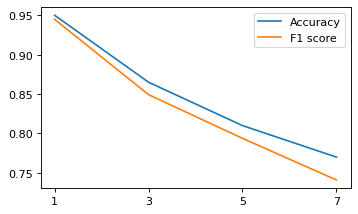

([0.95, 0.865, 0.81, 0.77],
 [0.9448737373737373,
  0.8492560217560217,
  0.7937987012987011,
  0.7409713203463204])

In [ ]:
KNN(U_Train_LDA, training_label_vector, U_Test_LDA, testing_label_vector)

### Comment
* Similar accuracies for LDA and PCA.

* Accuracy decreases as number of 
neighbors increase, this may be attributed to the limited sample size of each class (5).

## Bonus part 1: 70:30 split

### PCA

computing the training matrix eigenvalues and eigenvectors

In [ ]:
bonus_mean_vector = np.mean(bonus_training_data_matrix, axis=0)
bonus_z = bonus_training_data_matrix - bonus_mean_vector
bonus_COV = np.cov(
    bonus_z.transpose(), bias=True
)  # bias=True to normalize using 1/n instead of 1/(n-1)
bonus_eigenvalues, bonus_eigenvectors = np.linalg.eigh(bonus_COV)

computing the centered testing matrix

In [ ]:
bonus_test_mean_vector = np.mean(bonus_testing_data_matrix, axis=0)
bonus_test_z = bonus_testing_data_matrix - bonus_test_mean_vector

calculating needed eigenvectors for each alpha

In [ ]:
alphas = [0.8, 0.85, 0.9, 0.95]
bonus_counts = []
bonus_total = sum(bonus_eigenvalues)
bonus_descending_eigenvalues = np.flip(bonus_eigenvalues)
for alpha in alphas:
    count = 0
    current = 0
    for ev in bonus_descending_eigenvalues:
        count += 1
        current += ev
        a = current / bonus_total
        if a >= alpha:
            bonus_counts.append(count)
            break
print(bonus_counts)

[39, 57, 89, 145]


Projecting the data and running knn, reporting the accuracy

alpha: 0.800
* k: 1, accuracy: 0.958, f1 score: 0.956
* k: 3, accuracy: 0.917, f1 score: 0.912
* k: 5, accuracy: 0.900, f1 score: 0.895
* k: 7, accuracy: 0.858, f1 score: 0.853


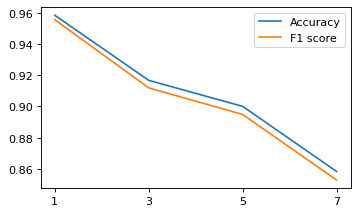

alpha: 0.850
* k: 1, accuracy: 0.958, f1 score: 0.956
* k: 3, accuracy: 0.933, f1 score: 0.930
* k: 5, accuracy: 0.892, f1 score: 0.887
* k: 7, accuracy: 0.850, f1 score: 0.846


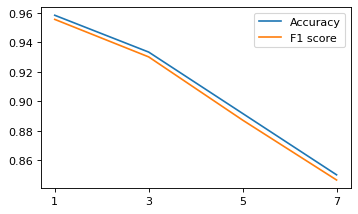

alpha: 0.900
* k: 1, accuracy: 0.950, f1 score: 0.947
* k: 3, accuracy: 0.933, f1 score: 0.930
* k: 5, accuracy: 0.875, f1 score: 0.870
* k: 7, accuracy: 0.817, f1 score: 0.807


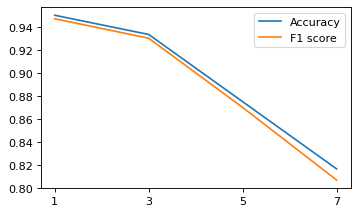

alpha: 0.950
* k: 1, accuracy: 0.942, f1 score: 0.938
* k: 3, accuracy: 0.925, f1 score: 0.920
* k: 5, accuracy: 0.867, f1 score: 0.862
* k: 7, accuracy: 0.783, f1 score: 0.770


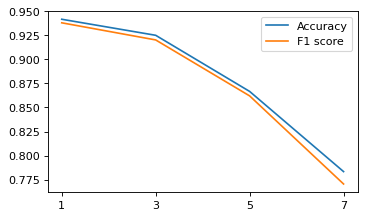

In [ ]:
best_bonus_acc = []
best_bonus_f1 = []
for i in range(len(alphas)):
    bonus_acc = []
    bonus_f1 = []
    print(f"alpha: {alphas[i]:.3f}")
    bonus_projection_eigenvectors = bonus_eigenvectors[:, IMG_LEN - bonus_counts[i] :]
    bonus_projected_training_data_matrix = bonus_z.dot(bonus_projection_eigenvectors)
    bonus_projected_testing_data_matrix = bonus_test_z.dot(
        bonus_projection_eigenvectors
    )
    bonus_acc, bonus_f1 = KNN(
        bonus_projected_training_data_matrix,
        bonus_training_label_vector,
        bonus_projected_testing_data_matrix,
        bonus_testing_label_vector,
    )
    best_bonus_idx = np.argmax(bonus_acc)
    best_bonus_acc.append(bonus_acc[best_bonus_idx])
    best_bonus_f1.append(bonus_f1[best_bonus_idx])

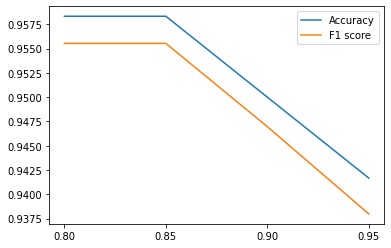

In [ ]:
plt.figure()
plt.plot(alphas, best_bonus_acc)
plt.plot(alphas, best_bonus_f1)
plt.xticks(alphas)
plt.legend(["Accuracy", "F1 score"])
plt.show()

#### Comment
* On average, the 50:50 split slightly worse accuracies with a maximum of 0.95 compared to 70:30's maximum of 0.958.

* There appearst to be a slight decrease in classification accuracy as alpha increases, perhaps the added eigenvectors don't add useful information to tell the faces apart, but rather act as noise.

### LDA

In [ ]:
# calculate mean for all 40 classes
mean_vectors = []
for i in range(40):
    mean_vectors.append(
        np.mean(bonus_training_data_matrix[i * 5 : (i + 1) * 5], axis=0)
    )
# get mean of all classes
overall_mean = np.mean(bonus_training_data_matrix, axis=0)

# calculate Sb
Sb = np.zeros((IMG_LEN, IMG_LEN))
for i in range(40):
    Sb += 5 * np.dot(
        (mean_vectors[i] - overall_mean).reshape(IMG_LEN, 1),
        (mean_vectors[i] - overall_mean).reshape(1, IMG_LEN),
    )

In [ ]:
within = np.zeros((IMG_LEN, IMG_LEN))
center = np.zeros((40, 5, IMG_LEN))

# computing centered matrix
for i in range(40):
    center[i] = bonus_training_data_matrix[i * 5 : (i + 1) * 5] - mean_vectors[i]
# computing within-class scatter matrix
for i in range(40):
    within += np.dot(center[i].T, center[i])
# S=Winv.B
# calculate the eigen vectors from S to get the weights
within = np.asarray(within)
inverse = np.linalg.inv(within)
s_inv_b = np.dot(inverse, Sb)

In [ ]:
eigenvalues_LDA_bonus, eigenvectors_LDA_bonus = np.linalg.eigh(s_inv_b)
projection_matrix_LDA_bonus = eigenvectors_LDA_bonus[
    :, len(eigenvectors_LDA_bonus) - 39 :
]
# projecting train and test datasets
U_Train_LDA_bonus = np.dot(bonus_training_data_matrix, projection_matrix_LDA_bonus)
U_Test_LDA_bonus = np.dot(bonus_testing_data_matrix, projection_matrix_LDA_bonus)

* k: 1, accuracy: 0.933, f1 score: 0.933
* k: 3, accuracy: 0.925, f1 score: 0.922
* k: 5, accuracy: 0.850, f1 score: 0.846
* k: 7, accuracy: 0.792, f1 score: 0.789


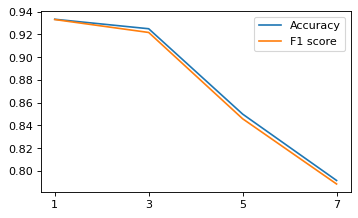

([0.9333333333333333, 0.925, 0.85, 0.7916666666666666],
 [0.9330952380952381,
  0.9217261904761905,
  0.8458928571428572,
  0.7885714285714286])

In [ ]:
KNN(
    U_Train_LDA_bonus,
    bonus_training_label_vector,
    U_Test_LDA_bonus,
    bonus_testing_label_vector,
)

#### Comment

* On average, the 50:50 split gave better accuracies with a maximum of 0.95 compared to 70:30's maximum of 0.933

## Compare vs Non-Faces

### Loading Non-Faces data

In [ ]:
# load motorbike directory
# download from here https://drive.google.com/drive/folders/16AC_Uwf6mtVd0fvLxEG1snRrnzi52Oyc?usp=sharing
motorbike = []
dataset_motorbike = "drive/MyDrive/motorbike"
motorbike_dir = np.array(os.listdir(dataset_motorbike))
motorbike_dir_sort = np.array([int(x[-8:-4]) for x in motorbike_dir]).argsort()
motorbike_dir = motorbike_dir[motorbike_dir_sort]
data_matrix_faces_motorbike = np.empty(shape=[0, IMG_LEN + 1])
# load motorbike images and resize them to 92x112 pixels then turn it to grayscale then resize it to 10304 pixels
for motorbike_photo in motorbike_dir:
    img_path = f"{dataset_motorbike}/{motorbike_photo}"
    img = Image.open(img_path).convert("L")  # load image as grayscale
    img = img.resize((92,112))
    img_arr = np.asarray(img)
    img_arr = img_arr.ravel()
    img_arr = np.append(img_arr, 0)  # add label, 0 for non-face
    data_matrix_faces_motorbike = np.vstack([data_matrix_faces_motorbike, img_arr])
label_vector_faces_motorbike = data_matrix_faces_motorbike[:, IMG_LEN]
data_matrix_faces_motorbike = np.delete(data_matrix_faces_motorbike, IMG_LEN, 1)

In [ ]:
print(data_matrix_faces_motorbike.shape)

(600, 10304)


### Splitting training and testing data

In [ ]:
sizes = [50, 100, 150, 200, 250, 300, 350]
training_data_matrices = []
training_label_vectors = []
testing_label_vectors = []
for s in sizes:
    training_data_matrices.append(
        np.vstack((data_matrix_faces_motorbike[0:s], training_data_matrix))
    )
    training_label_vectors.append(
        np.append(label_vector_faces_motorbike[0:s], np.ones(200))
    )
testing_data_matrix_f_m = np.vstack(
    (data_matrix_faces_motorbike[-200:], testing_data_matrix)
)
testing_label_vector_f_m = np.append(label_vector_faces_motorbike[-200:], np.ones(200))

### LDA

In [ ]:
def calculate_LDA(sizes, start_idx, end_idx):
    eigenvectors_LDA_f_m_arr = []
    for i in range(start_idx, end_idx + 1):
        s = sizes[i]
        print(f"Non-faces: {s}, faces: 200")
        non_faces_mean = np.mean(training_data_matrices[i][0:s], axis=0)
        faces_mean = np.mean(training_data_matrices[i][s : s + 200], axis=0)
        mean_diff = (non_faces_mean - faces_mean).reshape(IMG_LEN, 1)

        B = mean_diff.dot(mean_diff.transpose())

        non_faces_centered = training_data_matrices[i][0:s] - non_faces_mean
        non_faces_s = non_faces_centered.transpose().dot(non_faces_centered)

        faces_centered = training_data_matrices[i][s : s + 200] - faces_mean
        faces_s = faces_centered.transpose().dot(faces_centered)

        S = non_faces_s + faces_s

        s_inv = np.linalg.inv(S)

        prod = s_inv.dot(B)

        _, eigenvectors_LDA_f_m = np.linalg.eigh(prod)
        eigenvectors_LDA_f_m_arr.append(eigenvectors_LDA_f_m)
    return eigenvectors_LDA_f_m_arr

In [ ]:
def use_LDA(
    sizes,
    eigenvectors_LDA_f_m_arr,
    start_idx,
    end_idx,
    examples=0,
    dominant=[1, 2, 5, 15],
):
    acc_best = []
    f1_best = []
    for i in range(start_idx, end_idx + 1):
        acc_scores = []
        f1_scores = []
        s = sizes[i]
        print(f"Non-faces: {s}, faces: 200")
        for j in range(len(dominant)):
            projection_matrix_LDA_f_m = eigenvectors_LDA_f_m_arr[i - start_idx][
                :, len(eigenvectors_LDA_f_m_arr[i - start_idx]) - dominant[j] :
            ]
            U_Train_LDA_f_m = np.dot(
                training_data_matrices[i], projection_matrix_LDA_f_m
            )
            U_Test_LDA_f_m = np.dot(testing_data_matrix_f_m, projection_matrix_LDA_f_m)

            print(f"Dominant: {dominant[j]}")
            acc, f1 = KNN(
                U_Train_LDA_f_m,
                training_label_vectors[i],
                U_Test_LDA_f_m,
                testing_label_vector_f_m,
                log_file=f"LDA_{s}_non_faces_{dominant[j]}.txt",
                confusion_matrix=True,
                test_data_unprojected=testing_data_matrix_f_m,
                display_examples=examples,
            )
            best_idx = np.argmax(acc)
            acc_scores.append(acc[best_idx])
            f1_scores.append(f1[best_idx])
        best_idx = np.argmax(acc_scores)
        acc_best.append(acc_scores[best_idx])
        f1_best.append(f1_scores[best_idx])
    return acc_best, f1_best

In [ ]:
acc_best=[]
f1_best=[]

#### [50, 100, 150] non-faces, [200] faces

In [ ]:
eigenvectors_LDA_f_m_arr = calculate_LDA(sizes, 0, 2)

Non-faces: 50, faces: 200
Non-faces: 100, faces: 200
Non-faces: 150, faces: 200


Non-faces: 50, faces: 200
Dominant: 1
* k: 1, accuracy: 0.900, f1 score: 0.899


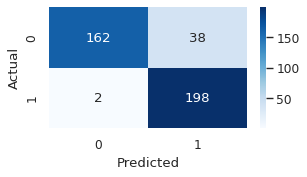

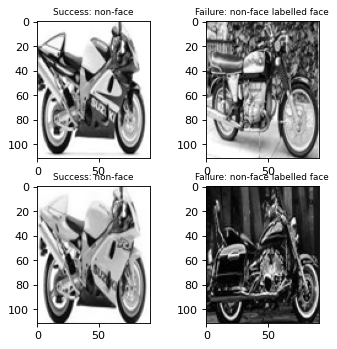

* k: 3, accuracy: 0.892, f1 score: 0.891


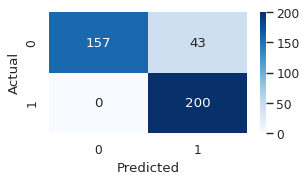

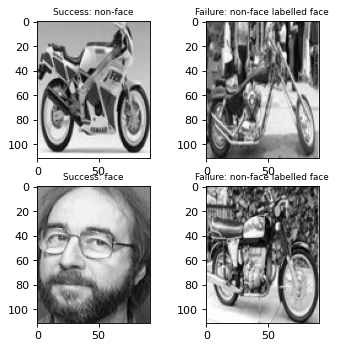

* k: 5, accuracy: 0.885, f1 score: 0.883


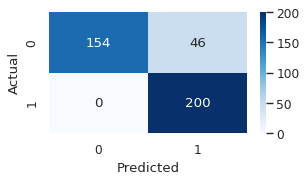

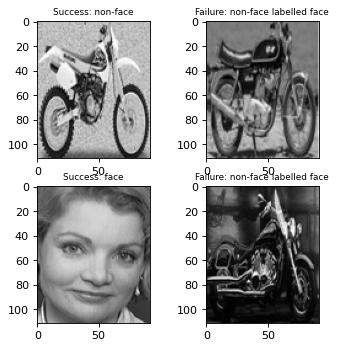

* k: 7, accuracy: 0.882, f1 score: 0.881


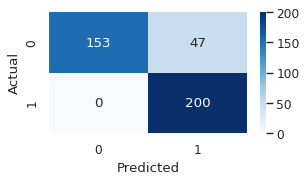

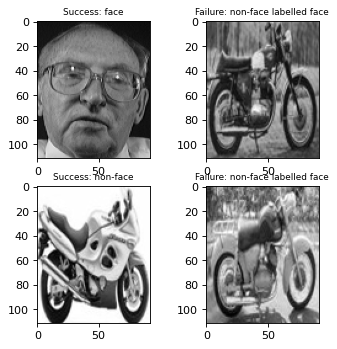

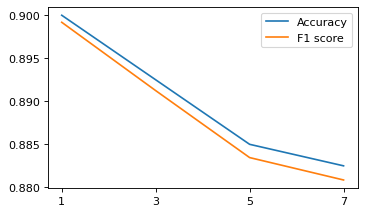

Dominant: 2
* k: 1, accuracy: 0.938, f1 score: 0.937


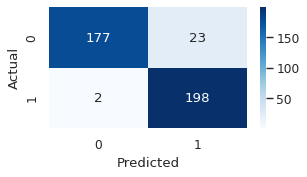

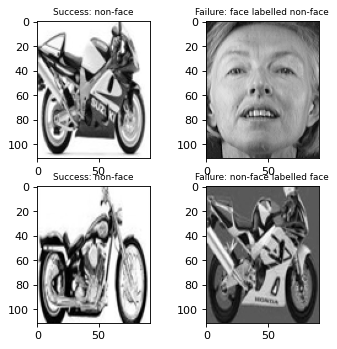

* k: 3, accuracy: 0.917, f1 score: 0.917


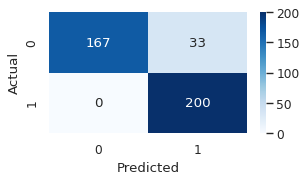

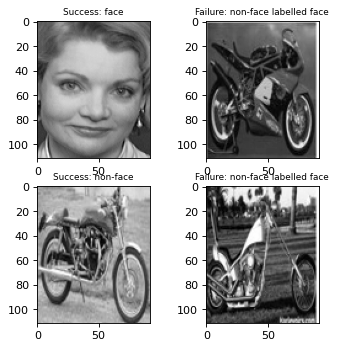

* k: 5, accuracy: 0.887, f1 score: 0.886


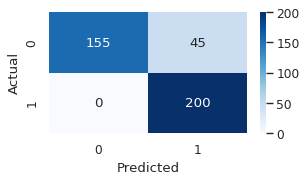

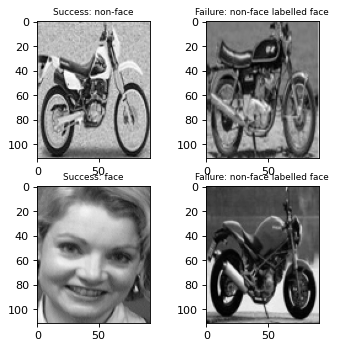

* k: 7, accuracy: 0.880, f1 score: 0.878


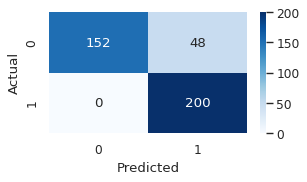

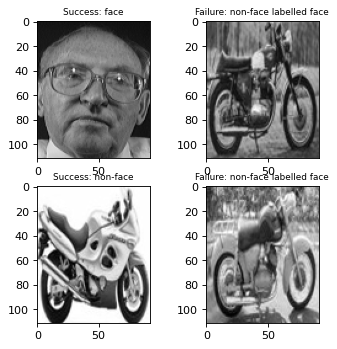

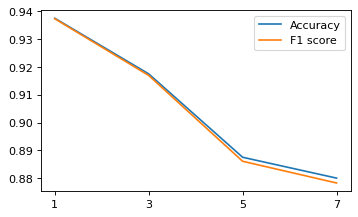

Dominant: 5
* k: 1, accuracy: 0.927, f1 score: 0.927


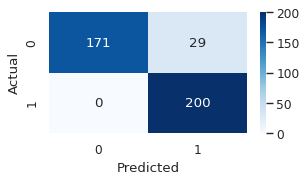

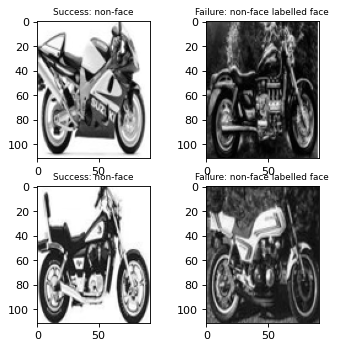

* k: 3, accuracy: 0.902, f1 score: 0.902


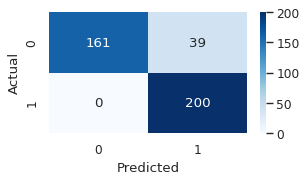

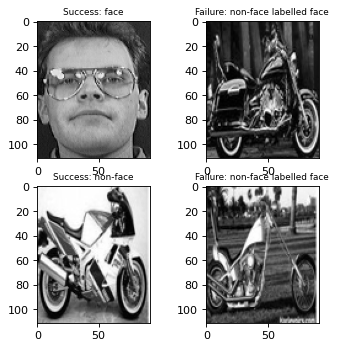

* k: 5, accuracy: 0.885, f1 score: 0.883


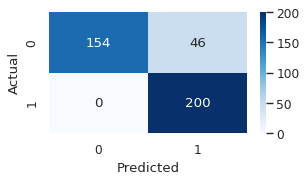

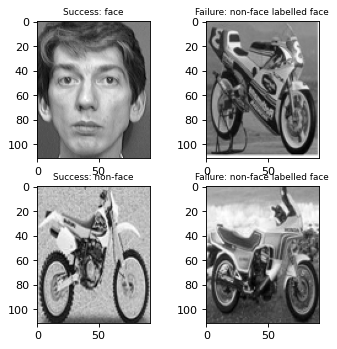

* k: 7, accuracy: 0.877, f1 score: 0.876


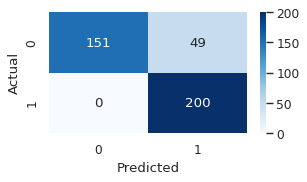

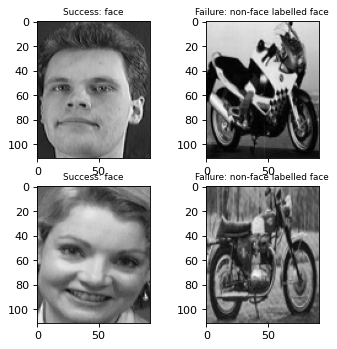

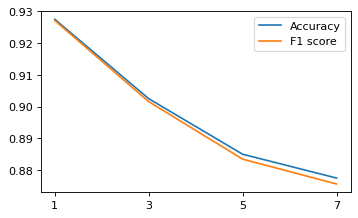

Dominant: 15
* k: 1, accuracy: 0.925, f1 score: 0.925


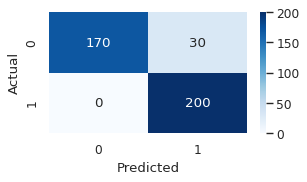

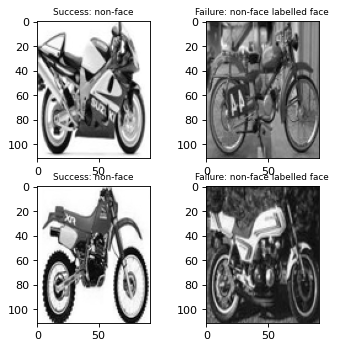

* k: 3, accuracy: 0.897, f1 score: 0.896


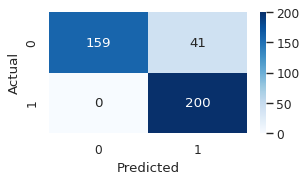

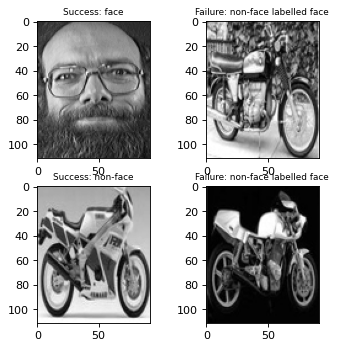

* k: 5, accuracy: 0.885, f1 score: 0.883


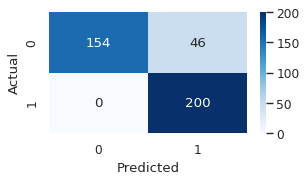

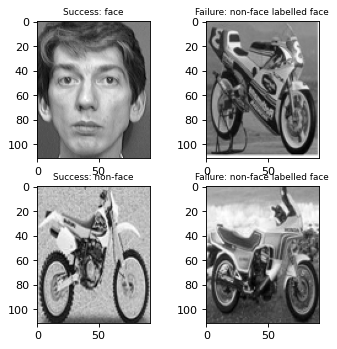

* k: 7, accuracy: 0.877, f1 score: 0.876


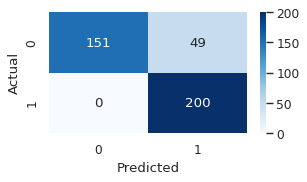

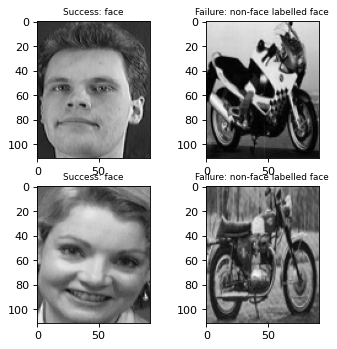

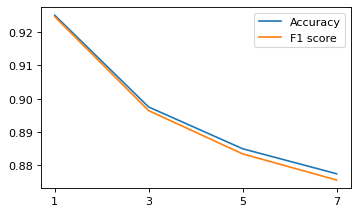

Non-faces: 100, faces: 200
Dominant: 1
* k: 1, accuracy: 0.853, f1 score: 0.852


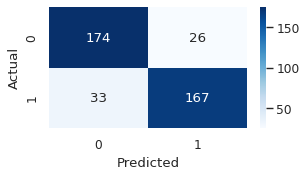

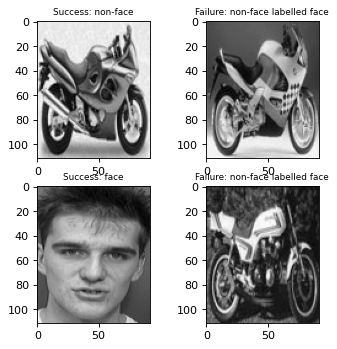

* k: 3, accuracy: 0.905, f1 score: 0.905


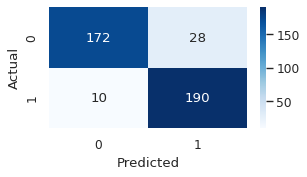

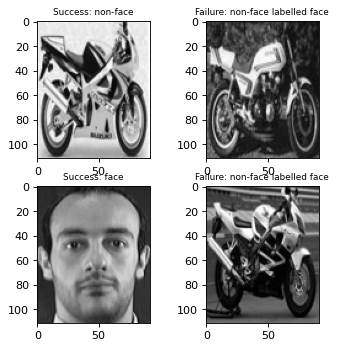

* k: 5, accuracy: 0.890, f1 score: 0.890


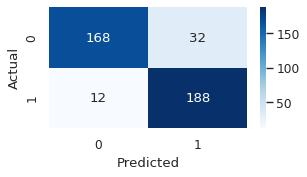

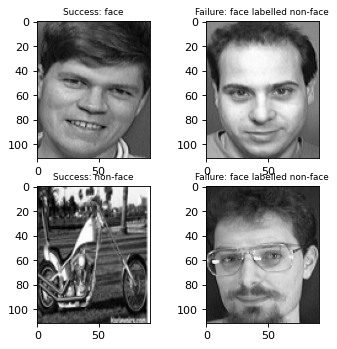

* k: 7, accuracy: 0.905, f1 score: 0.905


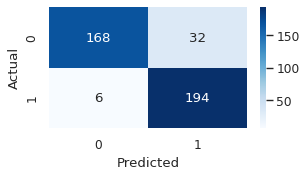

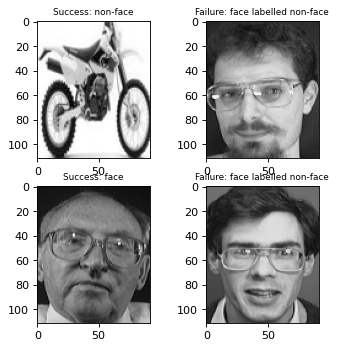

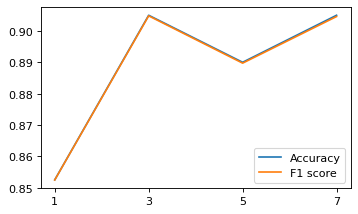

Dominant: 2
* k: 1, accuracy: 0.980, f1 score: 0.980


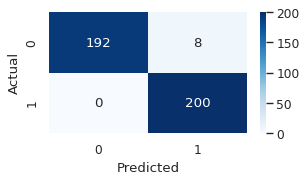

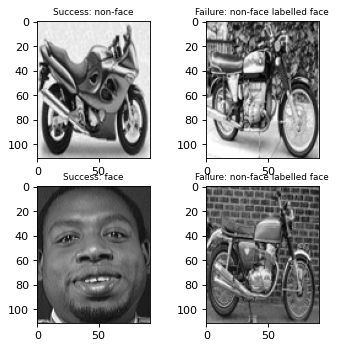

* k: 3, accuracy: 0.978, f1 score: 0.977


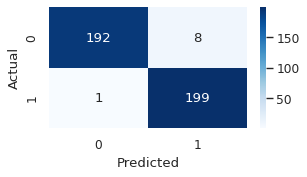

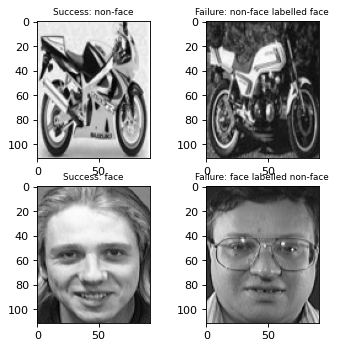

* k: 5, accuracy: 0.978, f1 score: 0.977


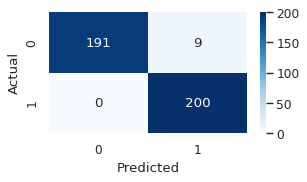

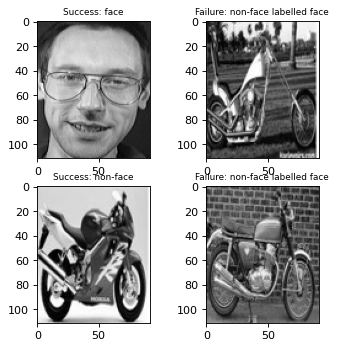

* k: 7, accuracy: 0.978, f1 score: 0.977


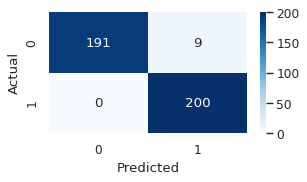

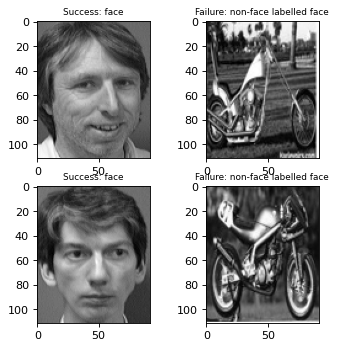

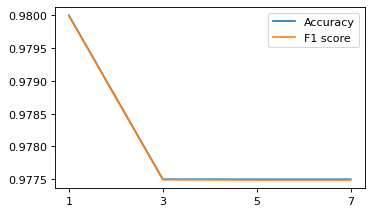

Dominant: 5
* k: 1, accuracy: 0.978, f1 score: 0.977


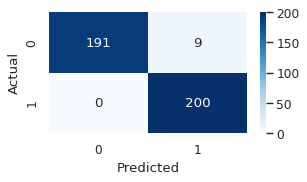

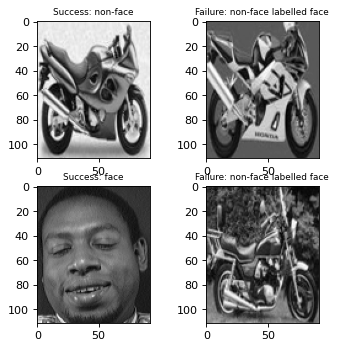

* k: 3, accuracy: 0.973, f1 score: 0.972


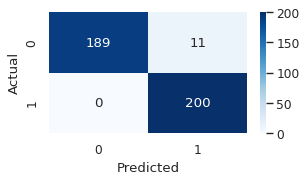

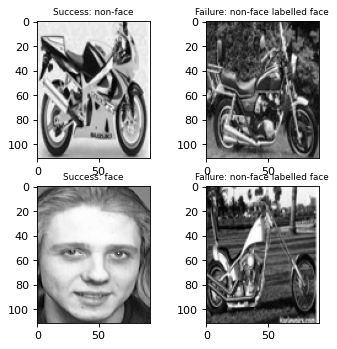

* k: 5, accuracy: 0.975, f1 score: 0.975


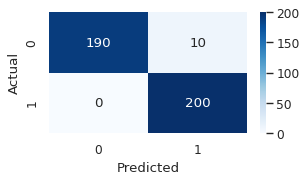

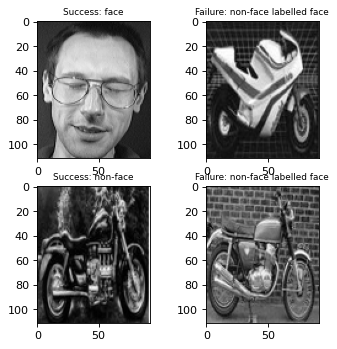

* k: 7, accuracy: 0.973, f1 score: 0.972


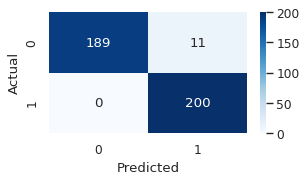

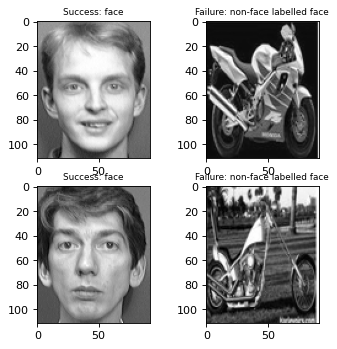

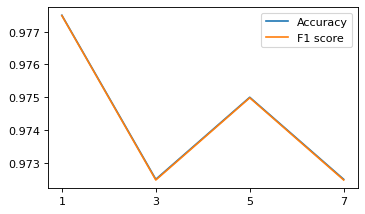

Dominant: 15
* k: 1, accuracy: 0.978, f1 score: 0.977


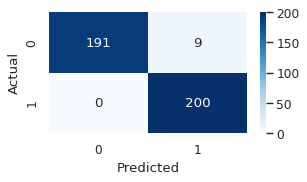

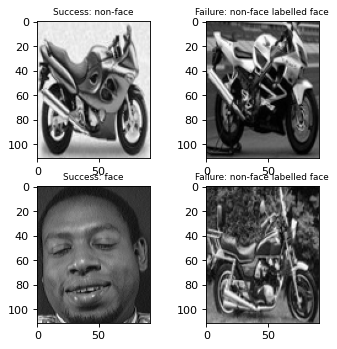

* k: 3, accuracy: 0.970, f1 score: 0.970


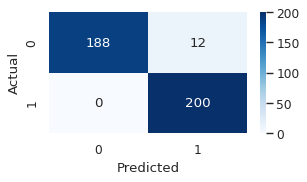

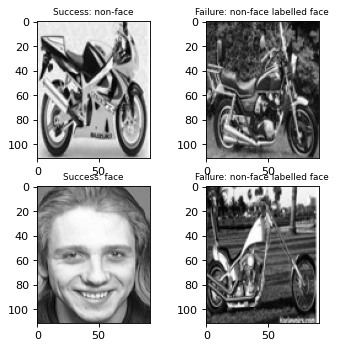

* k: 5, accuracy: 0.975, f1 score: 0.975


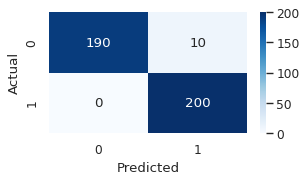

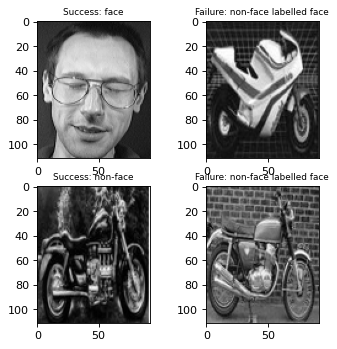

* k: 7, accuracy: 0.973, f1 score: 0.972


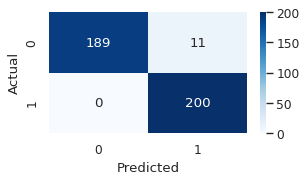

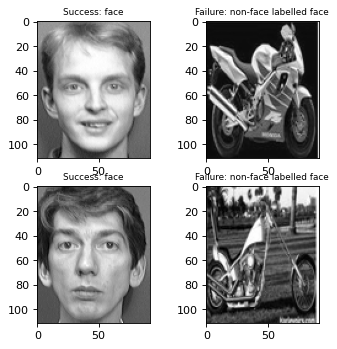

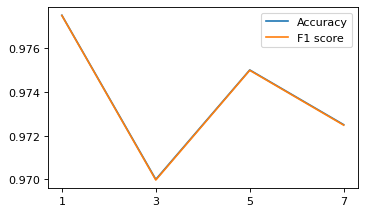

Non-faces: 150, faces: 200
Dominant: 1
* k: 1, accuracy: 0.897, f1 score: 0.897


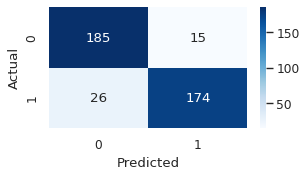

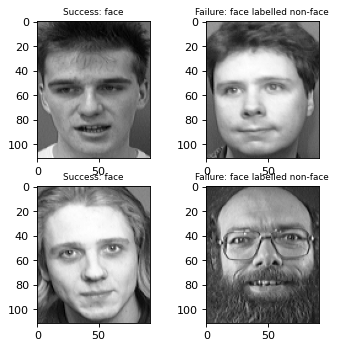

* k: 3, accuracy: 0.935, f1 score: 0.935


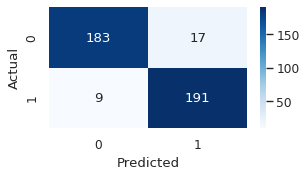

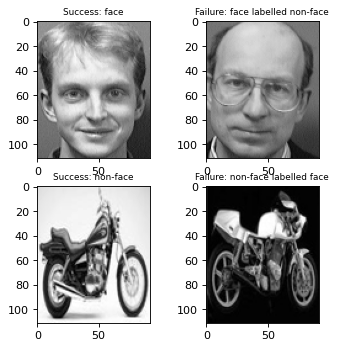

* k: 5, accuracy: 0.953, f1 score: 0.952


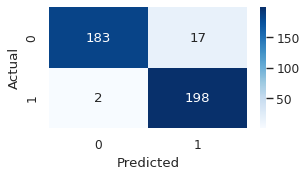

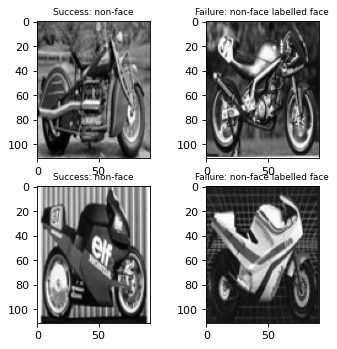

* k: 7, accuracy: 0.955, f1 score: 0.955


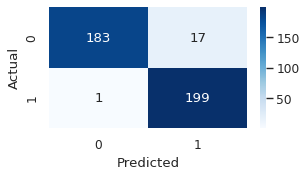

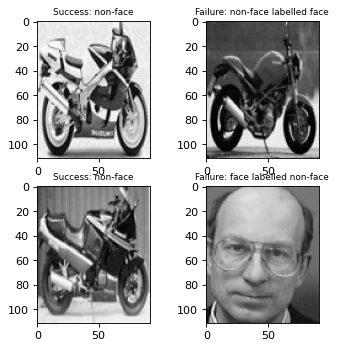

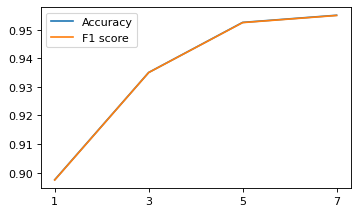

Dominant: 2
* k: 1, accuracy: 0.983, f1 score: 0.982


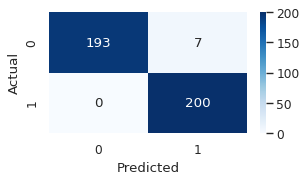

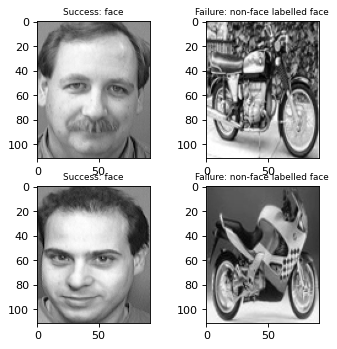

* k: 3, accuracy: 0.983, f1 score: 0.982


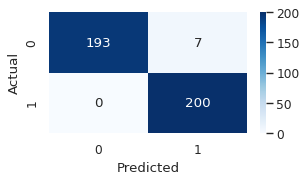

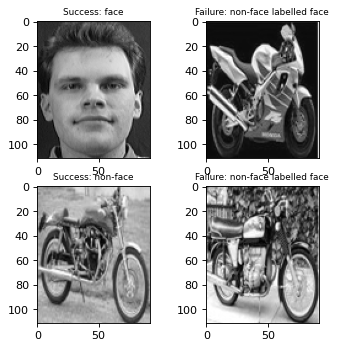

* k: 5, accuracy: 0.983, f1 score: 0.982


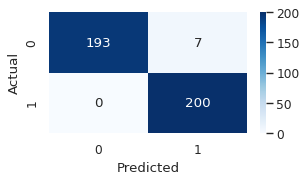

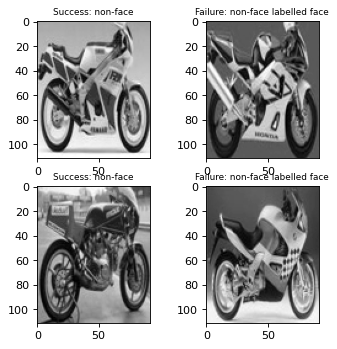

* k: 7, accuracy: 0.980, f1 score: 0.980


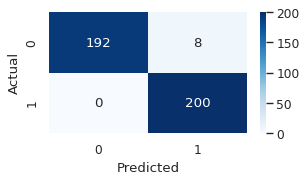

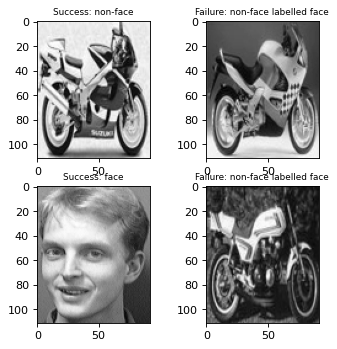

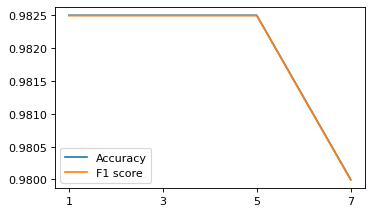

Dominant: 5
* k: 1, accuracy: 0.985, f1 score: 0.985


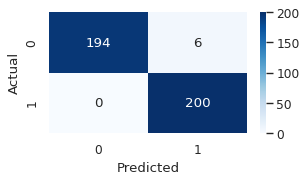

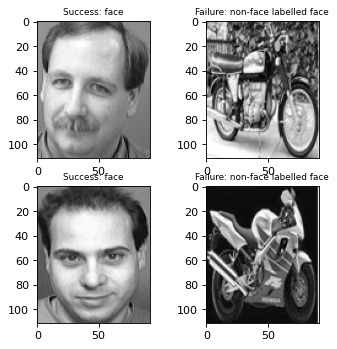

* k: 3, accuracy: 0.983, f1 score: 0.982


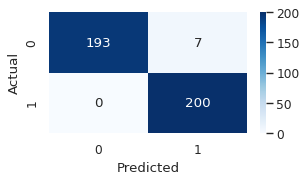

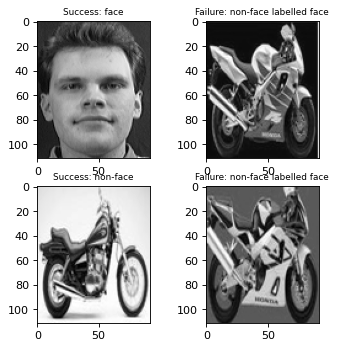

* k: 5, accuracy: 0.985, f1 score: 0.985


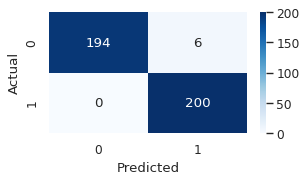

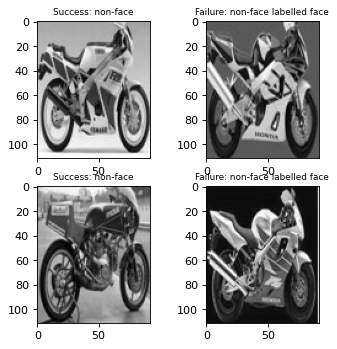

* k: 7, accuracy: 0.985, f1 score: 0.985


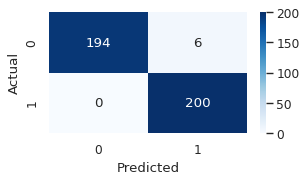

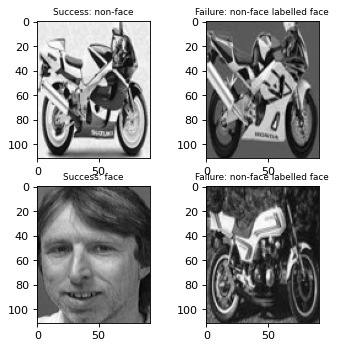

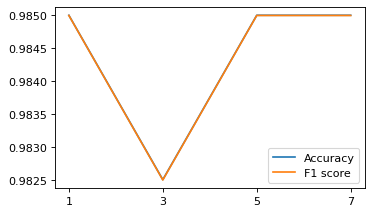

Dominant: 15
* k: 1, accuracy: 0.988, f1 score: 0.987


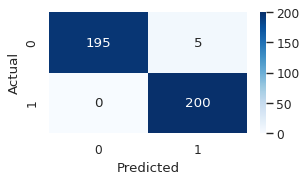

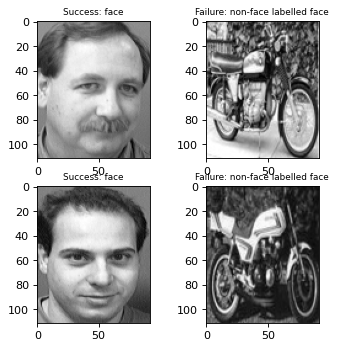

* k: 3, accuracy: 0.983, f1 score: 0.982


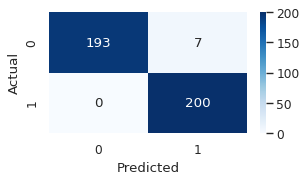

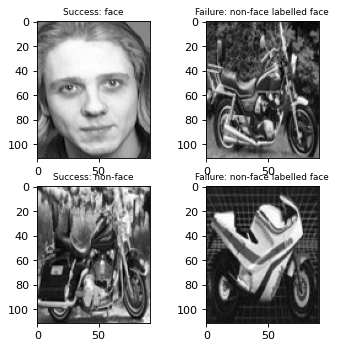

* k: 5, accuracy: 0.980, f1 score: 0.980


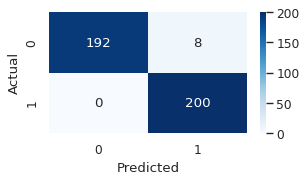

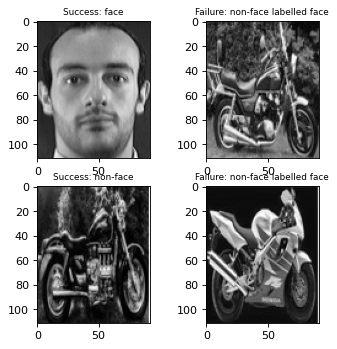

* k: 7, accuracy: 0.978, f1 score: 0.977


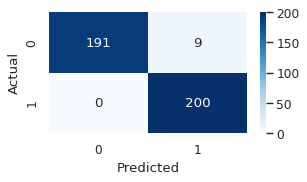

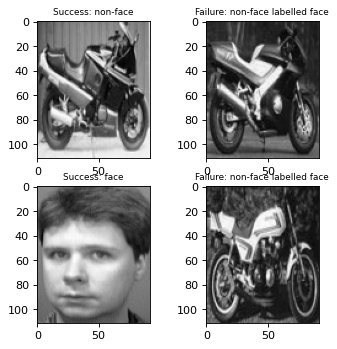

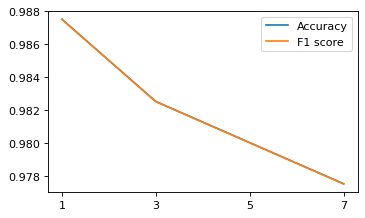

In [ ]:
acc_best_partial, f1_best_partial = use_LDA(
    sizes, eigenvectors_LDA_f_m_arr, 0, 2, examples=2
)
acc_best += acc_best_partial
f1_best += f1_best_partial

In [ ]:
print(acc_best)
print(f1_best)

[0.9375, 0.98, 0.9875]
[0.9373272582555668, 0.9799919967987194, 0.9874980465697766]


#### [200, 250] non-faces, [200] faces

In [ ]:
acc_best = [0.9375, 0.98, 0.9875]
f1_best = [0.9373272582555668, 0.9799919967987194, 0.9874980465697766]

In [ ]:
eigenvectors_LDA_f_m_arr = calculate_LDA(sizes, 3, 4)

Non-faces: 200, faces: 200
Non-faces: 250, faces: 200


Non-faces: 200, faces: 200
Dominant: 1
* k: 1, accuracy: 0.890, f1 score: 0.890


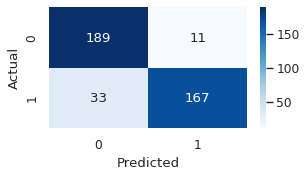

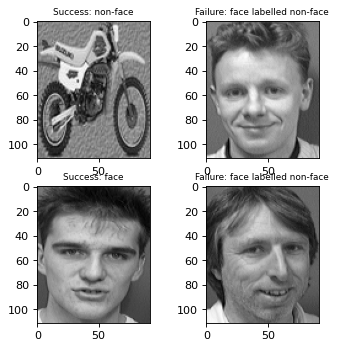

* k: 3, accuracy: 0.907, f1 score: 0.907


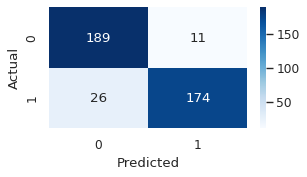

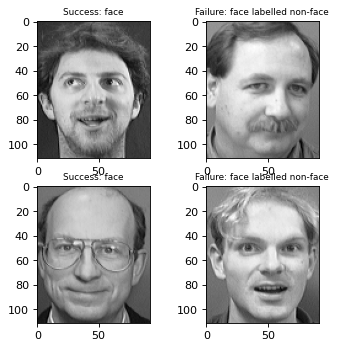

* k: 5, accuracy: 0.932, f1 score: 0.932


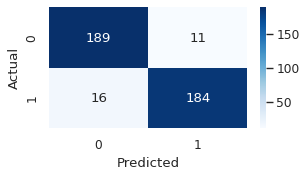

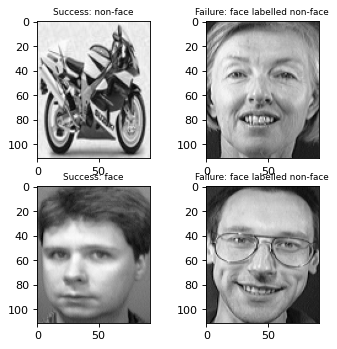

* k: 7, accuracy: 0.935, f1 score: 0.935


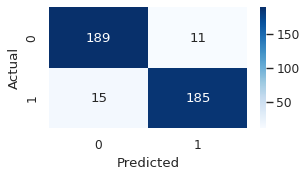

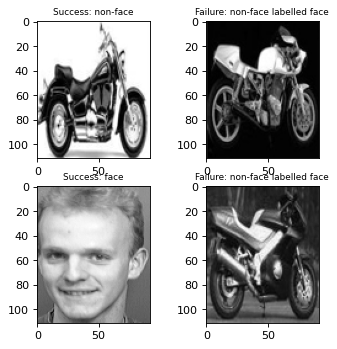

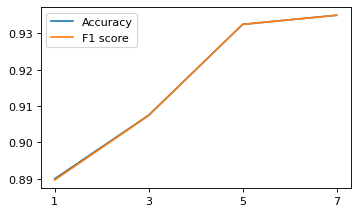

Dominant: 2
* k: 1, accuracy: 0.978, f1 score: 0.977


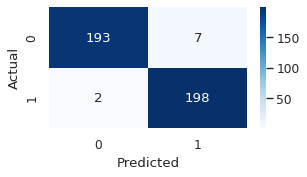

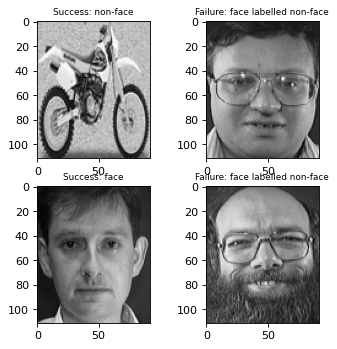

* k: 3, accuracy: 0.983, f1 score: 0.982


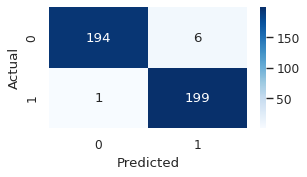

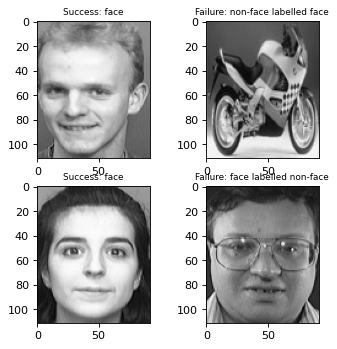

* k: 5, accuracy: 0.983, f1 score: 0.982


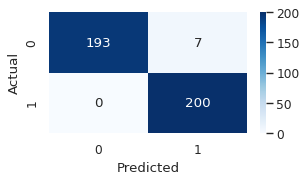

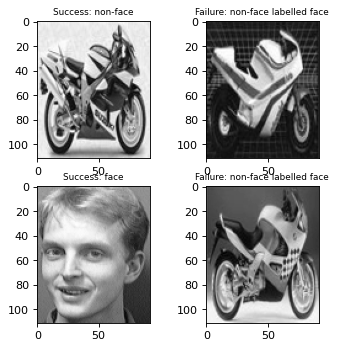

* k: 7, accuracy: 0.983, f1 score: 0.982


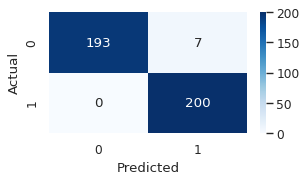

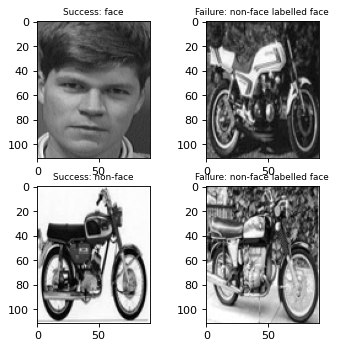

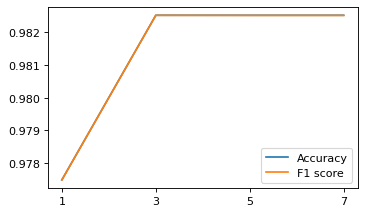

Dominant: 5
* k: 1, accuracy: 0.990, f1 score: 0.990


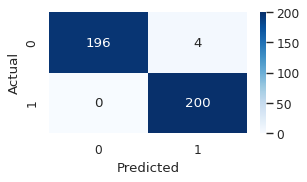

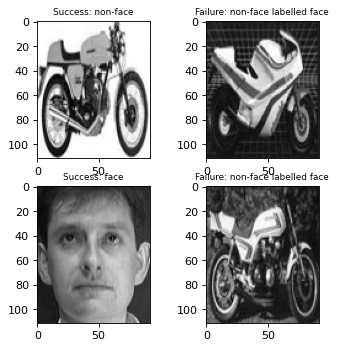

* k: 3, accuracy: 0.988, f1 score: 0.987


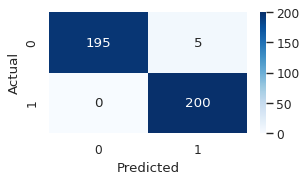

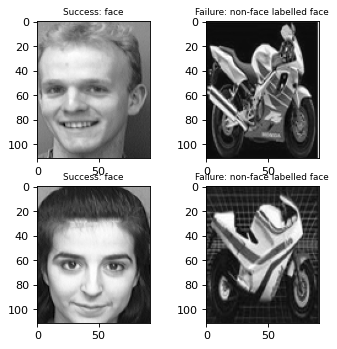

* k: 5, accuracy: 0.988, f1 score: 0.987


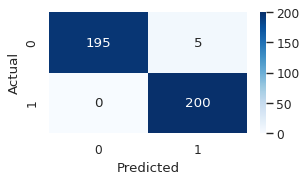

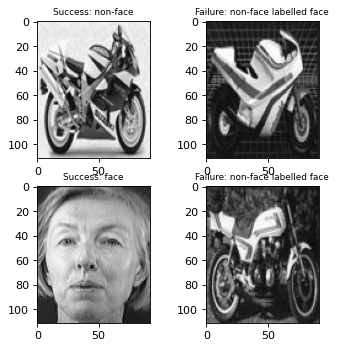

* k: 7, accuracy: 0.990, f1 score: 0.990


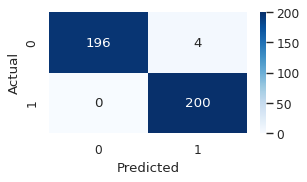

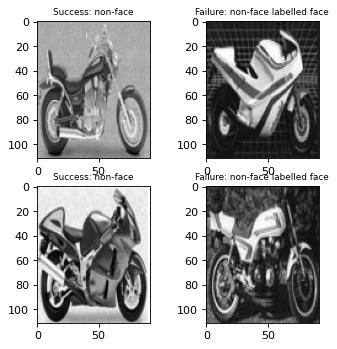

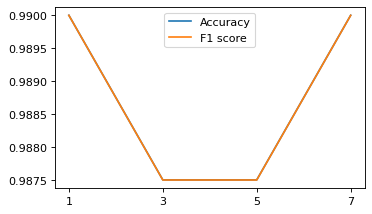

Dominant: 15
* k: 1, accuracy: 0.993, f1 score: 0.992


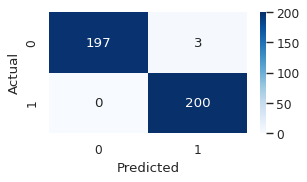

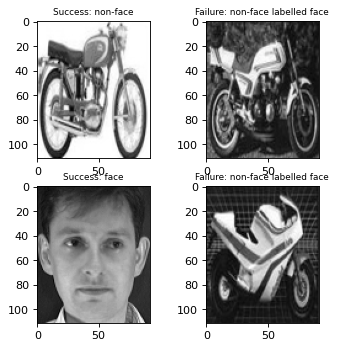

* k: 3, accuracy: 0.988, f1 score: 0.987


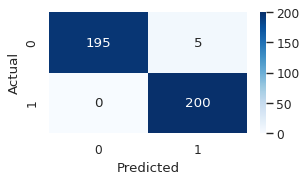

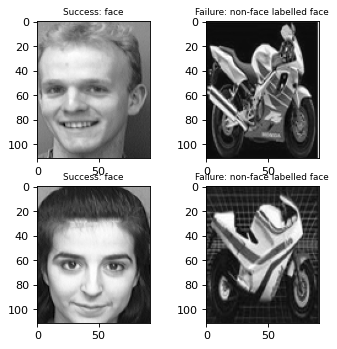

* k: 5, accuracy: 0.988, f1 score: 0.987


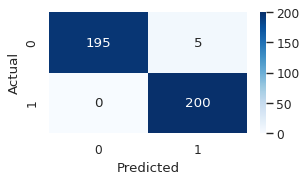

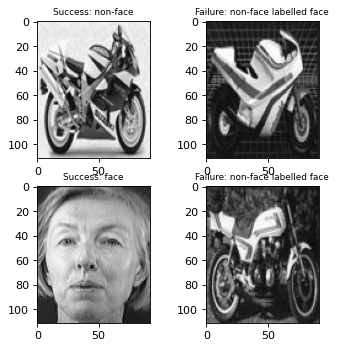

* k: 7, accuracy: 0.990, f1 score: 0.990


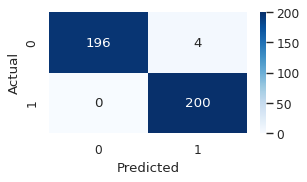

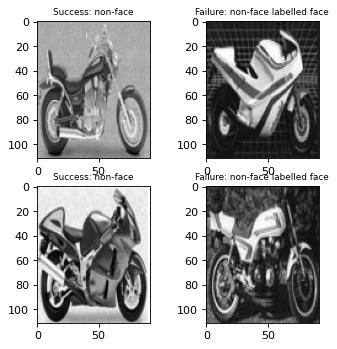

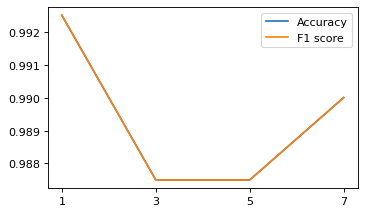

Non-faces: 250, faces: 200
Dominant: 1
* k: 1, accuracy: 0.890, f1 score: 0.890


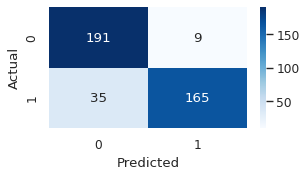

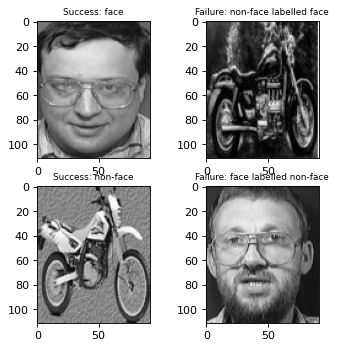

* k: 3, accuracy: 0.895, f1 score: 0.895


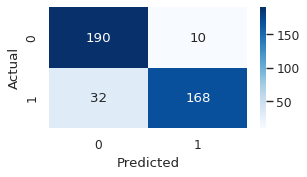

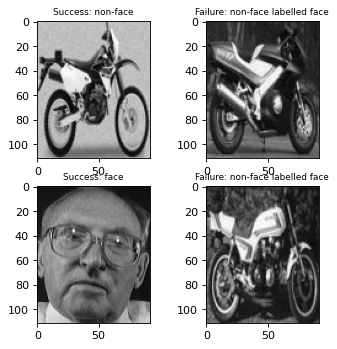

* k: 5, accuracy: 0.920, f1 score: 0.920


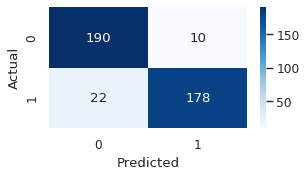

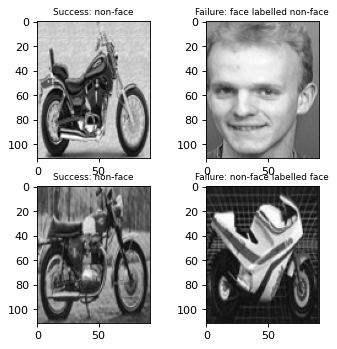

* k: 7, accuracy: 0.932, f1 score: 0.932


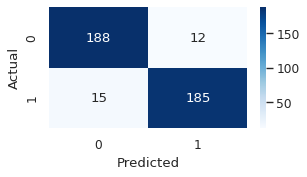

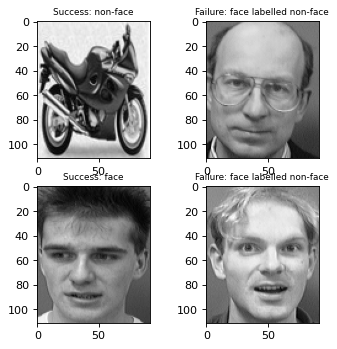

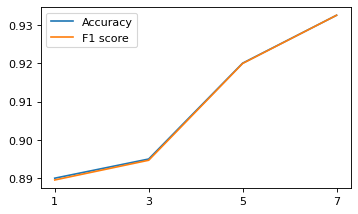

Dominant: 2
* k: 1, accuracy: 0.985, f1 score: 0.985


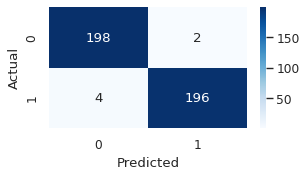

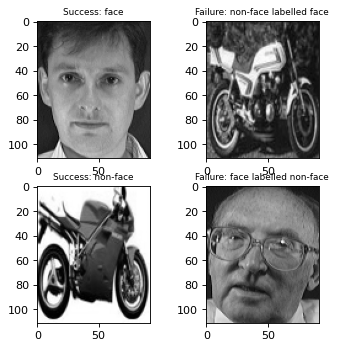

* k: 3, accuracy: 0.983, f1 score: 0.982


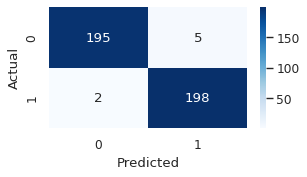

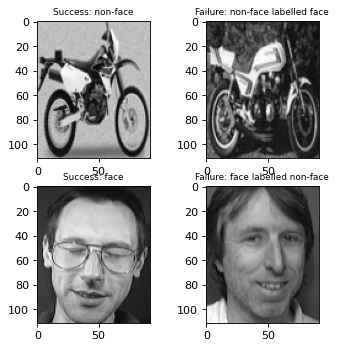

* k: 5, accuracy: 0.985, f1 score: 0.985


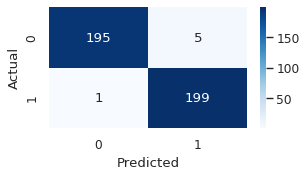

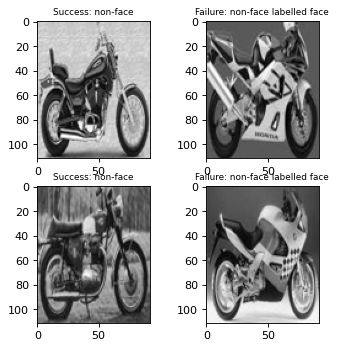

* k: 7, accuracy: 0.983, f1 score: 0.982


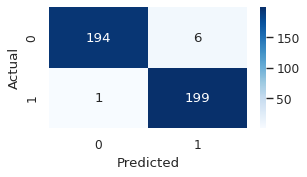

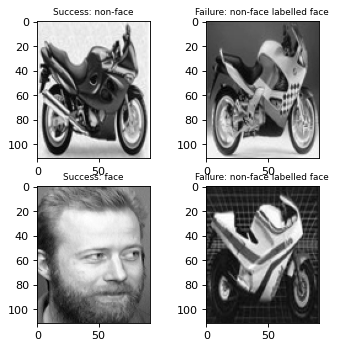

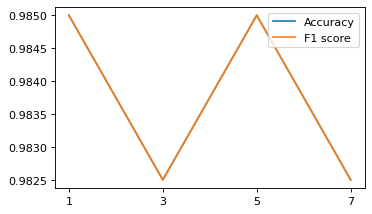

Dominant: 5
* k: 1, accuracy: 0.988, f1 score: 0.987


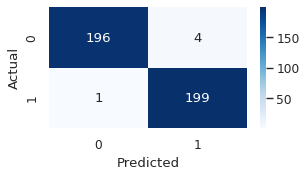

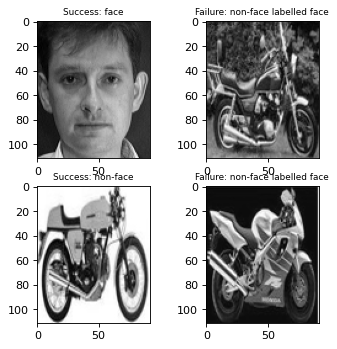

* k: 3, accuracy: 0.990, f1 score: 0.990


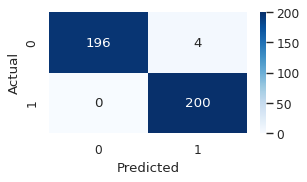

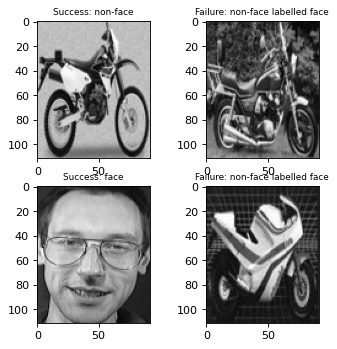

* k: 5, accuracy: 0.985, f1 score: 0.985


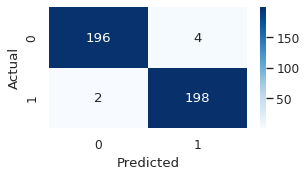

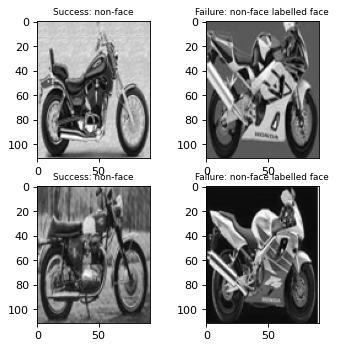

* k: 7, accuracy: 0.990, f1 score: 0.990


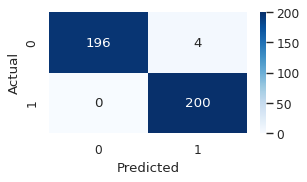

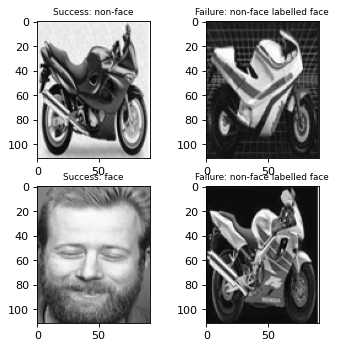

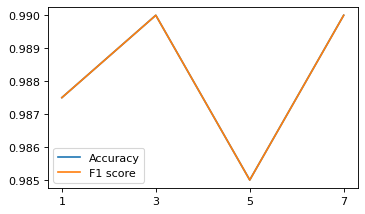

Dominant: 15
* k: 1, accuracy: 0.990, f1 score: 0.990


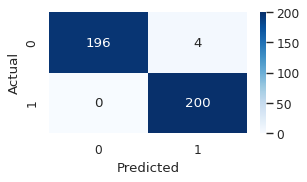

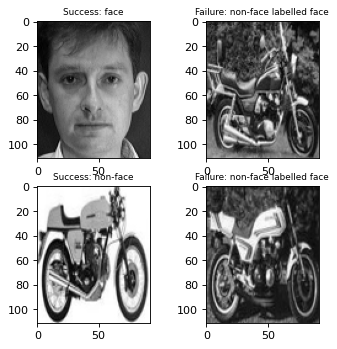

* k: 3, accuracy: 0.990, f1 score: 0.990


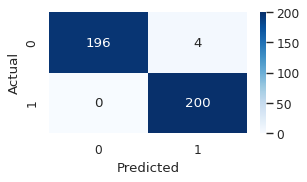

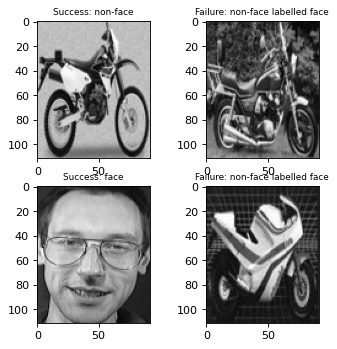

* k: 5, accuracy: 0.990, f1 score: 0.990


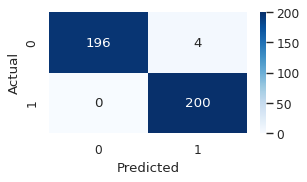

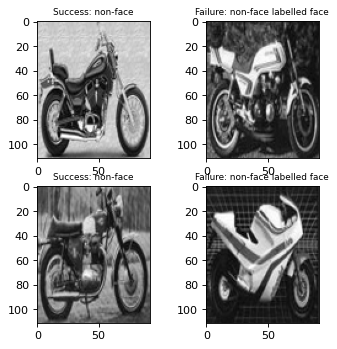

* k: 7, accuracy: 0.990, f1 score: 0.990


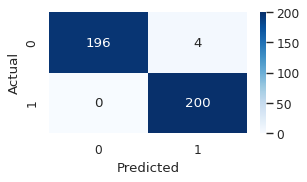

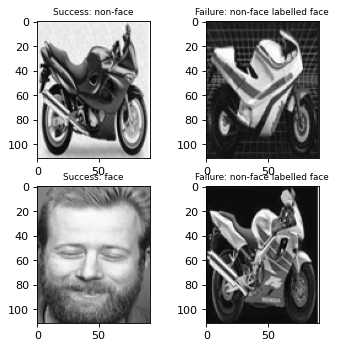

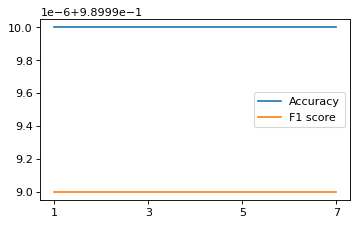

In [ ]:
acc_best_partial, f1_best_partial = use_LDA(
    sizes, eigenvectors_LDA_f_m_arr, 3, 4, examples=2
)
acc_best += acc_best_partial
f1_best += f1_best_partial

In [ ]:
print(acc_best)
print(f1_best)

[0.9375, 0.98, 0.9875, 0.9925, 0.99]
[0.9373272582555668, 0.9799919967987194, 0.9874980465697766, 0.9924995781012683, 0.98999899989999]


#### [300, 350] non-faces, [200] faces

In [ ]:
acc_best = [0.9375, 0.98, 0.9875, 0.9925, 0.99]
f1_best = [
    0.9373272582555668,
    0.9799919967987194,
    0.9874980465697766,
    0.9924995781012683,
    0.98999899989999,
]

In [ ]:
eigenvectors_LDA_f_m_arr = calculate_LDA(sizes, 5, 6)

Non-faces: 300, faces: 200
Non-faces: 350, faces: 200


Non-faces: 300, faces: 200
Dominant: 1
* k: 1, accuracy: 0.873, f1 score: 0.872


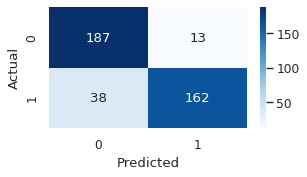

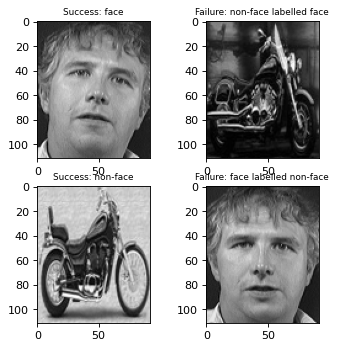

* k: 3, accuracy: 0.897, f1 score: 0.897


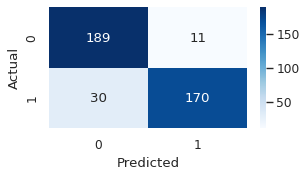

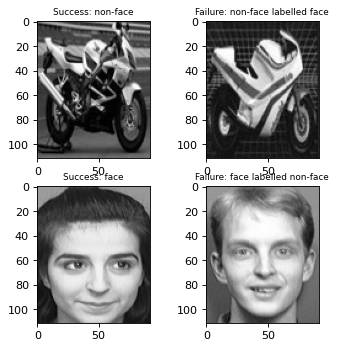

* k: 5, accuracy: 0.927, f1 score: 0.927


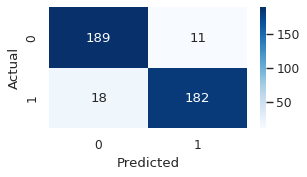

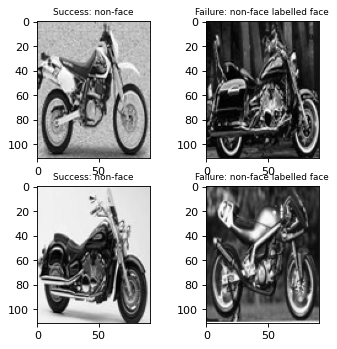

* k: 7, accuracy: 0.943, f1 score: 0.942


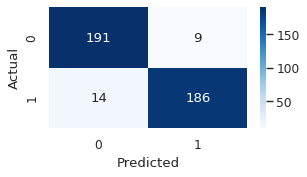

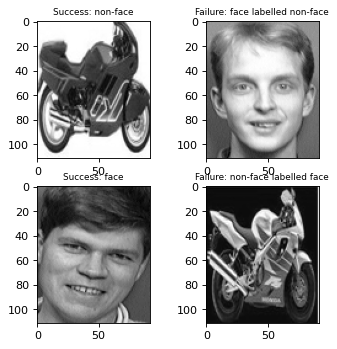

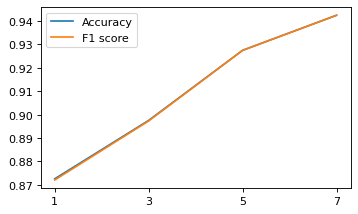

Dominant: 2
* k: 1, accuracy: 0.983, f1 score: 0.982


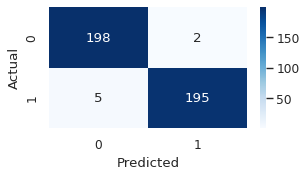

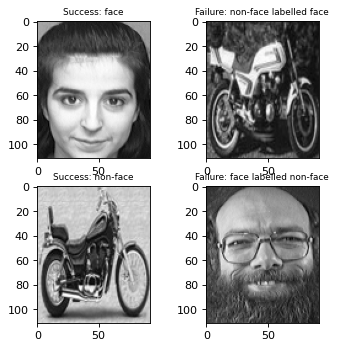

* k: 3, accuracy: 0.988, f1 score: 0.987


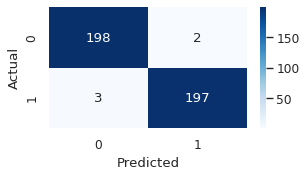

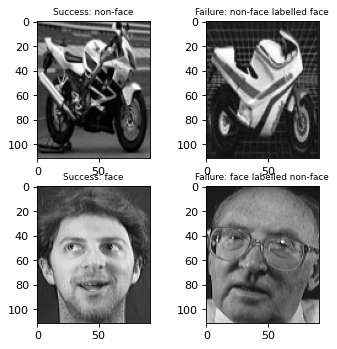

* k: 5, accuracy: 0.983, f1 score: 0.982


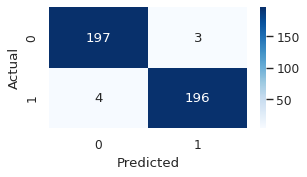

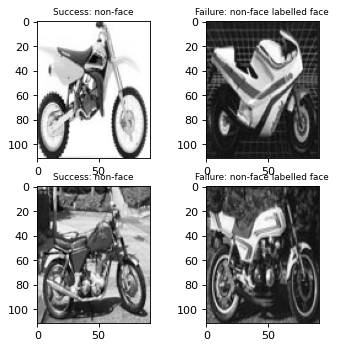

* k: 7, accuracy: 0.990, f1 score: 0.990


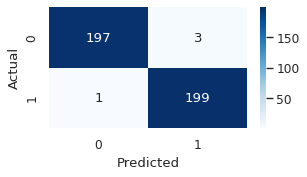

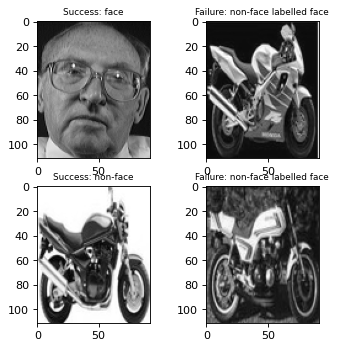

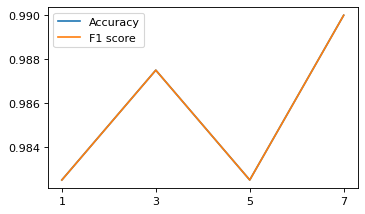

Dominant: 5
* k: 1, accuracy: 0.985, f1 score: 0.985


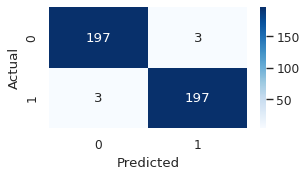

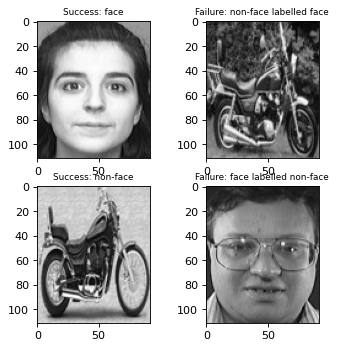

* k: 3, accuracy: 0.988, f1 score: 0.987


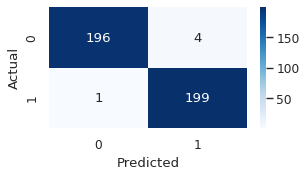

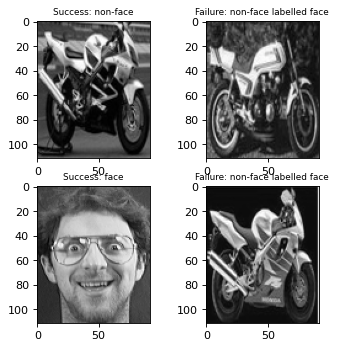

* k: 5, accuracy: 0.988, f1 score: 0.987


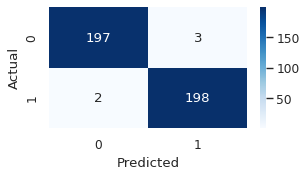

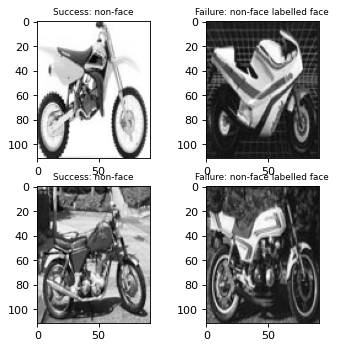

* k: 7, accuracy: 0.990, f1 score: 0.990


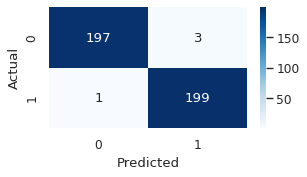

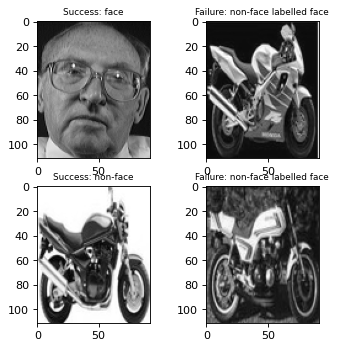

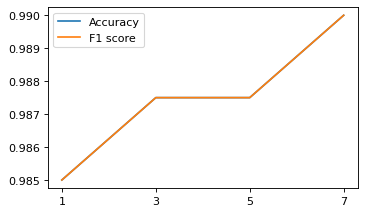

Dominant: 15
* k: 1, accuracy: 0.990, f1 score: 0.990


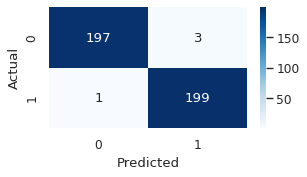

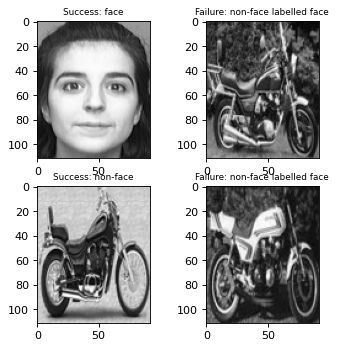

* k: 3, accuracy: 0.990, f1 score: 0.990


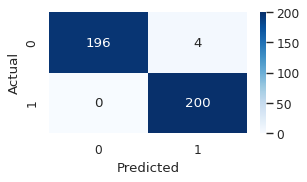

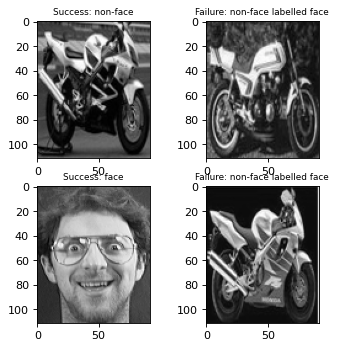

* k: 5, accuracy: 0.990, f1 score: 0.990


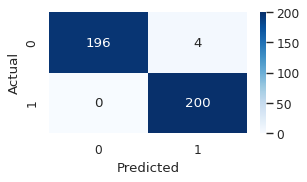

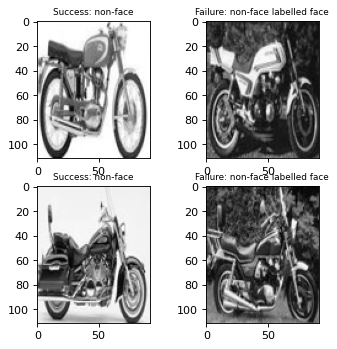

* k: 7, accuracy: 0.993, f1 score: 0.992


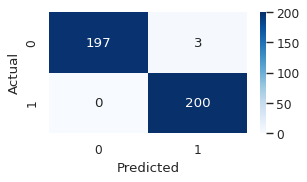

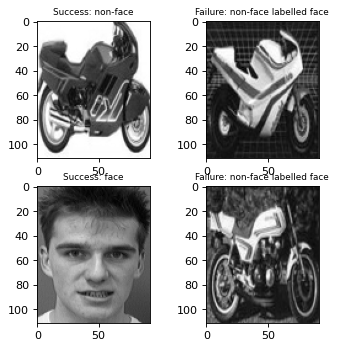

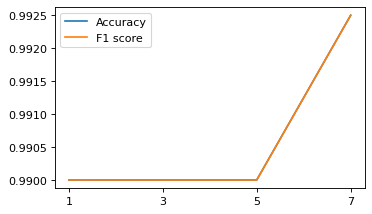

Non-faces: 350, faces: 200
Dominant: 1
* k: 1, accuracy: 0.882, f1 score: 0.882


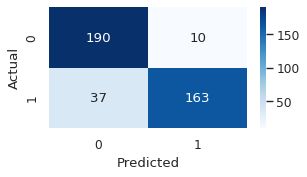

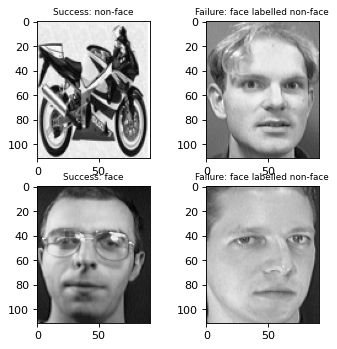

* k: 3, accuracy: 0.915, f1 score: 0.915


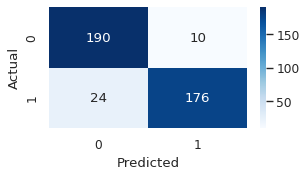

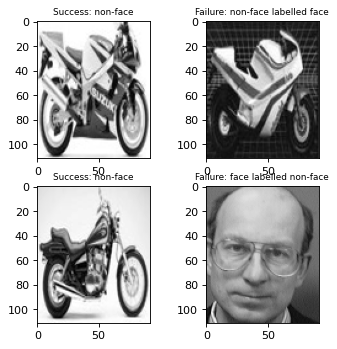

* k: 5, accuracy: 0.927, f1 score: 0.927


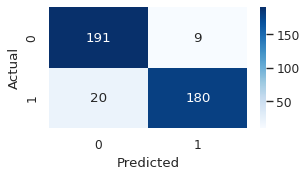

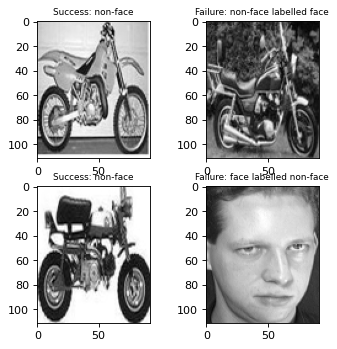

* k: 7, accuracy: 0.938, f1 score: 0.937


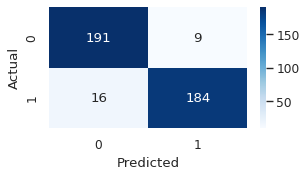

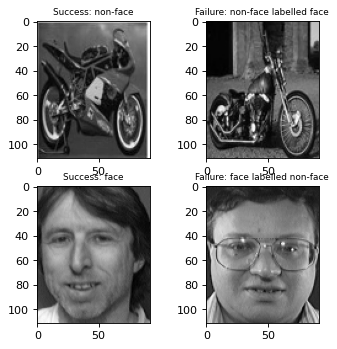

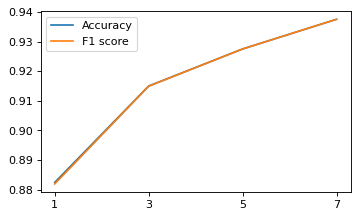

Dominant: 2
* k: 1, accuracy: 0.985, f1 score: 0.985


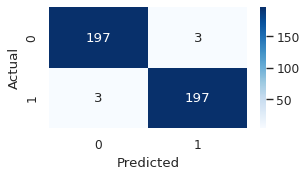

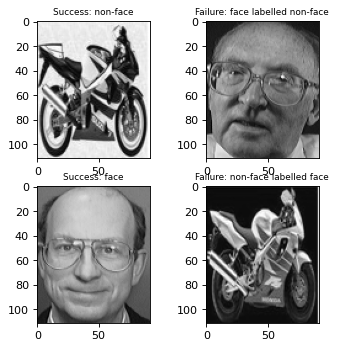

* k: 3, accuracy: 0.978, f1 score: 0.977


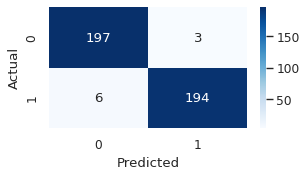

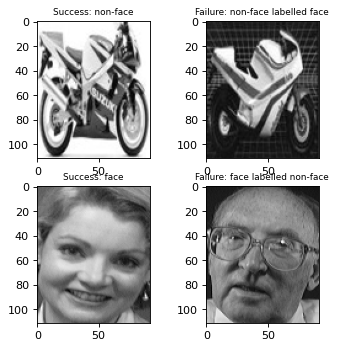

* k: 5, accuracy: 0.985, f1 score: 0.985


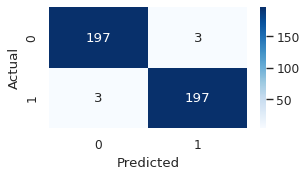

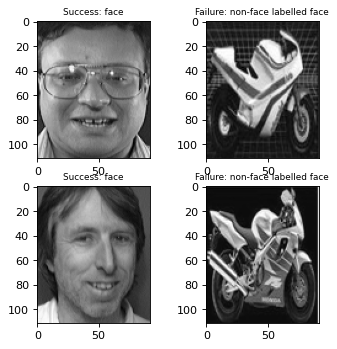

* k: 7, accuracy: 0.985, f1 score: 0.985


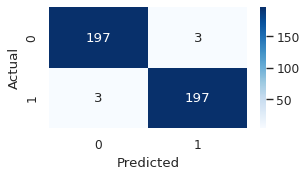

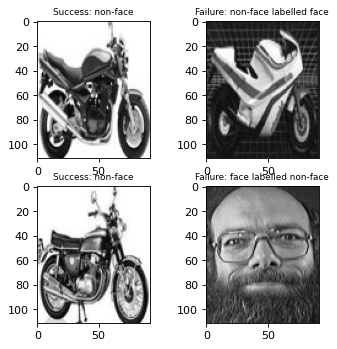

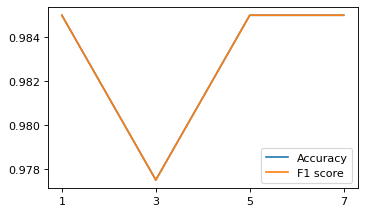

Dominant: 5
* k: 1, accuracy: 0.985, f1 score: 0.985


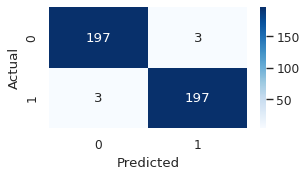

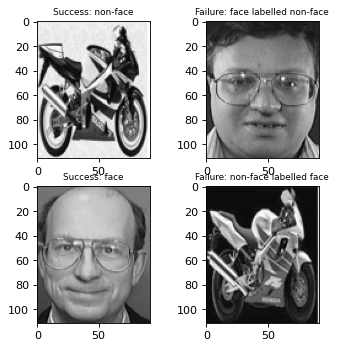

* k: 3, accuracy: 0.980, f1 score: 0.980


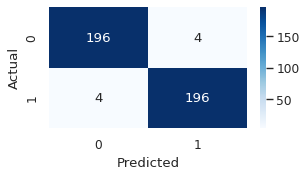

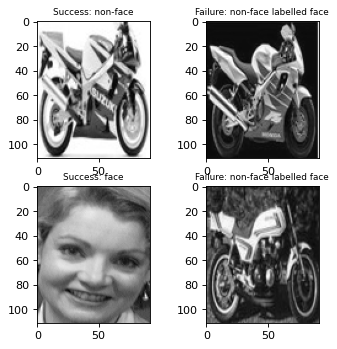

* k: 5, accuracy: 0.985, f1 score: 0.985


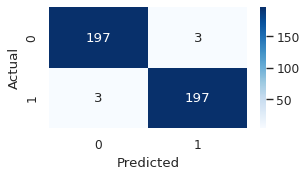

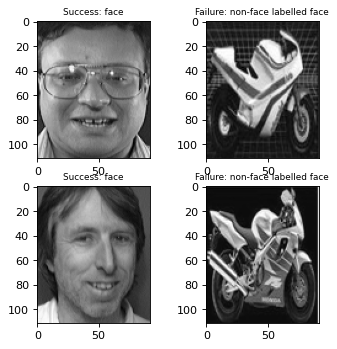

* k: 7, accuracy: 0.983, f1 score: 0.982


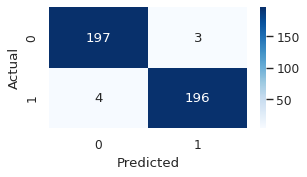

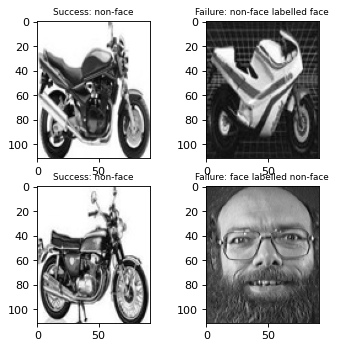

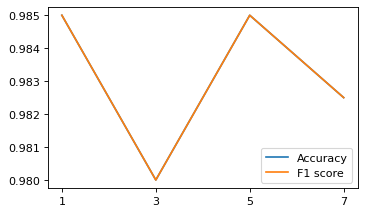

Dominant: 15
* k: 1, accuracy: 0.993, f1 score: 0.992


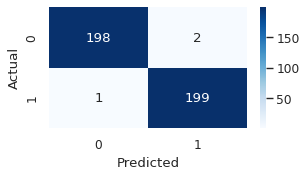

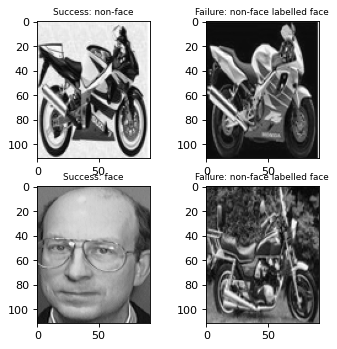

* k: 3, accuracy: 0.993, f1 score: 0.992


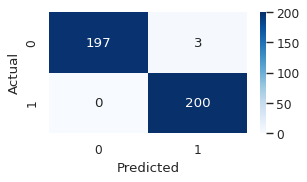

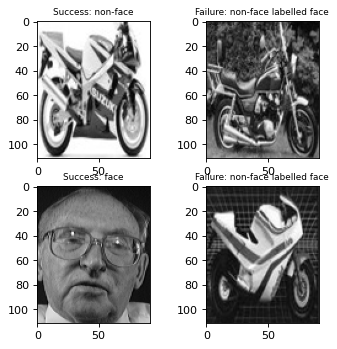

* k: 5, accuracy: 0.993, f1 score: 0.992


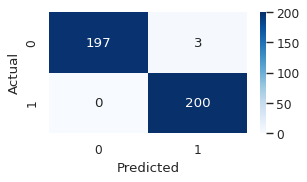

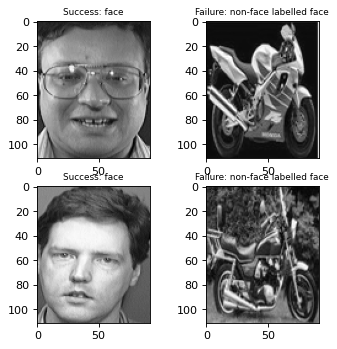

* k: 7, accuracy: 0.993, f1 score: 0.992


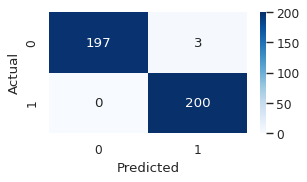

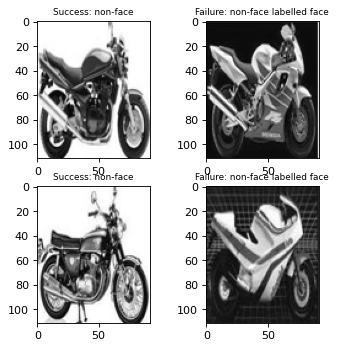

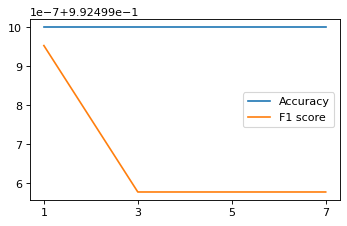

In [ ]:
acc_best_partial, f1_best_partial = use_LDA(
    sizes, eigenvectors_LDA_f_m_arr, 5, 6, examples=2
)
acc_best += acc_best_partial
f1_best += f1_best_partial

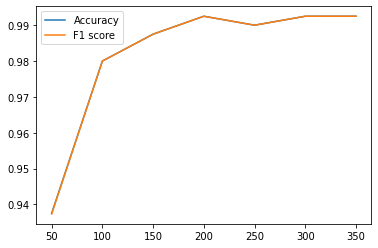

In [ ]:
plt.figure()
plt.plot(sizes, acc_best)
plt.plot(sizes, f1_best)
plt.xticks(sizes)
plt.legend(['Accuracy', 'F1 score'])
plt.show()

In [ ]:
print(acc_best)
print(f1_best)

[0.9375, 0.98, 0.9875, 0.9925, 0.99, 0.9925, 0.9925]
[0.9373272582555668, 0.9799919967987194, 0.9874980465697766, 0.9924995781012683, 0.98999899989999, 0.9924995781012683, 0.9924999531247071]


#### Comment
* 50 non-faces had very poor accuracy and F1-score. 
* [200, 300, 350] non-faces vs [200] faces had the overall best accuracies at 0.9925.
* Binary classification had overall better accuracies compared to Multi-class classification.
* General upward trend in accuracy as the number of non-faces samples increase, seems to be plateauing at around 200 non-faces.

### PCA

In [ ]:
eigenvalues_f_m_arr = []
eigenvectors_f_m_arr = []
data_z = []
for i in range(len(sizes)):
    s = sizes[i]
    print(f"Non-faces: {s}, faces: 200")
    mean = np.mean(training_data_matrices[i], axis=0)
    z = training_data_matrices[i] - mean
    data_z.append(z)

    COV = np.cov(
        z.transpose(), bias=True
    )  # bias=True to normalize using 1/n instead of 1/(n-1)

    eigenvalues_f_m, eigenvectors_f_m = np.linalg.eigh(COV)
    eigenvalues_f_m_arr.append(eigenvalues_f_m)
    eigenvectors_f_m_arr.append(eigenvectors_f_m)

Non-faces: 50, faces: 200
Non-faces: 100, faces: 200
Non-faces: 150, faces: 200
Non-faces: 200, faces: 200
Non-faces: 250, faces: 200
Non-faces: 300, faces: 200
Non-faces: 350, faces: 200


Non-faces: 50, faces: 200
[23, 37, 58, 100]
alpha: 0.800
* k: 1, accuracy: 0.818, f1 score: 0.811


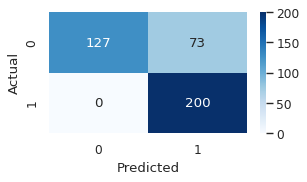

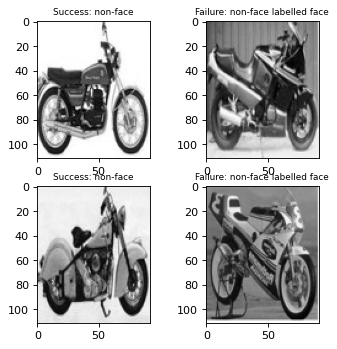

* k: 3, accuracy: 0.792, f1 score: 0.783


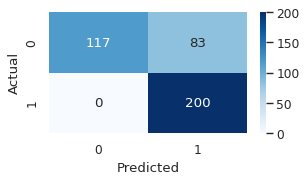

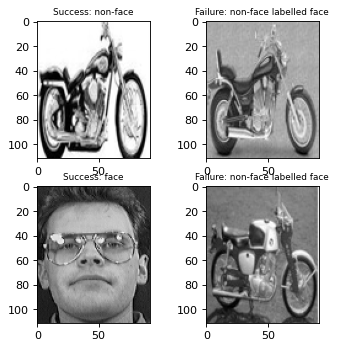

* k: 5, accuracy: 0.780, f1 score: 0.769


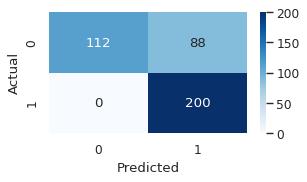

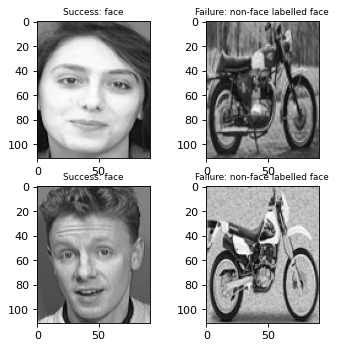

* k: 7, accuracy: 0.775, f1 score: 0.763


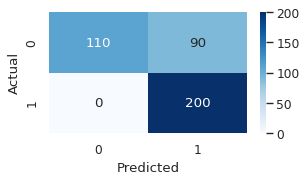

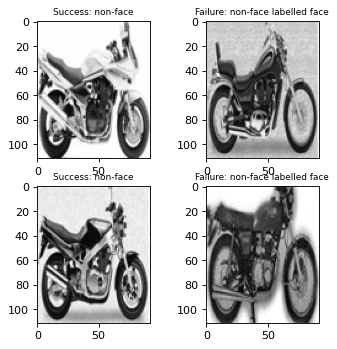

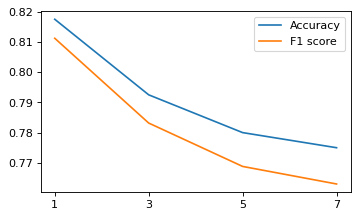

alpha: 0.850
* k: 1, accuracy: 0.772, f1 score: 0.760


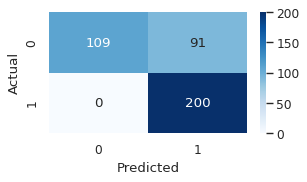

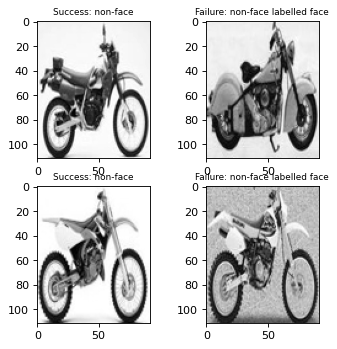

* k: 3, accuracy: 0.757, f1 score: 0.742


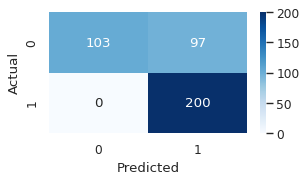

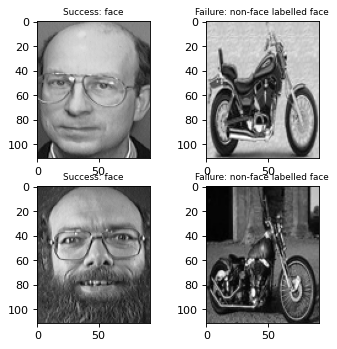

* k: 5, accuracy: 0.750, f1 score: 0.733


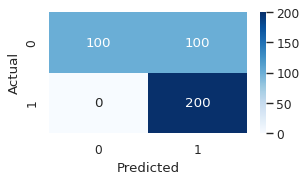

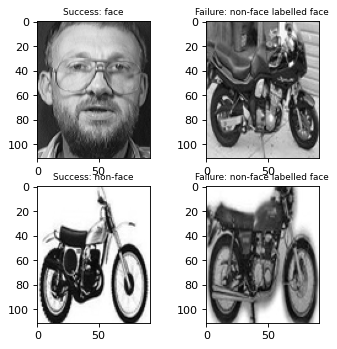

* k: 7, accuracy: 0.735, f1 score: 0.715


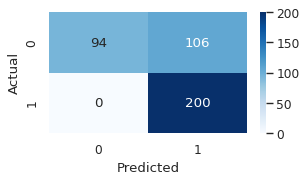

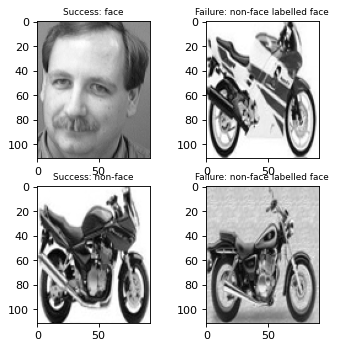

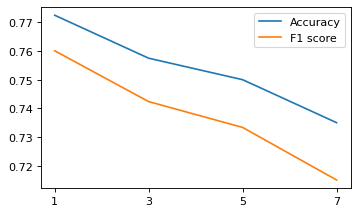

alpha: 0.900
* k: 1, accuracy: 0.738, f1 score: 0.718


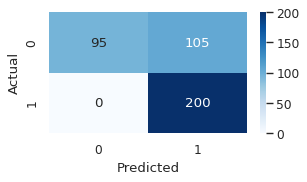

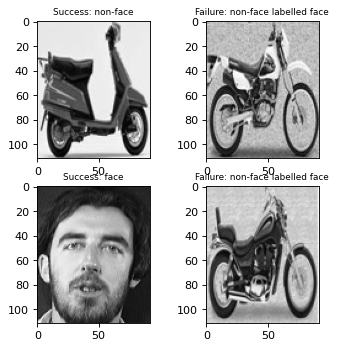

* k: 3, accuracy: 0.723, f1 score: 0.699


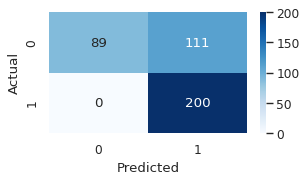

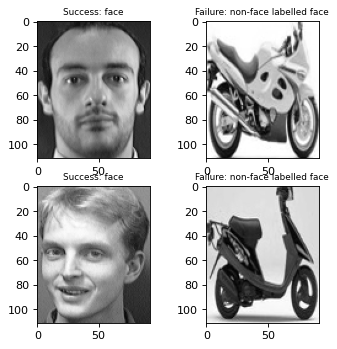

* k: 5, accuracy: 0.720, f1 score: 0.696


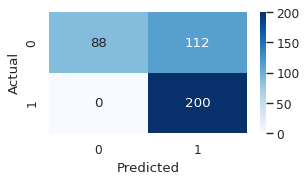

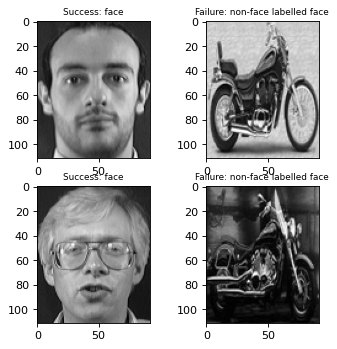

* k: 7, accuracy: 0.723, f1 score: 0.699


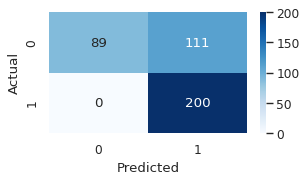

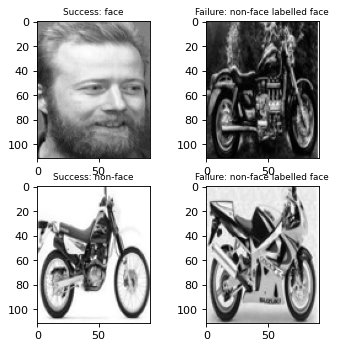

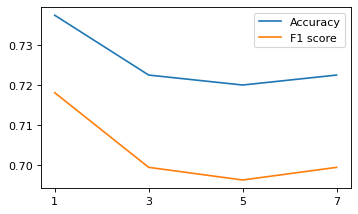

alpha: 0.950
* k: 1, accuracy: 0.715, f1 score: 0.690


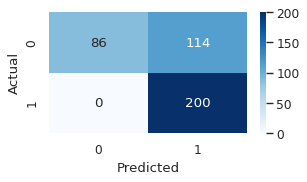

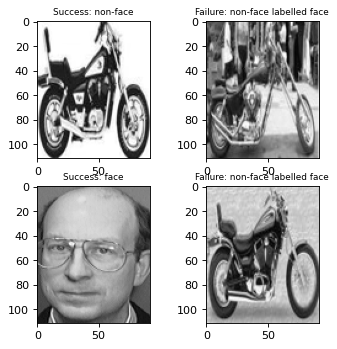

* k: 3, accuracy: 0.715, f1 score: 0.690


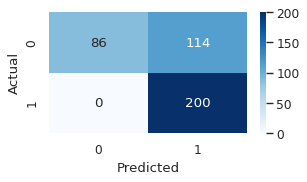

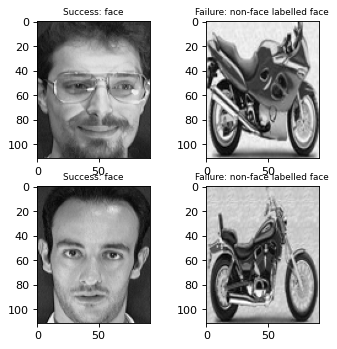

* k: 5, accuracy: 0.705, f1 score: 0.677


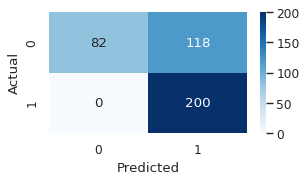

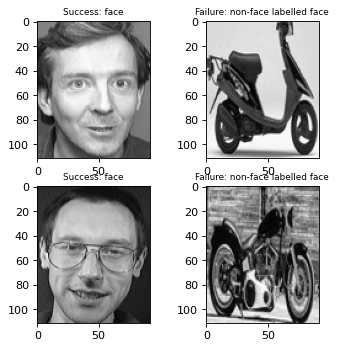

* k: 7, accuracy: 0.703, f1 score: 0.674


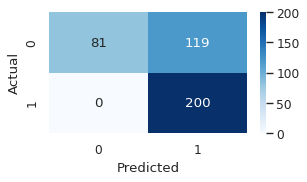

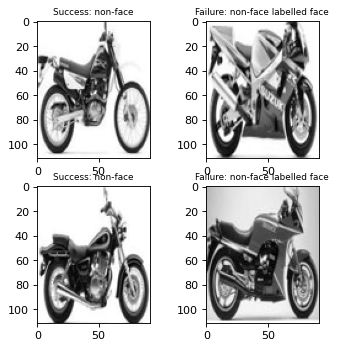

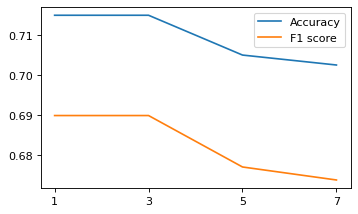

Accuracies vs Alpha


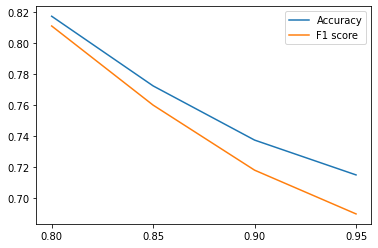

Non-faces: 100, faces: 200
[29, 46, 74, 122]
alpha: 0.800
* k: 1, accuracy: 0.940, f1 score: 0.940


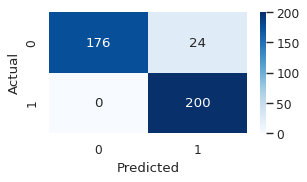

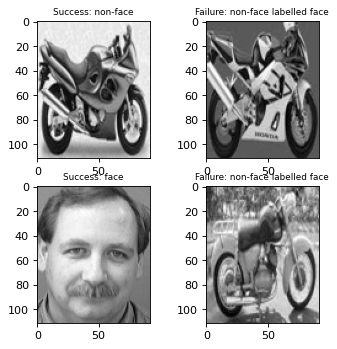

* k: 3, accuracy: 0.892, f1 score: 0.891


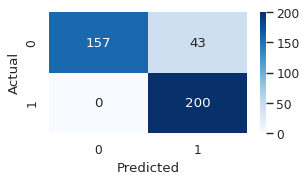

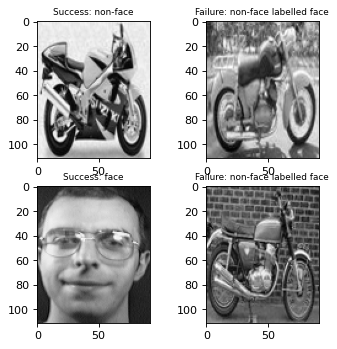

* k: 5, accuracy: 0.880, f1 score: 0.878


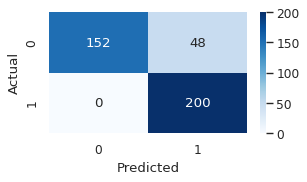

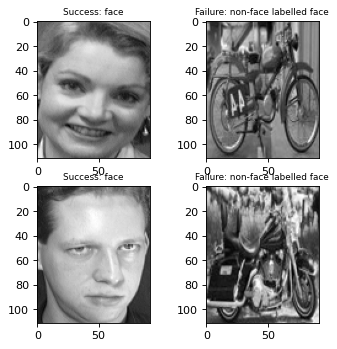

* k: 7, accuracy: 0.858, f1 score: 0.855


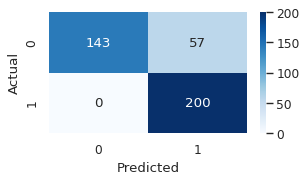

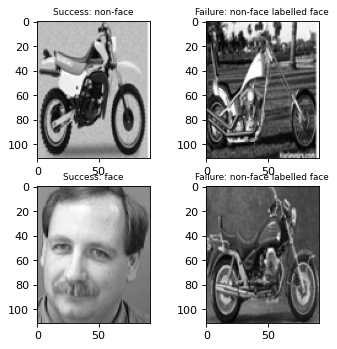

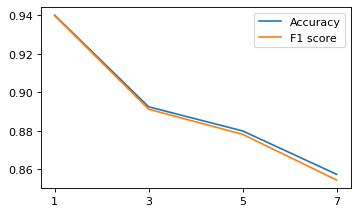

alpha: 0.850
* k: 1, accuracy: 0.912, f1 score: 0.912


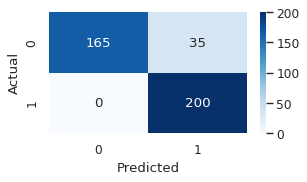

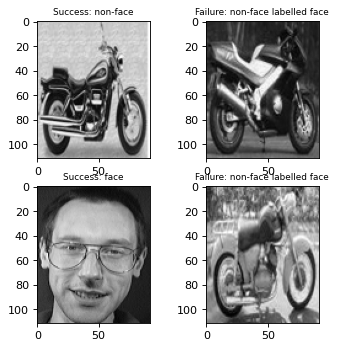

* k: 3, accuracy: 0.860, f1 score: 0.857


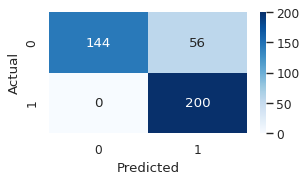

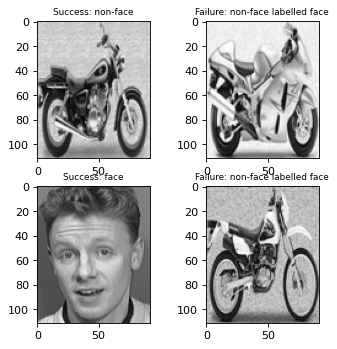

* k: 5, accuracy: 0.835, f1 score: 0.830


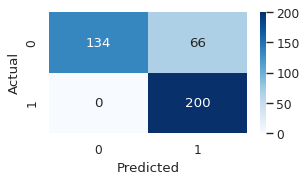

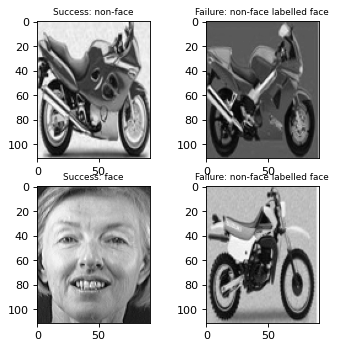

* k: 7, accuracy: 0.828, f1 score: 0.822


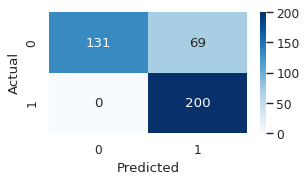

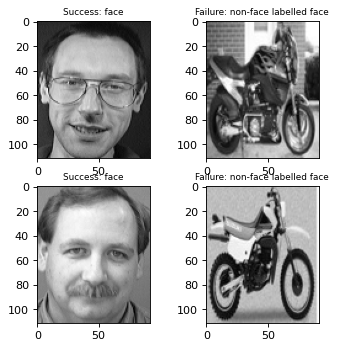

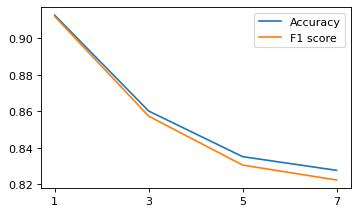

alpha: 0.900
* k: 1, accuracy: 0.895, f1 score: 0.894


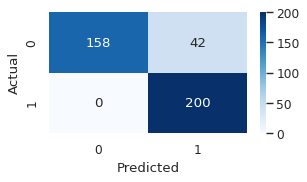

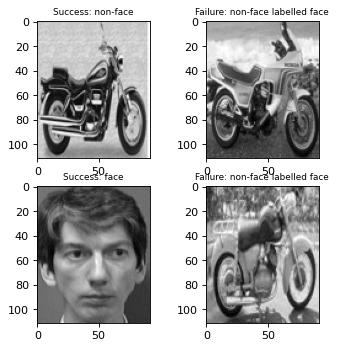

* k: 3, accuracy: 0.820, f1 score: 0.814


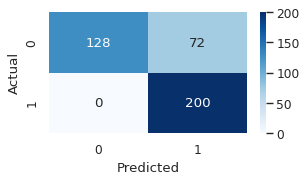

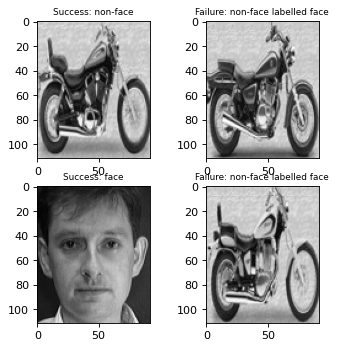

* k: 5, accuracy: 0.797, f1 score: 0.789


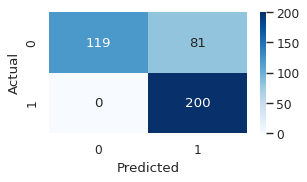

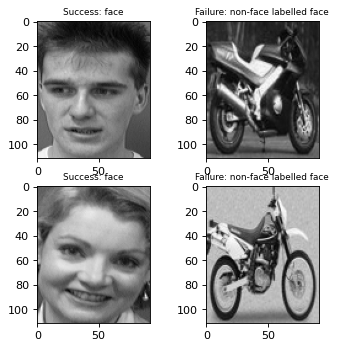

* k: 7, accuracy: 0.792, f1 score: 0.783


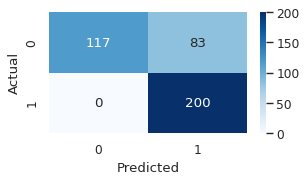

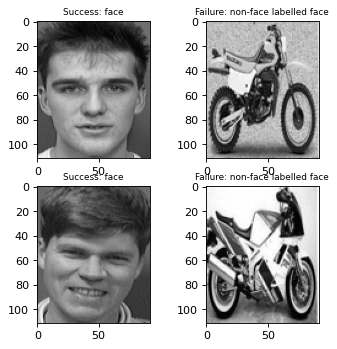

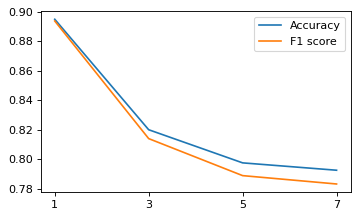

alpha: 0.950
* k: 1, accuracy: 0.838, f1 score: 0.833


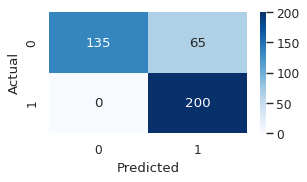

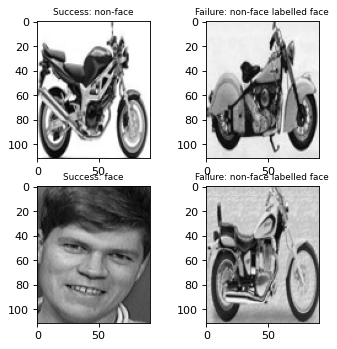

* k: 3, accuracy: 0.792, f1 score: 0.783


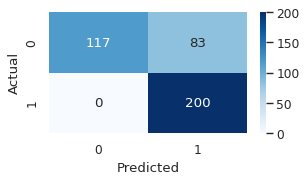

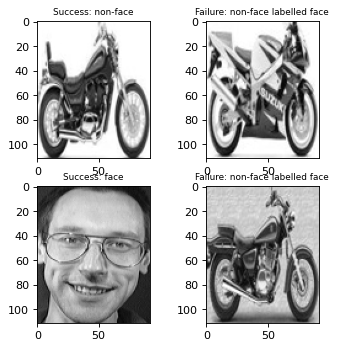

* k: 5, accuracy: 0.767, f1 score: 0.754


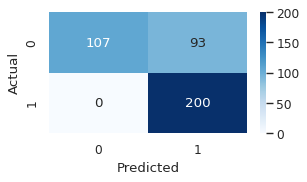

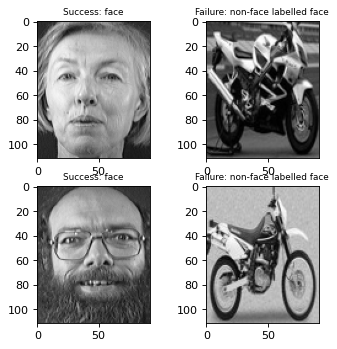

* k: 7, accuracy: 0.752, f1 score: 0.736


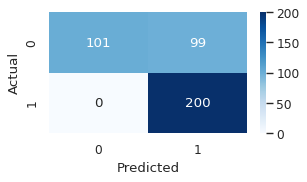

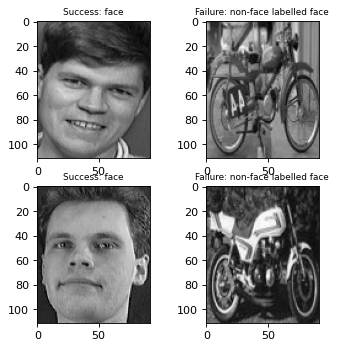

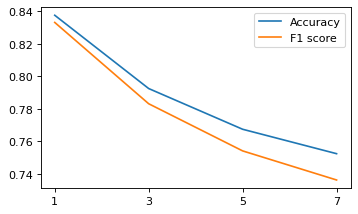

Accuracies vs Alpha


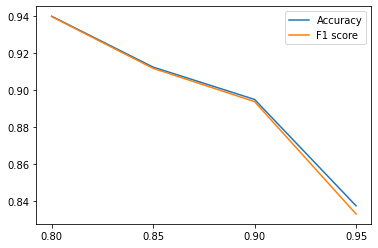

Non-faces: 150, faces: 200
[35, 56, 90, 148]
alpha: 0.800
* k: 1, accuracy: 0.978, f1 score: 0.977


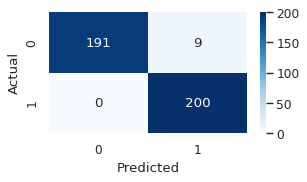

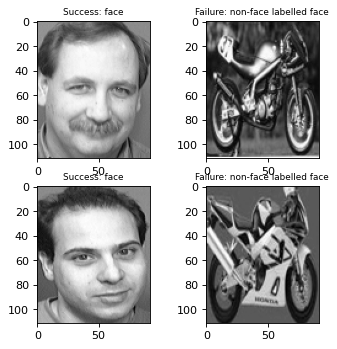

* k: 3, accuracy: 0.968, f1 score: 0.967


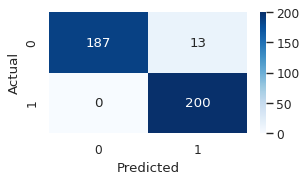

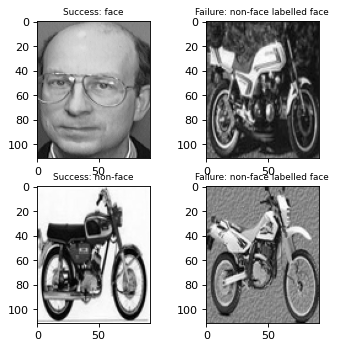

* k: 5, accuracy: 0.965, f1 score: 0.965


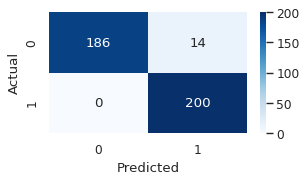

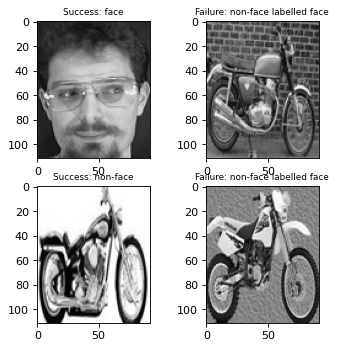

* k: 7, accuracy: 0.963, f1 score: 0.962


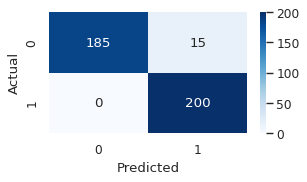

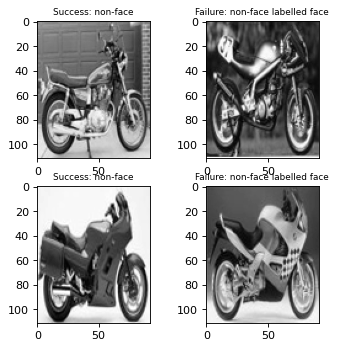

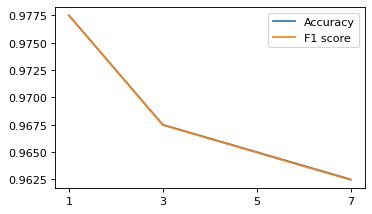

alpha: 0.850
* k: 1, accuracy: 0.970, f1 score: 0.970


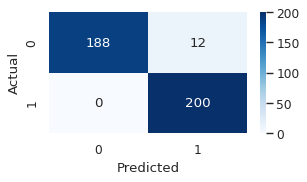

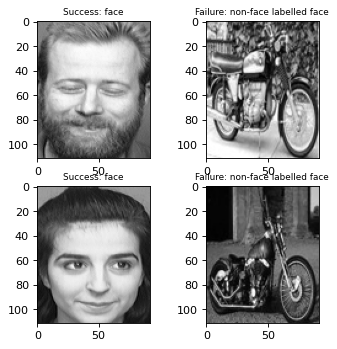

* k: 3, accuracy: 0.960, f1 score: 0.960


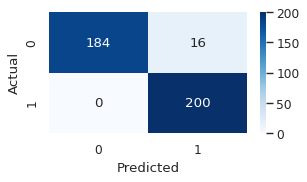

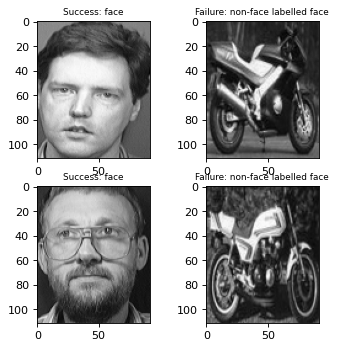

* k: 5, accuracy: 0.948, f1 score: 0.947


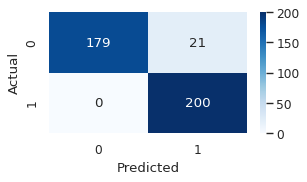

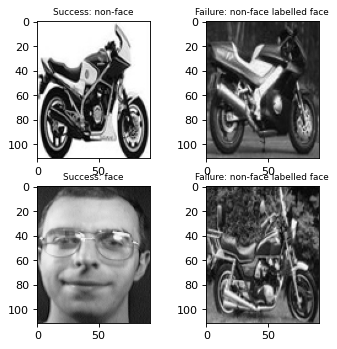

* k: 7, accuracy: 0.938, f1 score: 0.937


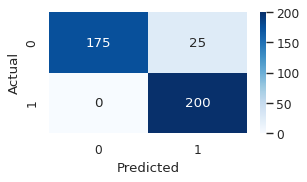

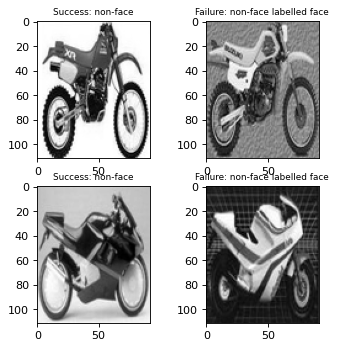

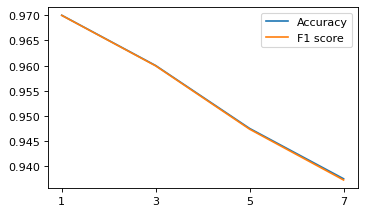

alpha: 0.900
* k: 1, accuracy: 0.955, f1 score: 0.955


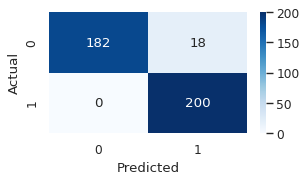

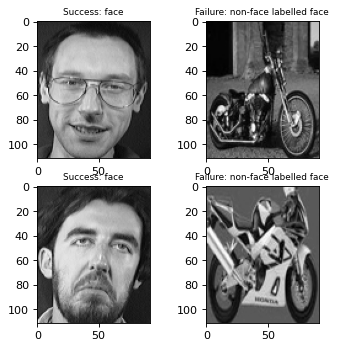

* k: 3, accuracy: 0.940, f1 score: 0.940


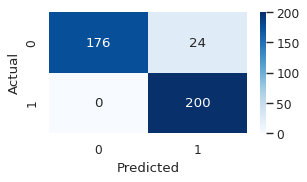

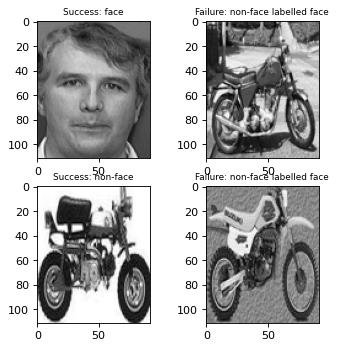

* k: 5, accuracy: 0.922, f1 score: 0.922


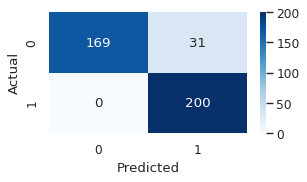

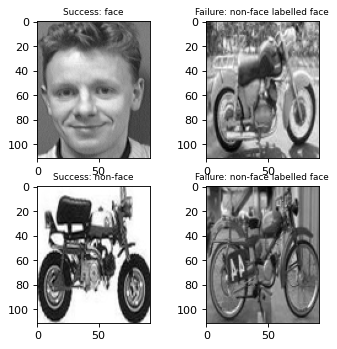

* k: 7, accuracy: 0.917, f1 score: 0.917


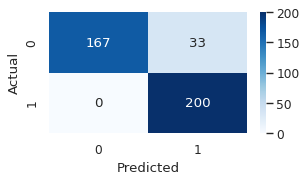

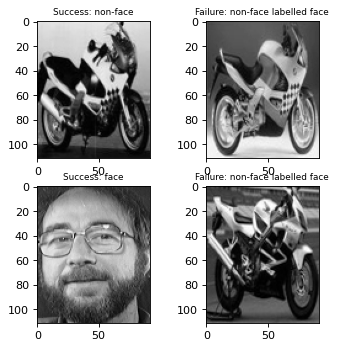

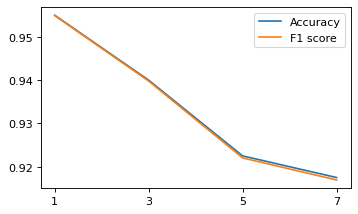

alpha: 0.950
* k: 1, accuracy: 0.930, f1 score: 0.930


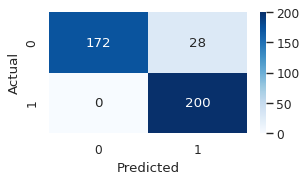

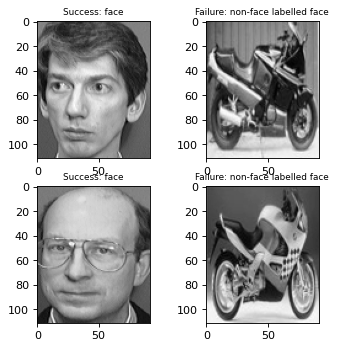

* k: 3, accuracy: 0.912, f1 score: 0.912


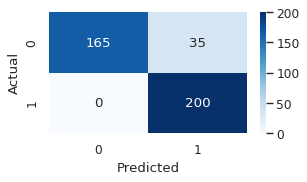

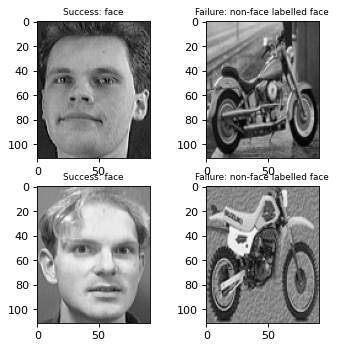

* k: 5, accuracy: 0.905, f1 score: 0.904


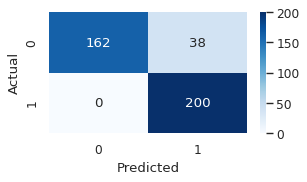

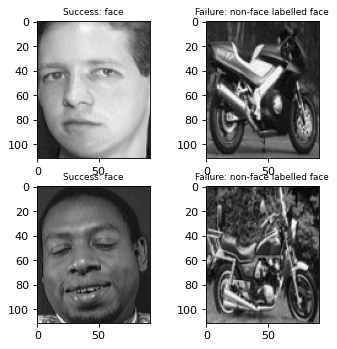

* k: 7, accuracy: 0.897, f1 score: 0.896


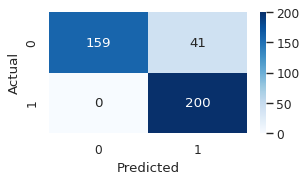

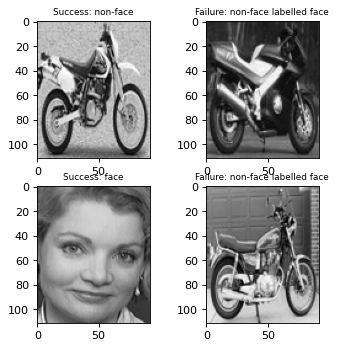

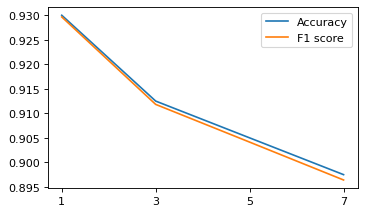

Accuracies vs Alpha


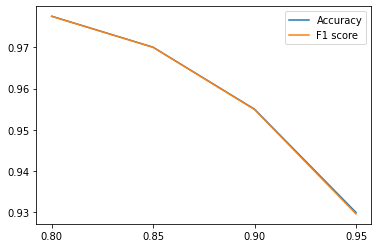

Non-faces: 200, faces: 200
[43, 68, 107, 174]
alpha: 0.800
* k: 1, accuracy: 0.983, f1 score: 0.982


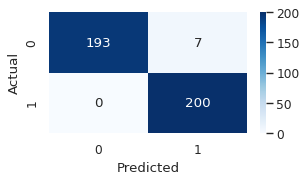

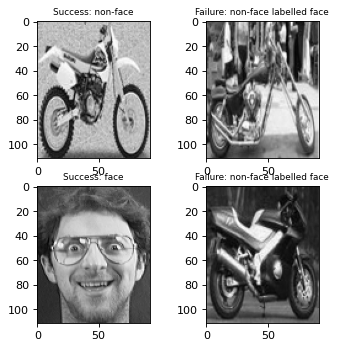

* k: 3, accuracy: 0.978, f1 score: 0.977


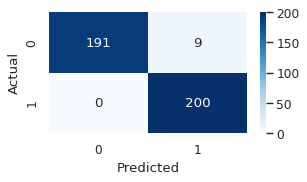

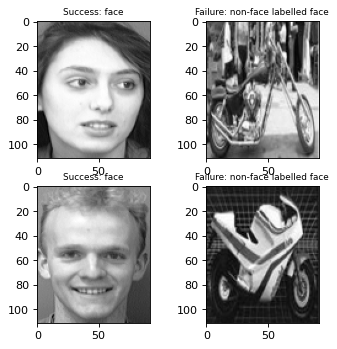

* k: 5, accuracy: 0.980, f1 score: 0.980


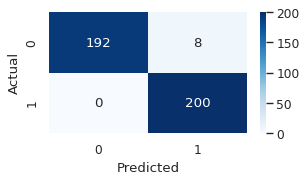

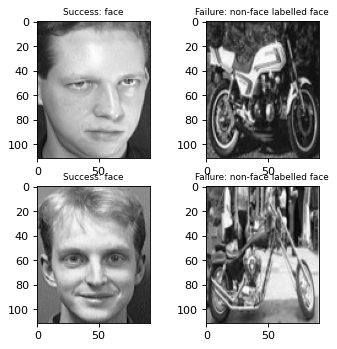

* k: 7, accuracy: 0.975, f1 score: 0.975


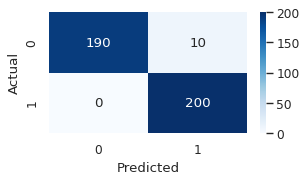

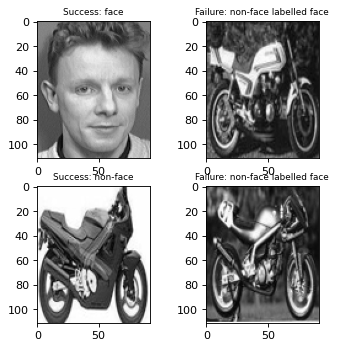

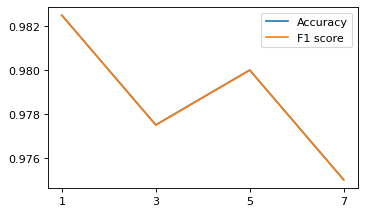

alpha: 0.850
* k: 1, accuracy: 0.978, f1 score: 0.977


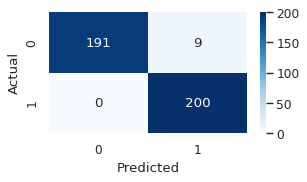

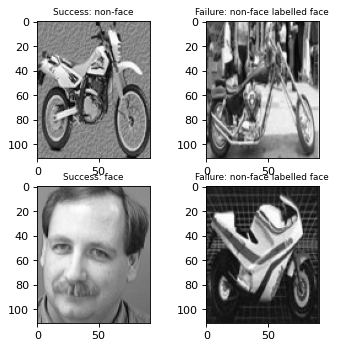

* k: 3, accuracy: 0.973, f1 score: 0.972


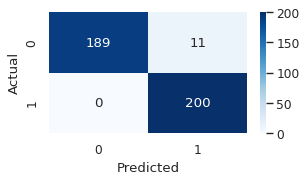

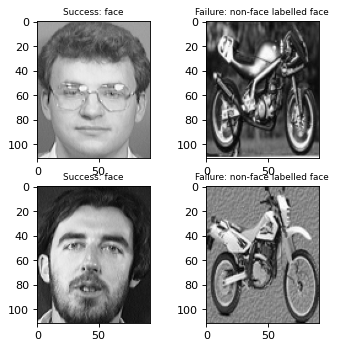

* k: 5, accuracy: 0.970, f1 score: 0.970


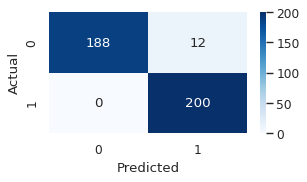

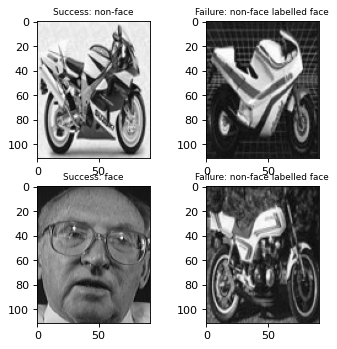

* k: 7, accuracy: 0.973, f1 score: 0.972


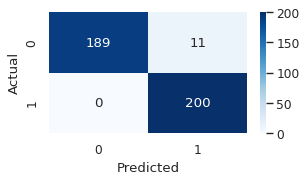

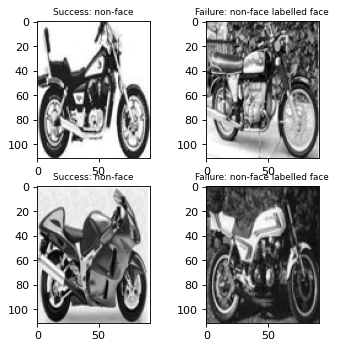

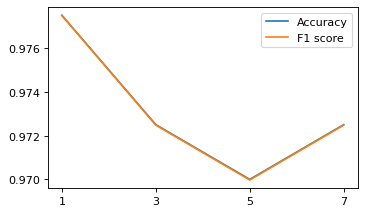

alpha: 0.900
* k: 1, accuracy: 0.975, f1 score: 0.975


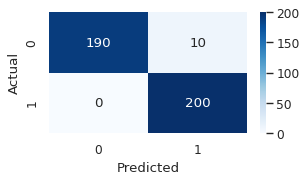

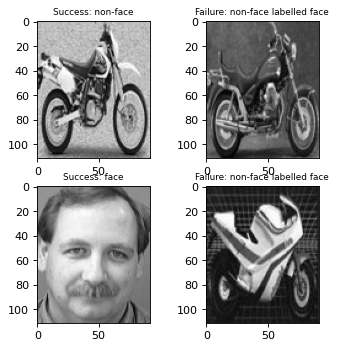

* k: 3, accuracy: 0.968, f1 score: 0.967


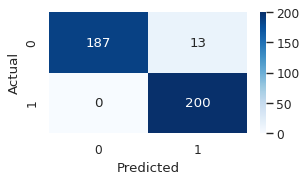

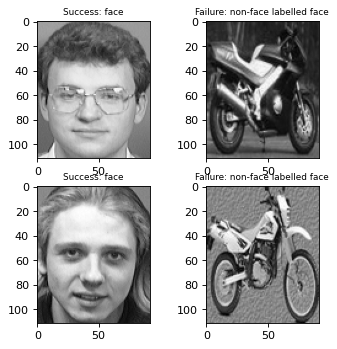

* k: 5, accuracy: 0.960, f1 score: 0.960


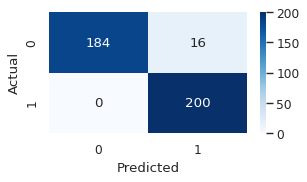

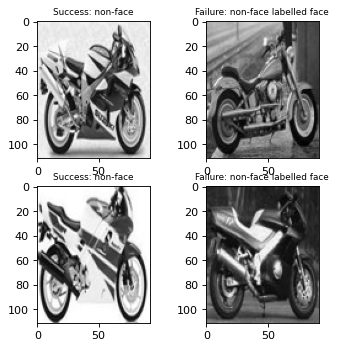

* k: 7, accuracy: 0.958, f1 score: 0.957


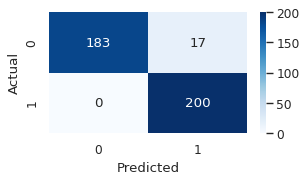

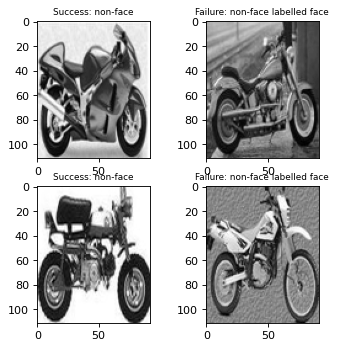

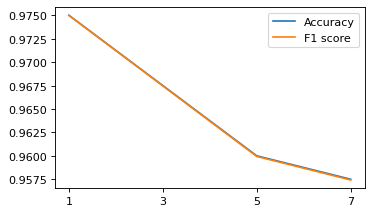

alpha: 0.950
* k: 1, accuracy: 0.958, f1 score: 0.957


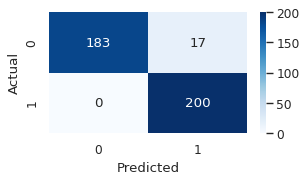

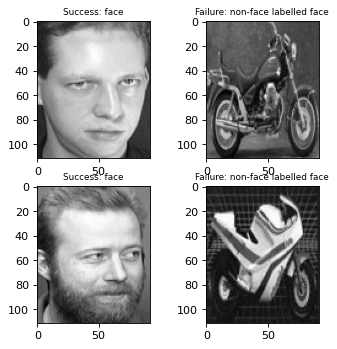

* k: 3, accuracy: 0.943, f1 score: 0.942


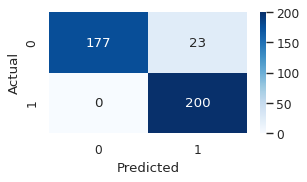

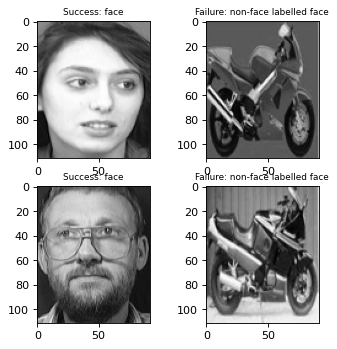

* k: 5, accuracy: 0.938, f1 score: 0.937


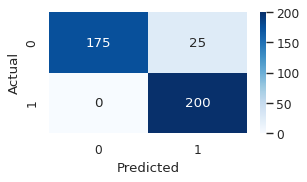

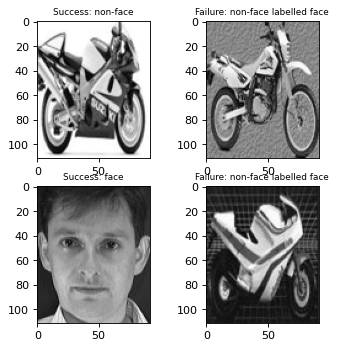

* k: 7, accuracy: 0.930, f1 score: 0.930


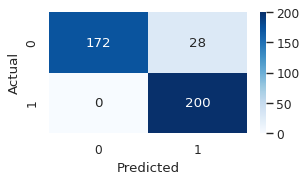

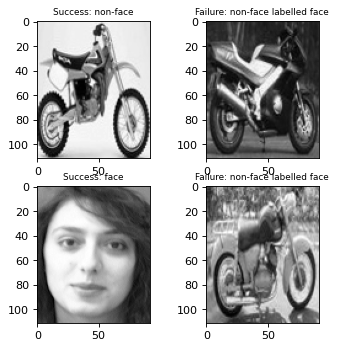

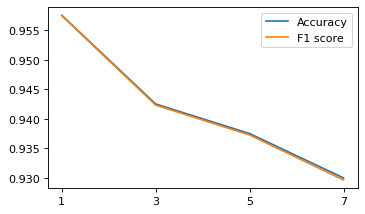

Accuracies vs Alpha


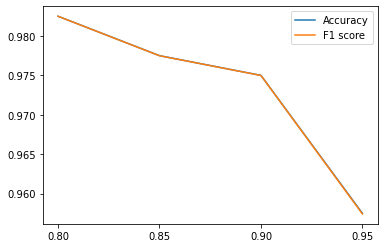

Non-faces: 250, faces: 200
[52, 80, 125, 202]
alpha: 0.800
* k: 1, accuracy: 0.988, f1 score: 0.987


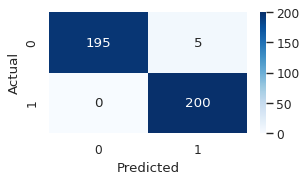

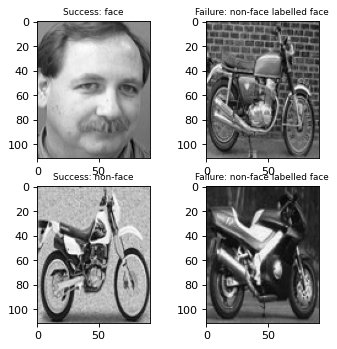

* k: 3, accuracy: 0.983, f1 score: 0.982


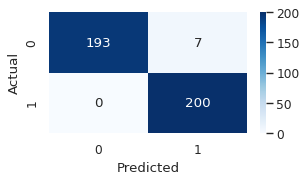

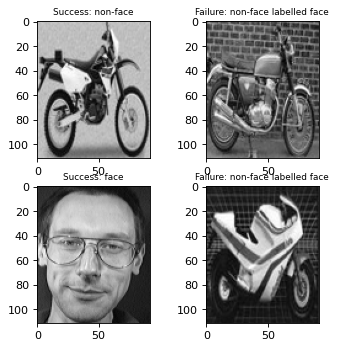

* k: 5, accuracy: 0.978, f1 score: 0.977


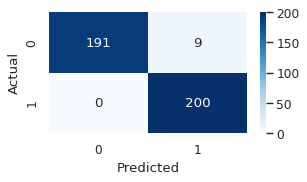

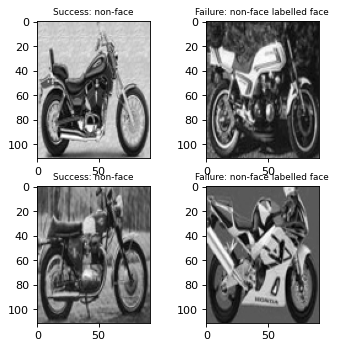

* k: 7, accuracy: 0.978, f1 score: 0.977


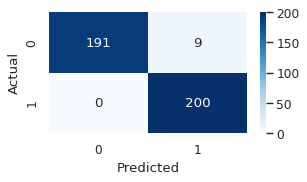

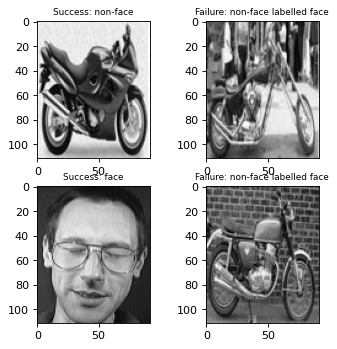

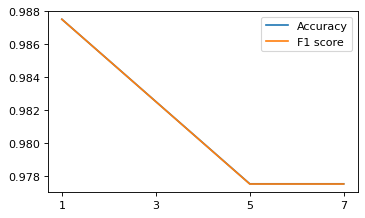

alpha: 0.850
* k: 1, accuracy: 0.983, f1 score: 0.982


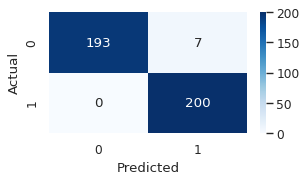

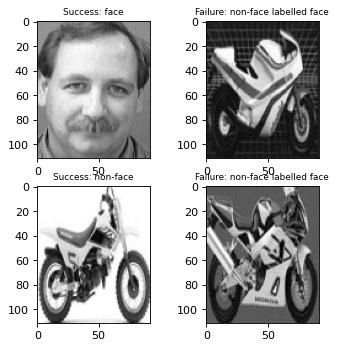

* k: 3, accuracy: 0.978, f1 score: 0.977


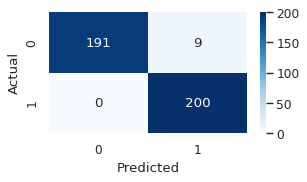

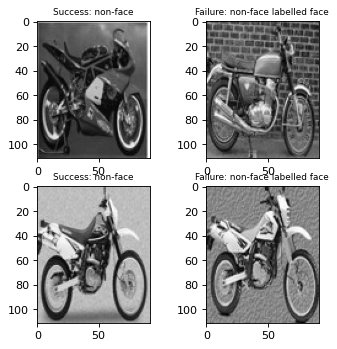

* k: 5, accuracy: 0.975, f1 score: 0.975


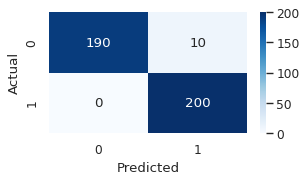

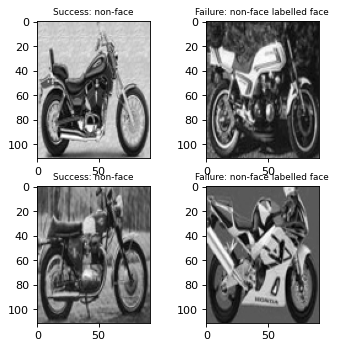

* k: 7, accuracy: 0.975, f1 score: 0.975


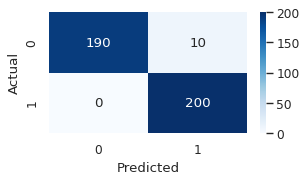

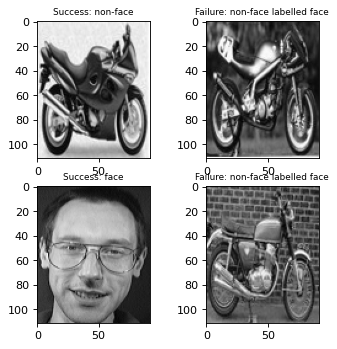

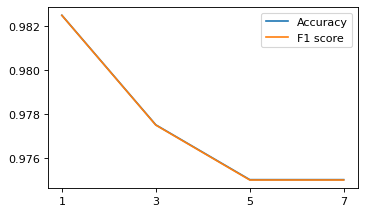

alpha: 0.900
* k: 1, accuracy: 0.980, f1 score: 0.980


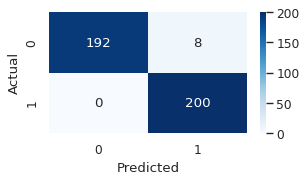

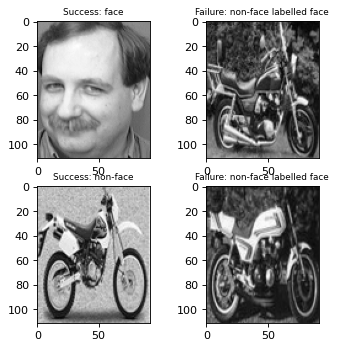

* k: 3, accuracy: 0.973, f1 score: 0.972


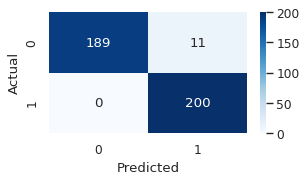

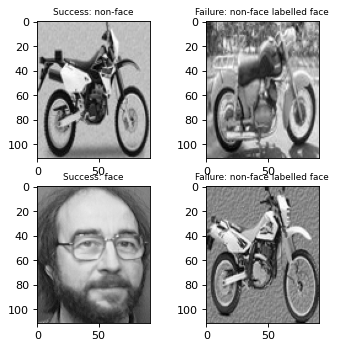

* k: 5, accuracy: 0.973, f1 score: 0.972


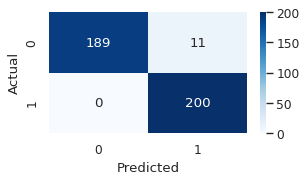

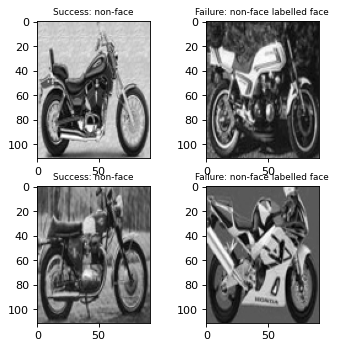

* k: 7, accuracy: 0.968, f1 score: 0.967


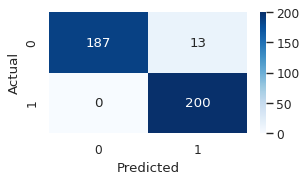

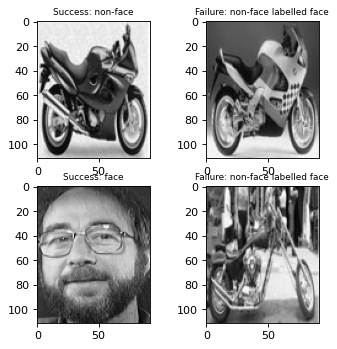

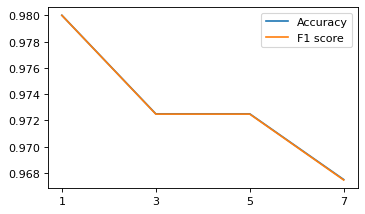

alpha: 0.950
* k: 1, accuracy: 0.970, f1 score: 0.970


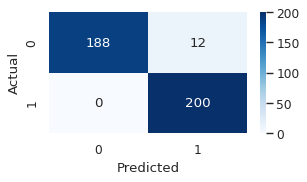

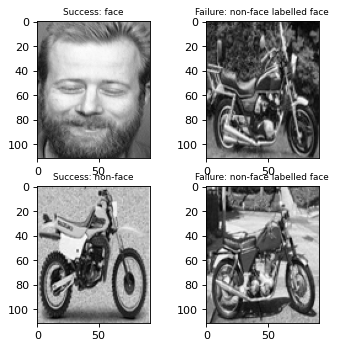

* k: 3, accuracy: 0.963, f1 score: 0.962


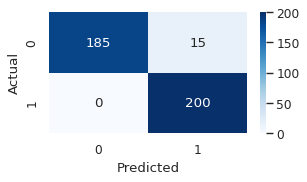

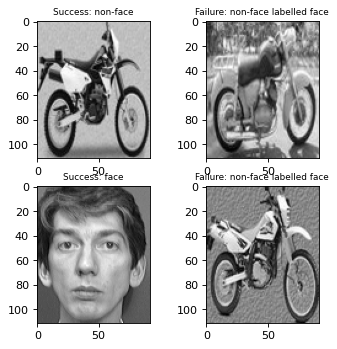

* k: 5, accuracy: 0.948, f1 score: 0.947


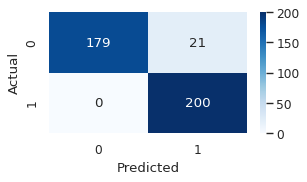

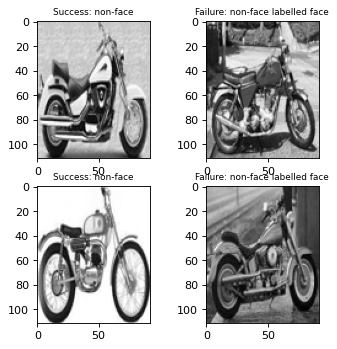

* k: 7, accuracy: 0.945, f1 score: 0.945


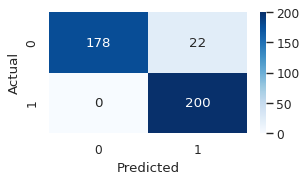

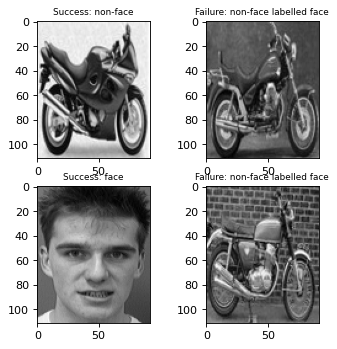

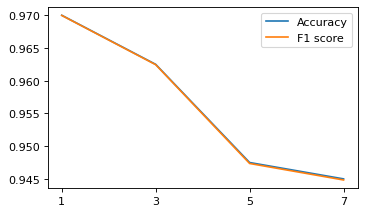

Accuracies vs Alpha


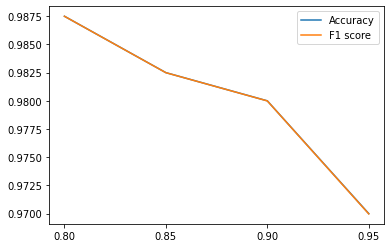

Non-faces: 300, faces: 200
[61, 94, 145, 230]
alpha: 0.800
* k: 1, accuracy: 0.990, f1 score: 0.990


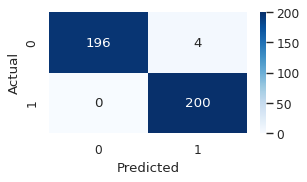

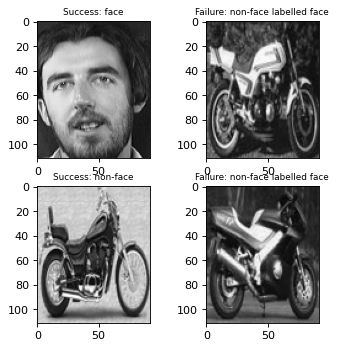

* k: 3, accuracy: 0.985, f1 score: 0.985


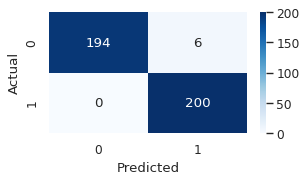

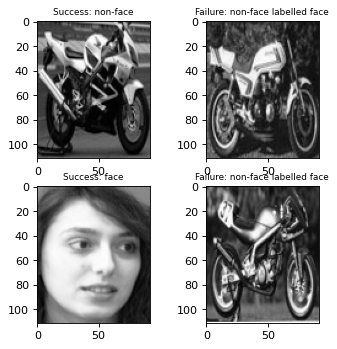

* k: 5, accuracy: 0.983, f1 score: 0.982


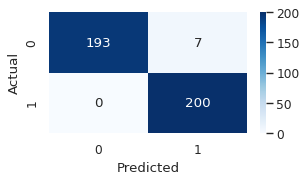

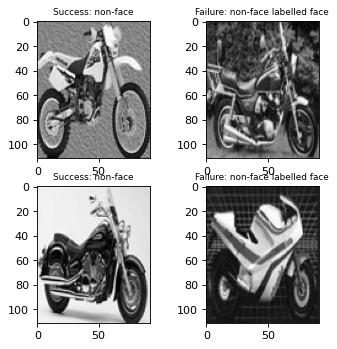

* k: 7, accuracy: 0.983, f1 score: 0.982


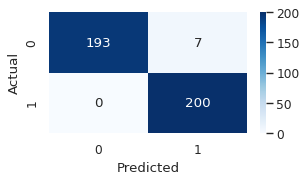

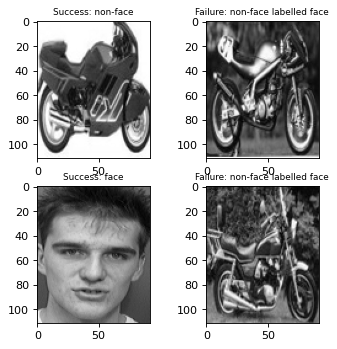

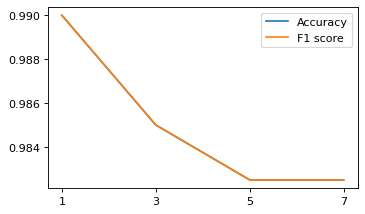

alpha: 0.850
* k: 1, accuracy: 0.983, f1 score: 0.982


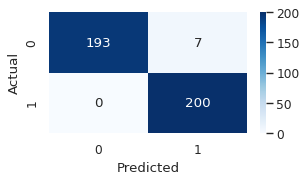

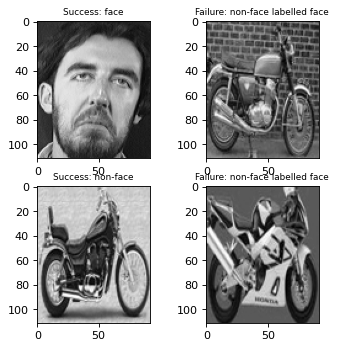

* k: 3, accuracy: 0.980, f1 score: 0.980


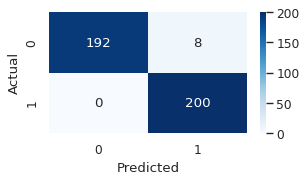

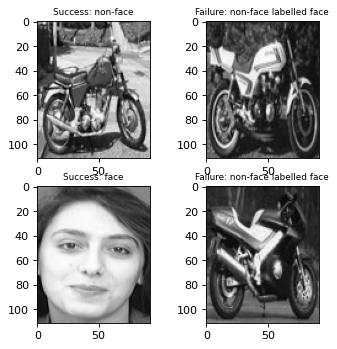

* k: 5, accuracy: 0.983, f1 score: 0.982


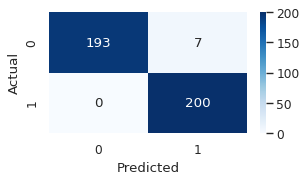

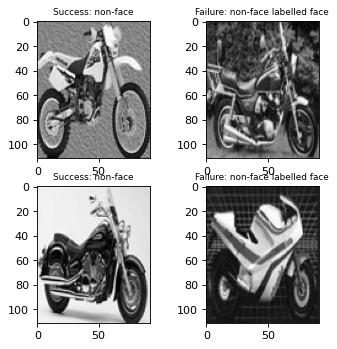

* k: 7, accuracy: 0.980, f1 score: 0.980


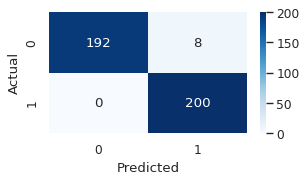

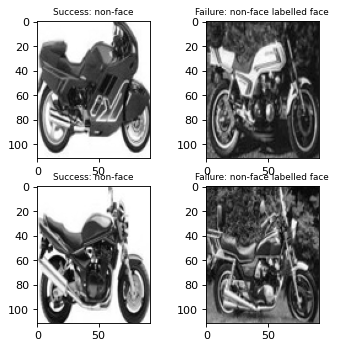

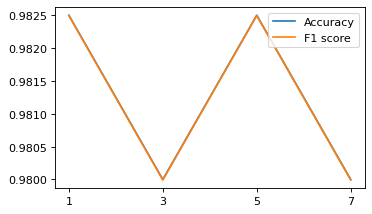

alpha: 0.900
* k: 1, accuracy: 0.983, f1 score: 0.982


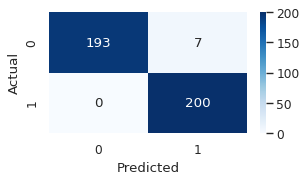

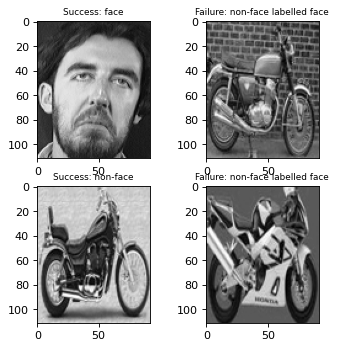

* k: 3, accuracy: 0.980, f1 score: 0.980


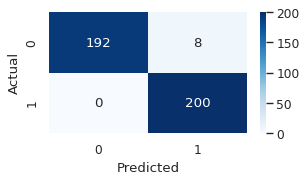

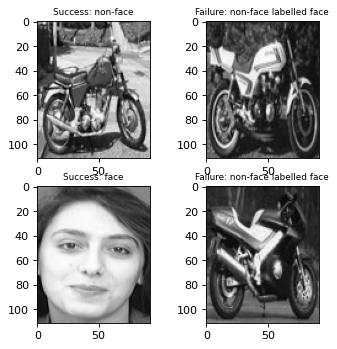

* k: 5, accuracy: 0.980, f1 score: 0.980


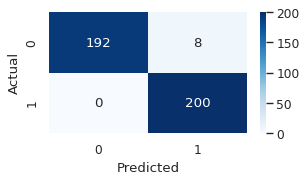

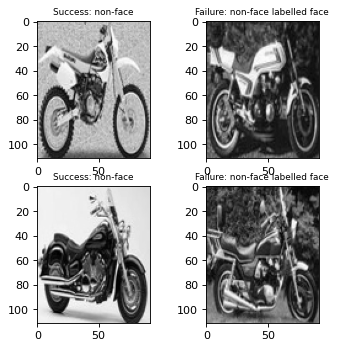

* k: 7, accuracy: 0.973, f1 score: 0.972


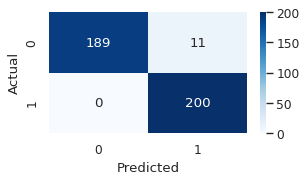

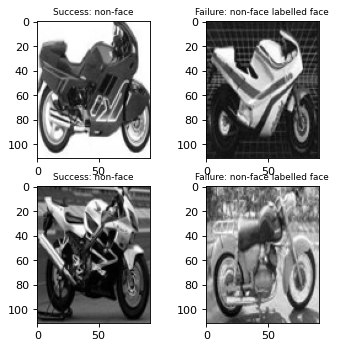

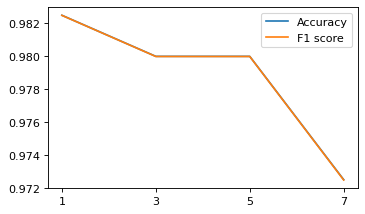

alpha: 0.950
* k: 1, accuracy: 0.978, f1 score: 0.977


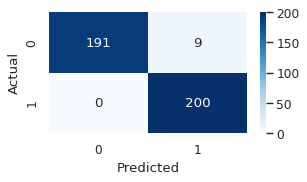

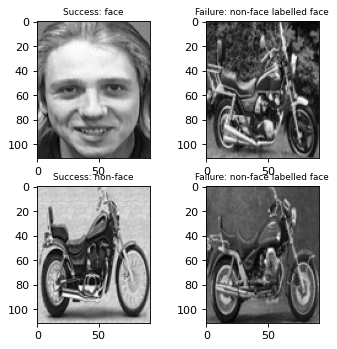

* k: 3, accuracy: 0.975, f1 score: 0.975


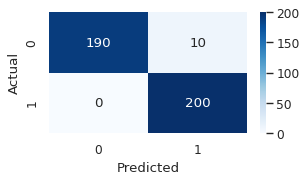

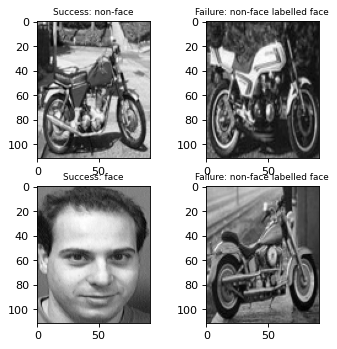

* k: 5, accuracy: 0.963, f1 score: 0.962


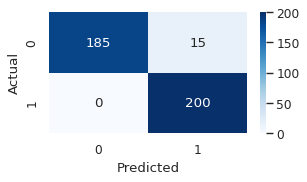

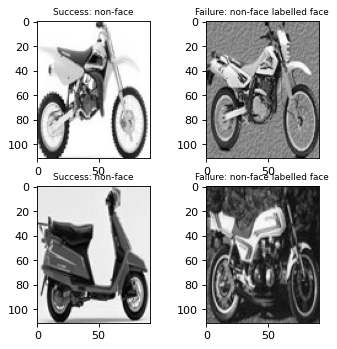

* k: 7, accuracy: 0.960, f1 score: 0.960


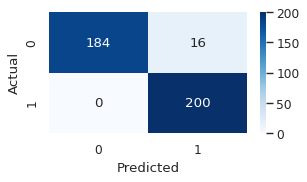

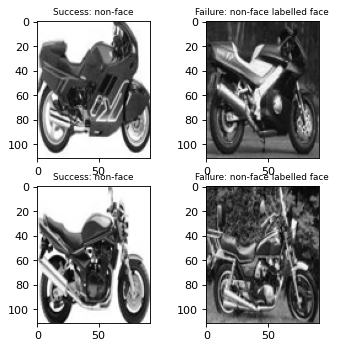

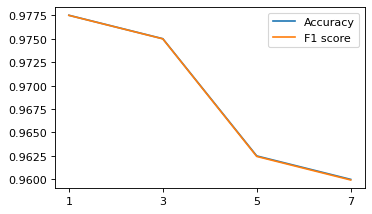

Accuracies vs Alpha


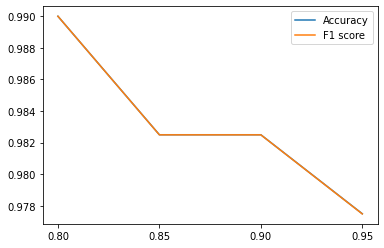

Non-faces: 350, faces: 200
[69, 105, 161, 255]
alpha: 0.800
* k: 1, accuracy: 0.995, f1 score: 0.995


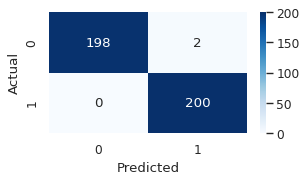

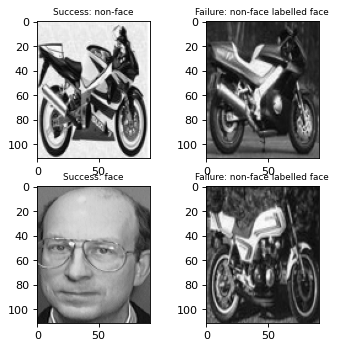

* k: 3, accuracy: 0.983, f1 score: 0.982


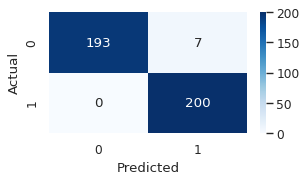

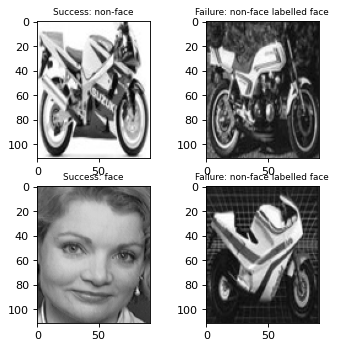

* k: 5, accuracy: 0.985, f1 score: 0.985


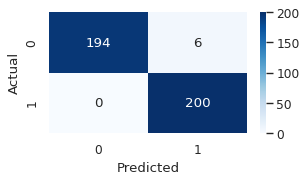

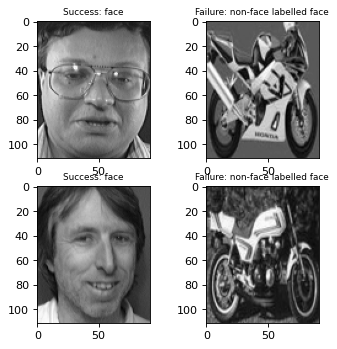

* k: 7, accuracy: 0.983, f1 score: 0.982


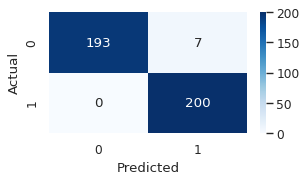

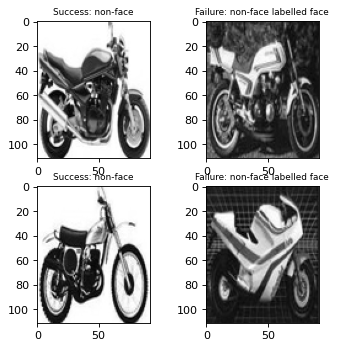

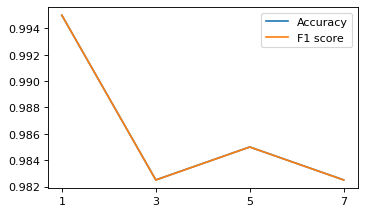

alpha: 0.850
* k: 1, accuracy: 0.983, f1 score: 0.982


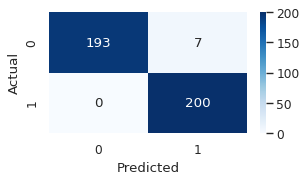

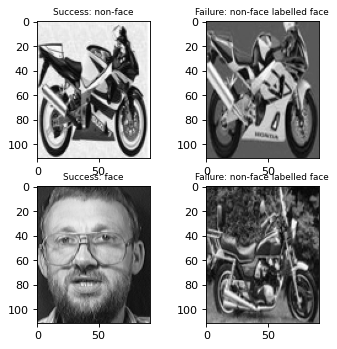

* k: 3, accuracy: 0.980, f1 score: 0.980


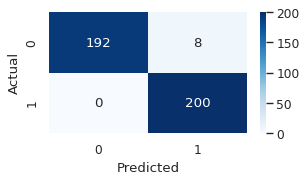

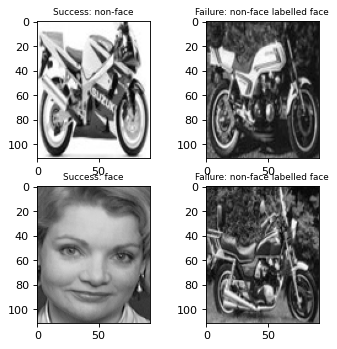

* k: 5, accuracy: 0.983, f1 score: 0.982


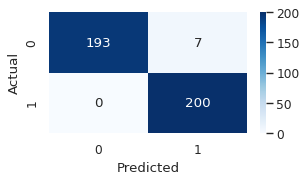

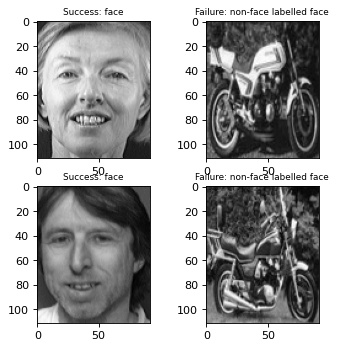

* k: 7, accuracy: 0.980, f1 score: 0.980


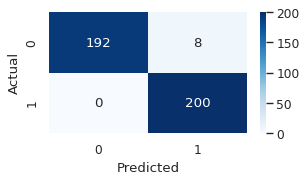

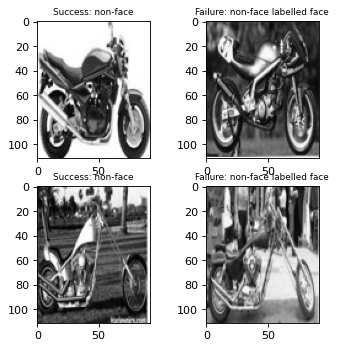

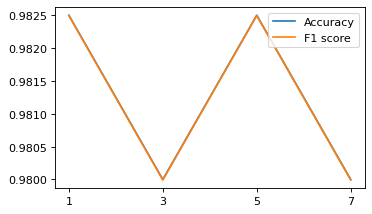

alpha: 0.900
* k: 1, accuracy: 0.983, f1 score: 0.982


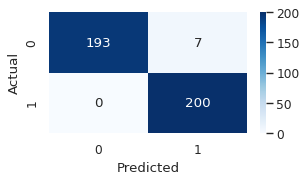

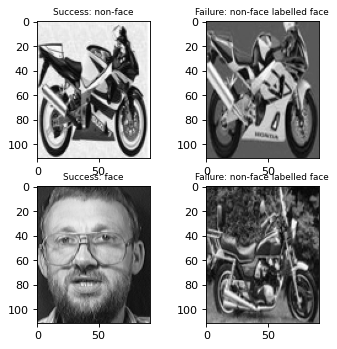

* k: 3, accuracy: 0.980, f1 score: 0.980


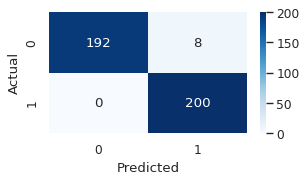

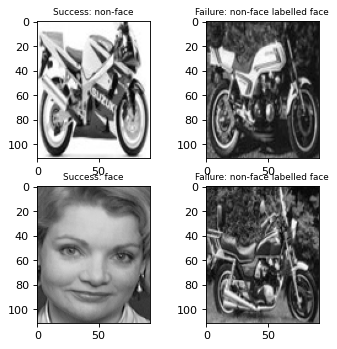

* k: 5, accuracy: 0.983, f1 score: 0.982


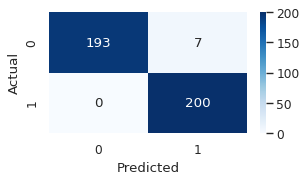

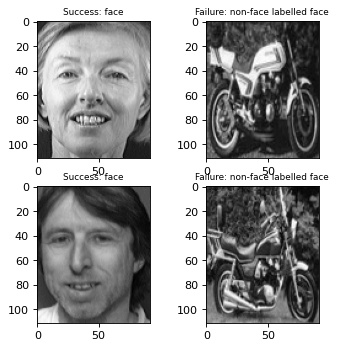

* k: 7, accuracy: 0.978, f1 score: 0.977


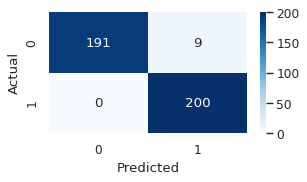

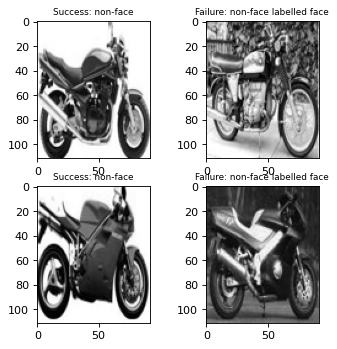

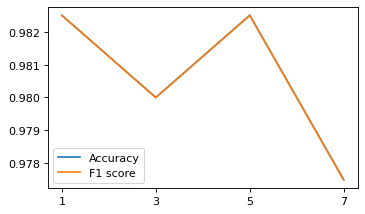

alpha: 0.950
* k: 1, accuracy: 0.983, f1 score: 0.982


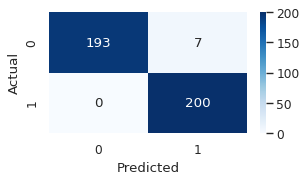

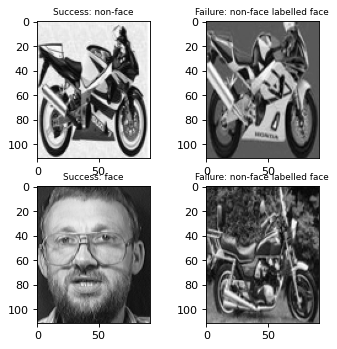

* k: 3, accuracy: 0.980, f1 score: 0.980


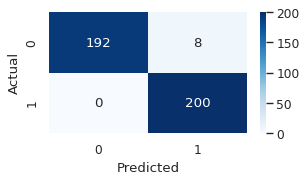

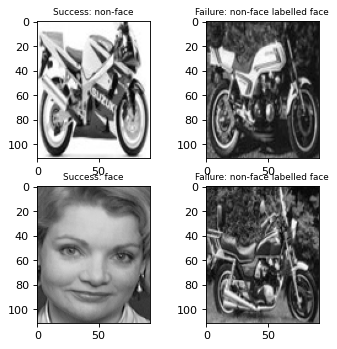

* k: 5, accuracy: 0.980, f1 score: 0.980


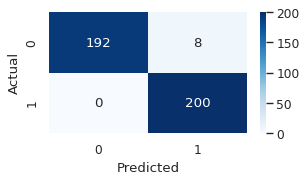

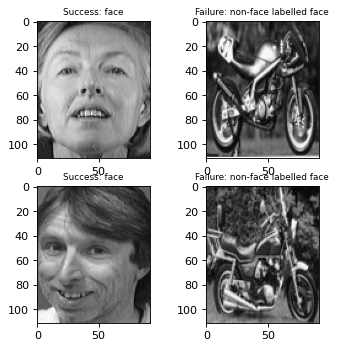

* k: 7, accuracy: 0.975, f1 score: 0.975


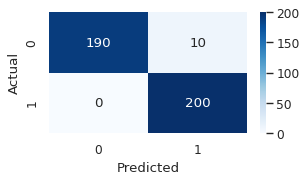

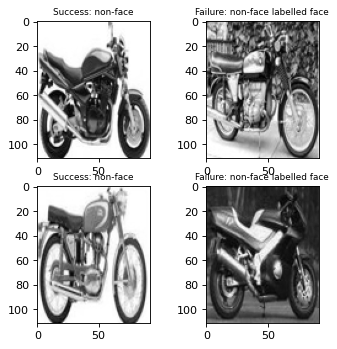

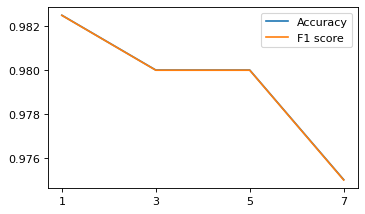

Accuracies vs Alpha


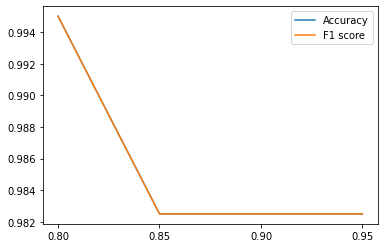

In [ ]:
acc_non_faces=[]
f1_non_faces=[]
for i in range(len(sizes)):
    s = sizes[i]
    print(f"Non-faces: {s}, faces: 200")
    test_mean = np.mean(testing_data_matrix_f_m, axis=0)
    test_z = testing_data_matrix_f_m - test_mean
    alphas = [0.8, 0.85, 0.9, 0.95]
    counts = []
    total = sum(eigenvalues_f_m_arr[i])
    descending_eigenvalues_f_m = np.flip(eigenvalues_f_m_arr[i])
    for alpha in alphas:
        count = 0
        sum_eigenvalues = 0
        for j in range(len(eigenvalues_f_m_arr[i])):
            sum_eigenvalues += descending_eigenvalues_f_m[j]
            count += 1
            if sum_eigenvalues / total >= alpha:
                break
        counts.append(count)
    print(counts)
    best_acc=[]
    best_f1=[]
    for j in range(len(alphas)):
        print(f"alpha: {alphas[j]:.3f}")
        projection_eigenvectors = eigenvectors_f_m_arr[i][:, IMG_LEN - counts[j] :]
        projected_training_data_matrix = data_z[i].dot(projection_eigenvectors)
        projected_testing_data_matrix = test_z.dot(projection_eigenvectors)
        acc,f1 =KNN(
            projected_training_data_matrix,
            training_label_vectors[i],
            projected_testing_data_matrix,
            testing_label_vector_f_m,
            log_file=f"PCA_{s}_non_faces_{alphas[j]:.3f}.txt",
            confusion_matrix=True,
            test_data_unprojected=testing_data_matrix_f_m,
            display_examples=2,
        )
        best_idx = np.argmax(acc)
        best_acc.append(acc[best_idx])
        best_f1.append(f1[best_idx])
    best_idx = np.argmax(best_acc)
    acc_non_faces.append(best_acc[best_idx])
    f1_non_faces.append(best_f1[best_idx])
    print("Accuracies vs Alpha")
    plt.figure()
    plt.plot(alphas, best_acc)
    plt.plot(alphas, best_f1)
    plt.xticks(alphas)
    plt.legend(['Accuracy', 'F1 score'])
    plt.show()

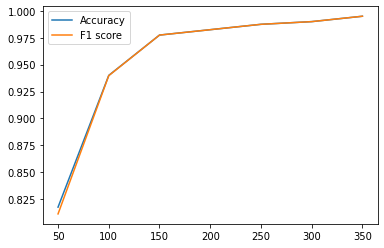

In [ ]:
plt.figure()
plt.plot(sizes, acc_non_faces)
plt.plot(sizes, f1_non_faces)
plt.xticks(sizes)
plt.legend(['Accuracy', 'F1 score'])
plt.show()

In [ ]:
print(acc_non_faces)
print(f1_non_faces)

[0.8175, 0.94, 0.9775, 0.9825, 0.9875, 0.99, 0.995]
[0.8112121858654823, 0.939783219590526, 0.9774886036055753, 0.9824946389831887, 0.9874980465697766, 0.98999899989999, 0.9949998749968749]


#### Comment
* 50 non-faces had very poor accuracy and F1-score. 
* 350 non-faces vs 200 faces had the overall best accuracies, at 0.995.
* Binary classification had overall better accuracies compared to Multi-class classification.
* General upward trend in accuracy as the number of non-faces samples increase, seems to be plateauing. 
* Higher alpha values and more K neighbours generally had an adverse effect on accuracy, likely due to adding noise.

## BONUS part 2: variations

### PCA VARIATION (KPCA)

In [ ]:
def kernel_pca(D,K,alpha):
    # D: data matrix with n samples and m features
    # K: kernel function
    # alpha: fraction of total variance to retain

    # Compute n x n kernel matrix
    n = D.shape[0] # number of samples
    K_train = np.zeros((n,n))
    for i in range(n):
        for j in range(n):
            K_train[i,j] = K(D[i],D[j])

    # Center the kernel matrix
    one_n = np.ones((n,n)) / n # matrix with all elements equal to 1/n
    K_train-= one_n.dot(K_train) + K_train.dot(one_n) - one_n.dot(K_train).dot(one_n)

    # Compute eigenvalues and eigenvectors of kernel matrix
    eigvals, eigvecs = np.linalg.eigh(K_train)
    eigvals = eigvals[::-1] # reverse order
    eigvecs = eigvecs[:,::-1] # reverse order

    # Compute variance for each component and normalize eigenvectors
    variances = eigvals / n 
    normalized_eigvecs = np.sqrt(1/abs(eigvals)) * eigvecs

    # Choose dimensionality based on fraction of total variance
    total_variance = np.sum(variances)
    cumulative_variance_ratio = np.cumsum(variances) / total_variance
    r = np.argmax(cumulative_variance_ratio >= alpha) + 1

    # Reduce basis to r components and project data onto them
    reduced_basis = normalized_eigvecs[:,:r]
    projected_data_train =np.dot( K_train, reduced_basis )
    
    
    return projected_data_train,reduced_basis, one_n


In [ ]:
def project_data(D_test,K,reduced_basis,one_n):
   # D_test: test data matrix with t samples and m features 
   # K: kernel function 
   # reduced_basis: r principal components from training data 
   # one_n: mean matrix from training data 

   # Compute t x n kernel matrix for test data 
   t = D_test.shape[0] 
   n = reduced_basis.shape[0]
   K_test = np.zeros((t,n))
   for i in range(t):
      for j in range(n):
         K_test[i,j] = K(D_test[i],D_test[j])

   # Center the kernel matrix using same mean as before 
   K_test -= one_n.dot(K_test) + K_test.dot(one_n) - one_n.dot(K_test).dot(one_n)

   # Project test data onto principal components 
   projected_data_test = np.dot(K_test , reduced_basis )

   return projected_data_test

alpha: 0.800
* k: 1, accuracy: 0.890, f1 score: 0.886
* k: 3, accuracy: 0.845, f1 score: 0.811
* k: 5, accuracy: 0.820, f1 score: 0.784
* k: 7, accuracy: 0.770, f1 score: 0.724


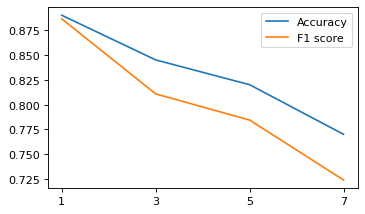

alpha: 0.850
* k: 1, accuracy: 0.880, f1 score: 0.867
* k: 3, accuracy: 0.835, f1 score: 0.813
* k: 5, accuracy: 0.830, f1 score: 0.804
* k: 7, accuracy: 0.800, f1 score: 0.773


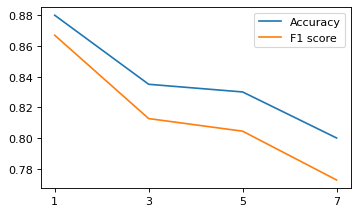

alpha: 0.900
* k: 1, accuracy: 0.945, f1 score: 0.938
* k: 3, accuracy: 0.920, f1 score: 0.917
* k: 5, accuracy: 0.875, f1 score: 0.860
* k: 7, accuracy: 0.825, f1 score: 0.813


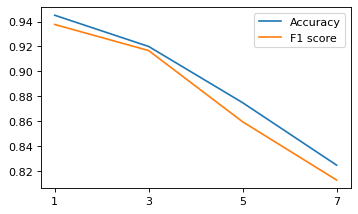

alpha: 0.950
* k: 1, accuracy: 0.975, f1 score: 0.974
* k: 3, accuracy: 0.935, f1 score: 0.934
* k: 5, accuracy: 0.885, f1 score: 0.881
* k: 7, accuracy: 0.840, f1 score: 0.831


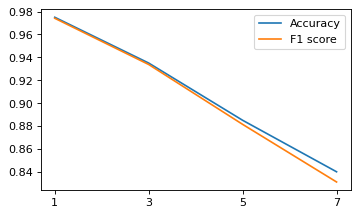

In [ ]:
# Define kernel function
def k(x,y):
    c = 1 # some constant
    return np.dot(x.T , y+ c)**2

alphas = [0.8, 0.85, 0.9, 0.95]
for alpha in alphas:
    print(f"alpha: {alpha:.3f}")
    # Call kernel_pca function on training data and get reduced basis and mean matrix
    projected_data_train,reduced_basis, one_n = kernel_pca(training_data_matrix,k,alpha)

    # Call project_data function on test data and get projected data
    projected_data_test = project_data(testing_data_matrix,k,reduced_basis,one_n)

    KNN(projected_data_train,training_label_vector,projected_data_test,testing_label_vector)


#### Comment

* Kernel Principal Component Analysis (KPCA) is a nonlinear extension of PCA, which is used for dimensionality reduction and feature extraction. It is especially useful when the data cannot be linearly separated.

* PCA works by finding the eigenvectors of the covariance matrix of the data, and projecting the data onto a lower-dimensional space spanned by the eigenvectors with the highest eigenvalues. However, PCA assumes that the data is linearly separable, which may not be the case for complex datasets.

* We used a polynomial kernel function to showcase similarity between the different data samples.

* While the computational complexity of kernel PCA does not grow with the dimensionality of the feature space that we are implicitely working in, Kernel PCA suffers from poor scalability in big data scenarios as it involves solving a $n$ x $n$ eigensystem leading to a computational complexity of O($n^3$) with $n$ being the number of samples. To address this issue, in this work, we consider a random feature approximation to kernel PCA which requires solving an m x m eigenvalue problem and therefore has a computational complexity of O($m^3+nm^2$) compared to PCA's complexity of O($d^3$) or O(d^2+n^3) where d is the number of features and n is the number of data points.

### LDA VARIATION (DLDA)

#### using sklearn

In [ ]:
dlda = LinearDiscriminantAnalysis(solver="eigen", shrinkage=1)
dlda.fit(training_data_matrix, training_label_vector)
projection_matrix_LDA = dlda.scalings_

In [ ]:
print(projection_matrix_LDA.shape)

(10304, 10304)


In [ ]:
U_Train_LDA = np.dot(training_data_matrix, projection_matrix_LDA)
U_Test_LDA = np.dot(testing_data_matrix, projection_matrix_LDA)

* k: 1, accuracy: 0.940, f1 score: 0.937
* k: 3, accuracy: 0.895, f1 score: 0.885
* k: 5, accuracy: 0.845, f1 score: 0.831
* k: 7, accuracy: 0.740, f1 score: 0.705


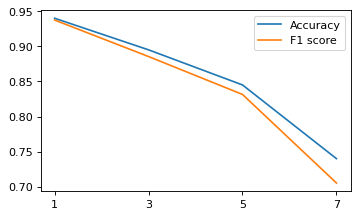

([0.94, 0.895, 0.845, 0.74],
 [0.937430624930625,
  0.8854631479631481,
  0.8314701270951269,
  0.705317599067599])

In [ ]:
KNN(U_Train_LDA, training_label_vector, U_Test_LDA, testing_label_vector)

#### implmentation by manually zeroing off diagonal values in within matrix.

In [ ]:
# calculate mean for all 40 classes
mean_vectors = []
for i in range(40):
    mean_vectors.append(np.mean(training_data_matrix[i * 5 : (i + 1) * 5], axis=0))
# get mean of all classes
overall_mean = np.mean(training_data_matrix, axis=0)

# calculate Sb
Sb = np.zeros((IMG_LEN, IMG_LEN))
for i in range(40):
    Sb += 5 * np.dot(
        (mean_vectors[i] - overall_mean).reshape(IMG_LEN, 1),
        (mean_vectors[i] - overall_mean).reshape(1, IMG_LEN),
    )

In [ ]:
within = np.zeros((IMG_LEN, IMG_LEN))
center = np.zeros((40, 5, IMG_LEN))

# computing centered matrix
for i in range(40):
    center[i] = training_data_matrix[i * 5 : (i + 1) * 5] - mean_vectors[i]
# computing within-class scatter matrix
for i in range(40):
    within += np.dot(center[i].T, center[i])
# S=Winv.B
# calculate the eigen vectors from S to get the weights
within = np.diag(np.diag(within))
inverse = np.linalg.inv(within)
s_inv_b = np.dot(inverse, Sb)

In [ ]:
eigenvalues_LDA, eigenvectors_LDA = np.linalg.eigh(s_inv_b)
projection_matrix_LDA = eigenvectors_LDA[:, len(eigenvectors_LDA) - 39 :]
# projecting train and test datasets
U_Train_LDA = np.dot(training_data_matrix, projection_matrix_LDA)
U_Test_LDA = np.dot(testing_data_matrix, projection_matrix_LDA)

* k: 1, accuracy: 0.960, f1 score: 0.959
* k: 3, accuracy: 0.895, f1 score: 0.881
* k: 5, accuracy: 0.870, f1 score: 0.851
* k: 7, accuracy: 0.860, f1 score: 0.844


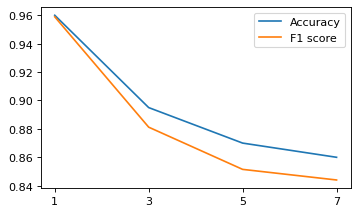

([0.96, 0.895, 0.87, 0.86],
 [0.958901515151515,
  0.8812130924630925,
  0.8514919802419801,
  0.8440225052725053])

In [ ]:
KNN(U_Train_LDA, training_label_vector, U_Test_LDA, testing_label_vector)

#### Comment

* The DLDA classifier is a modification to LDA, where the off-diagonal elements of the pooled sample covariance matrix are set to zero.
It is considered a Naive Bayes classifier, as it assumes the features are uncorrelated (assumption of independent features).

* In our case, resulted in very similiar accuracies to using LDA (0.94-0.96).

### LDA VARIATION (KLDA)

#### polynomial kernel function

In [ ]:
kernel_fun = "polynomial"
n = training_data_matrix.shape[0]
# calculate kernel matrix
kernel_matrix = pairwise_kernels(
    X=training_data_matrix, Y=training_data_matrix, metric=kernel_fun
)

In [ ]:
# calculate between scatter
overall_mean = np.mean(kernel_matrix, axis=1)
Sb = np.zeros((n, n))
for i in range(40):
    kernel_class_matrix = pairwise_kernels(
        X=training_data_matrix,
        Y=training_data_matrix[i * 5 : (i + 1) * 5],
        metric=kernel_fun,
    )
    class_mean = np.mean(kernel_class_matrix, axis=1)
    mean_diff = class_mean - overall_mean
    Sb += 5 * np.dot(mean_diff, mean_diff.T)

In [ ]:
# calculate within scatter
within = np.zeros((n, n))
for i in range(40):
    kernel_class_matrix = pairwise_kernels(
        X=training_data_matrix,
        Y=training_data_matrix[i * 5 : (i + 1) * 5],
        metric=kernel_fun,
    )
    h_class = np.eye(5) - (1 / 5) * np.ones((5, 5))
    within += kernel_class_matrix.dot(h_class).dot(kernel_class_matrix.T)

In [ ]:
epsilon = 0.00001  #--> to prevent singularity of within matrix
inverse = np.linalg.inv(within + epsilon*np.eye(within.shape[0]))
s_inv_b = np.dot(inverse, Sb)

In [ ]:
eigenvalues_LDA, eigenvectors_LDA = np.linalg.eigh(s_inv_b)
projection_matrix_LDA = eigenvectors_LDA[:, len(eigenvectors_LDA) - 39 :]

# projecting train and test datasets
train_kernel_matrix = pairwise_kernels(
    X=training_data_matrix, Y=training_data_matrix, metric=kernel_fun
)
test_kernel_matrix = pairwise_kernels(
    X=testing_data_matrix, Y=testing_data_matrix, metric=kernel_fun
)

U_Train_KLDA = np.dot(train_kernel_matrix, projection_matrix_LDA)
U_Test_KLDA = np.dot(test_kernel_matrix, projection_matrix_LDA)

* k: 1, accuracy: 0.510, f1 score: 0.489
* k: 3, accuracy: 0.375, f1 score: 0.343
* k: 5, accuracy: 0.375, f1 score: 0.331
* k: 7, accuracy: 0.375, f1 score: 0.354


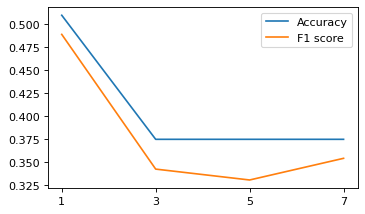

([0.51, 0.375, 0.375, 0.375],
 [0.48917833664157195,
  0.34258827721985613,
  0.33074592074592074,
  0.35432173090067826])

In [ ]:
KNN(U_Train_KLDA, training_label_vector, U_Test_KLDA, testing_label_vector)

#### laplacian kernel function

In [ ]:
kernel_fun = "laplacian"
n = training_data_matrix.shape[0]
# calculate kernel matrix
kernel_matrix = pairwise_kernels(
    X=training_data_matrix, Y=training_data_matrix, metric=kernel_fun
)

In [ ]:
# calculate between scatter
overall_mean = np.mean(kernel_matrix, axis=1)
Sb = np.zeros((n, n))
for i in range(40):
    kernel_class_matrix = pairwise_kernels(
        X=training_data_matrix,
        Y=training_data_matrix[i * 5 : (i + 1) * 5],
        metric=kernel_fun,
    )
    class_mean = np.mean(kernel_class_matrix, axis=1)
    mean_diff = class_mean - overall_mean
    Sb += 5 * np.dot(mean_diff, mean_diff.T)

In [ ]:
# calculate within scatter
within = np.zeros((n, n))
for i in range(40):
    kernel_class_matrix = pairwise_kernels(
        X=training_data_matrix,
        Y=training_data_matrix[i * 5 : (i + 1) * 5],
        metric=kernel_fun,
    )
    h_class = np.eye(5) - (1 / 5) * np.ones((5, 5))
    within += kernel_class_matrix.dot(h_class).dot(kernel_class_matrix.T)

In [ ]:
epsilon = 0.00001  #--> to prevent singularity of within matrix
inverse = np.linalg.inv(within + epsilon*np.eye(within.shape[0]))
s_inv_b = np.dot(inverse, Sb)

In [ ]:
eigenvalues_LDA, eigenvectors_LDA = np.linalg.eigh(s_inv_b)
projection_matrix_LDA = eigenvectors_LDA[:, len(eigenvectors_LDA) - 39 :]

# projecting train and test datasets
train_kernel_matrix = pairwise_kernels(
    X=training_data_matrix, Y=training_data_matrix, metric=kernel_fun
)
test_kernel_matrix = pairwise_kernels(
    X=testing_data_matrix, Y=testing_data_matrix, metric=kernel_fun
)

U_Train_KLDA = np.dot(train_kernel_matrix, projection_matrix_LDA)
U_Test_KLDA = np.dot(test_kernel_matrix, projection_matrix_LDA)

* k: 1, accuracy: 1.000, f1 score: 1.000
* k: 3, accuracy: 0.925, f1 score: 0.923
* k: 5, accuracy: 0.685, f1 score: 0.654
* k: 7, accuracy: 0.500, f1 score: 0.449


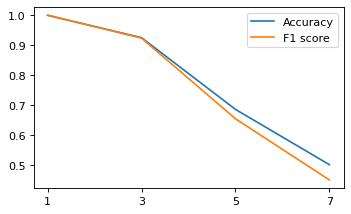

([1.0, 0.925, 0.685, 0.5],
 [1.0, 0.9234848484848485, 0.6536533238003827, 0.44890553588923154])

In [ ]:
KNN(U_Train_KLDA, training_label_vector, U_Test_KLDA, testing_label_vector)

#### Comments

* The main idea of constructing nonlinear algorithms is to apply the linear methods
not in the space of observations but in a feature space F that is related to the former
by a nonlinear mapping $¢ : R^N→  F, X→ ¢(x)$. 

* By defining a non-linear mapping from the input space to a high-dimensional feature space (right), we (expect to) obtain a linearly separable distribution in the feature space. Then LDA, the linear technique, can be performed in the feature space to extract the most significant discriminating features. However, the computation may be problematic or even impossible in the feature space owing to the high dimensionality. By introducing a kernel function which corresponds to the non-linear mapping, all the computation can conveniently be carried out in the input space. The problem can be finally solved as an eigen-decomposition problem like PCA, LDA and KPCA.

* Used laplacian kernel function. The choice of the kernel function had significant effect on the classification performance, for example polynomial kernel function resulted in 0.51 accuracy.

* We got the highest accuracy (1.0) as well as f1-score (1.0) across all multiclass attempts.